### ............ Loading Embeds (below is useful code)

In [2]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

plt.style.use(['seaborn-v0_8-colorblind', 'seaborn-v0_8-darkgrid'])
plt.rcParams.update({'font.size': 20})

np.set_printoptions(suppress=True, precision=4)

# Automatically reload your external source code
%load_ext autoreload
%autoreload 2

In [6]:
from amazon_reviews import get_dataset_word2vec
from cbow import CBOW
from amazon_reviews import get_most_similar_words
from sklearn.manifold import TSNE
from amazon_reviews import find_unique_word_counts
from amazon_reviews import make_word2ind_mapping, make_ind2word_mapping

In [7]:
targets_int, contexts_int, vocab, corpus = get_dataset_word2vec(N_reviews=40000, corpus_return=True)
word2ind = make_word2ind_mapping(vocab)
ind2word = make_ind2word_mapping(vocab)
print(f'Number of target words in actual Amazon corpus: {len(targets_int)}. There should be 5434338.')
print(f'Number of context words in actual Amazon corpus: {len(contexts_int)}. There should be 5434338.')
print(f'Vocab size in actual Amazon corpus: {len(vocab)}. It should be 21905.')

Number of target words in actual Amazon corpus: 5434338. There should be 5434338.
Number of context words in actual Amazon corpus: 5434338. There should be 5434338.
Vocab size in actual Amazon corpus: 21905. It should be 21905.


In [8]:
# LOAD IN SAVED EMBEDDINGS
embeddings = np.load('export/embeddings.npz')
embeddings = embeddings['embeddings']

tsne = TSNE(n_components=2)
word_tsne = tsne.fit_transform(embeddings)
print(embeddings.shape)
print(word_tsne.shape)

(21905, 96)
(21905, 2)


### ............ Loading Embeds (finished)

Words most similar to great:
0: great (similarity=1.0000)
1: good (similarity=0.7921)
2: fantastic (similarity=0.7891)
3: perfect (similarity=0.7261)
4: wonderful (similarity=0.7197)
5: amazing (similarity=0.7195)
6: nice (similarity=0.7052)
7: awesome (similarity=0.6948)
8: terrific (similarity=0.6939)
9: excellent (similarity=0.6930)
10: fabulous (similarity=0.6444)
11: decent (similarity=0.6403)
12: excelent (similarity=0.6017)
13: lovely (similarity=0.5726)
14: fine (similarity=0.5700)
15: slouchier (similarity=0.5642)
16: tradeshows (similarity=0.5616)
17: finr (similarity=0.5593)
18: outstanding (similarity=0.5572)
19: ok (similarity=0.5527)
20: cool (similarity=0.5500)
21: awsome (similarity=0.5467)
22: securer (similarity=0.5463)
23: perfectly (similarity=0.5397)
24: vbs (similarity=0.5369)
25: wonderfully (similarity=0.5337)


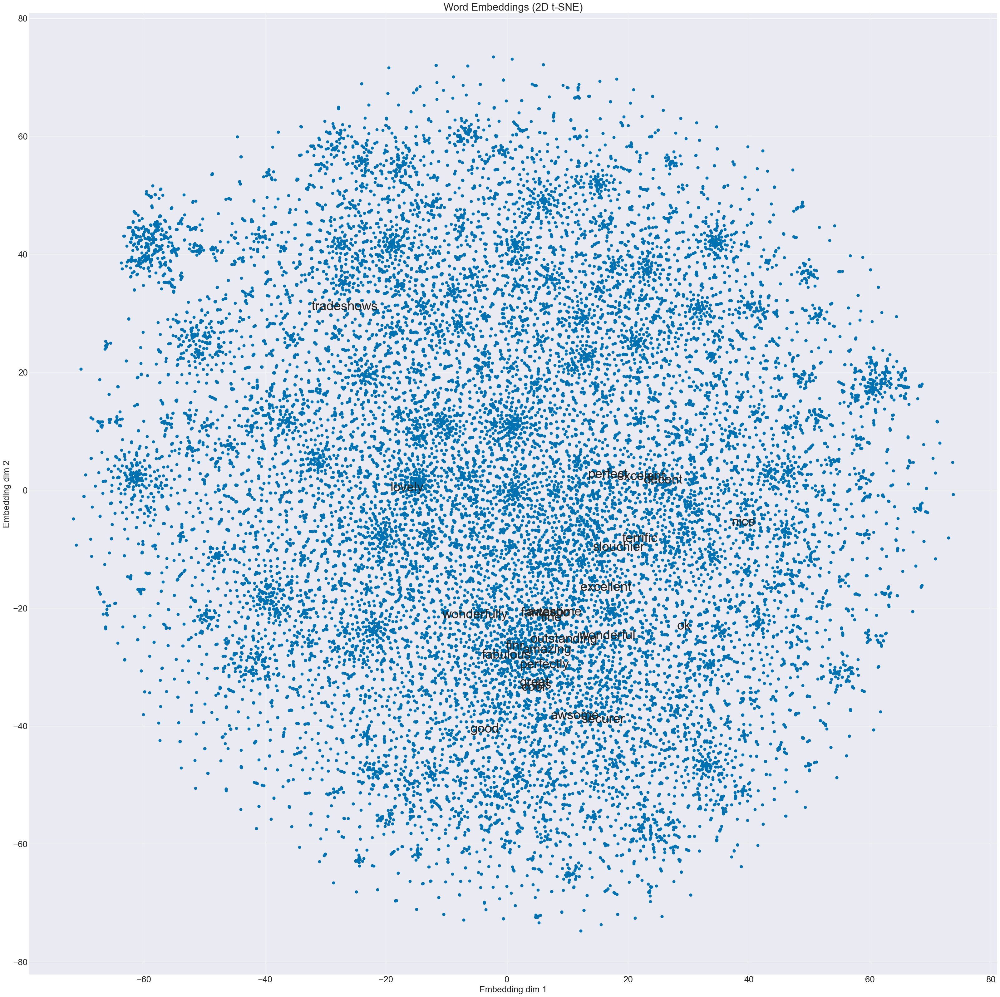

In [9]:
query_word = 'great'
topk_word_inds, topk_cossim = get_most_similar_words(k=25,
                                                     all_embeddings=embeddings,
                                                     word_str=query_word,
                                                     word_str2int=word2ind)


word_strs = [ind2word[ind] for ind in topk_word_inds]

print(f'Words most similar to {query_word}:')
for k0 in range(len(topk_word_inds)):
    print(f'{k0}: {ind2word[topk_word_inds[k0]]} (similarity={topk_cossim[k0]:.4f})')

# Visualize word cloud — each word as (x, y) coords
plt.figure(figsize=(40, 40))
plt.scatter(word_tsne[:, 0], word_tsne[:, 1])

max_xy = 5
rng = np.random.default_rng(0)
offsets = rng.uniform(low=-max_xy, high=max_xy, size=(len(word_strs), 2))
for w in range(len(word_strs)):
    plt.annotate(word_strs[w], (word_tsne[w, 0]+offsets[w,0], word_tsne[w, 1]+offsets[w,0]), fontsize=30)

plt.title('Word Embeddings (2D t-SNE)')
plt.xlabel('Embedding dim 1')
plt.ylabel('Embedding dim 2')
plt.show()

In [21]:
from sklearn.cluster import KMeans
from collections import defaultdict

In [40]:
k = 10

#fit K-means
kmeans = KMeans(n_clusters=k, random_state=0, n_init=10)
labels = kmeans.fit_predict(word_tsne)

clusters = defaultdict(list)
for idx, cluster_id in enumerate(labels):
    clusters[cluster_id].append(idx)


for cluster_id in range(k):
    word_list = [ ind2word[i] for i in clusters[cluster_id] ]
    print(f"\nCluster {cluster_id} — {len(word_list)} words:")
    # print first 20
    print(", ".join(word_list[:20]))



Cluster 0 — 2264 words:
tieks, kid, year, olds, son, fan, easter, daughter, law, replacement, rate, grand, pilates, tiles, husband, cash, who, grandchildren, mavi, sister

Cluster 1 — 2033 words:
i, think, really, you, could, photo, need, me, expected, bought, dont, love, always, have, order, appreciate, ill, buy, again, hopefully

Cluster 2 — 2384 words:
pretty, very, crappy, stylish, sturdy, too, heavy, cute, warm, nice, inexpensive, rough, uncomfortable, way, made, flattering, chiffon, knit, weigh, lbs

Cluster 3 — 1538 words:
regular, pair, five, stars, shirt, t, br, xxl, bra, dress, xl, tshirt, she, shes, two, he, item, scarf, styled, hat

Cluster 4 — 2552 words:
medication, rectangular, friendly, ninjago, bit, little, few, collector, handily, tablecloth, 0x, reposition, pleasant, turtle, forest, baseball, lot, peacock, 'hidden', consideration

Cluster 5 — 2076 words:
depression, store, first, socks, these, glasses, sunglasses, size, compliments, package, chart, cutest, name, jea

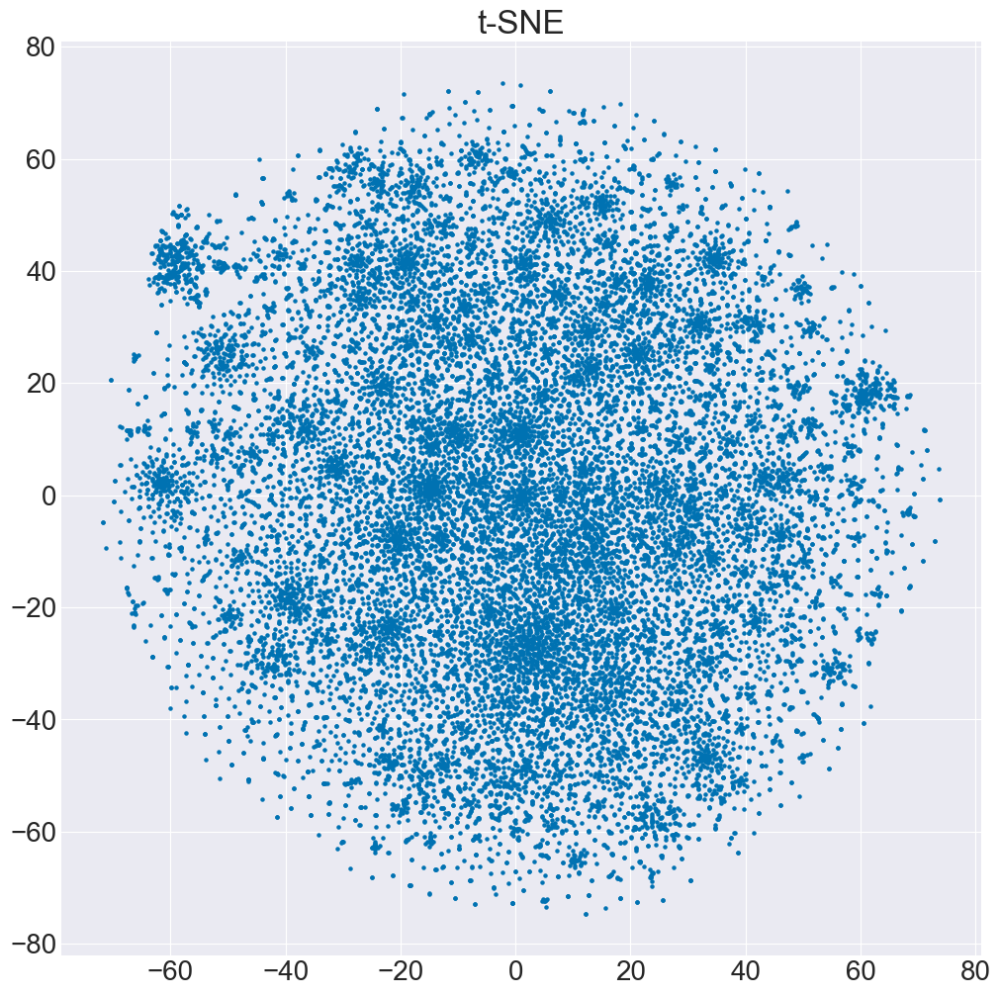

In [ ]:
plt.figure(figsize=(12,12))
plt.scatter(word_tsne[:,0], word_tsne[:,1], s=5)
plt.title('t-SNE')
plt.show()

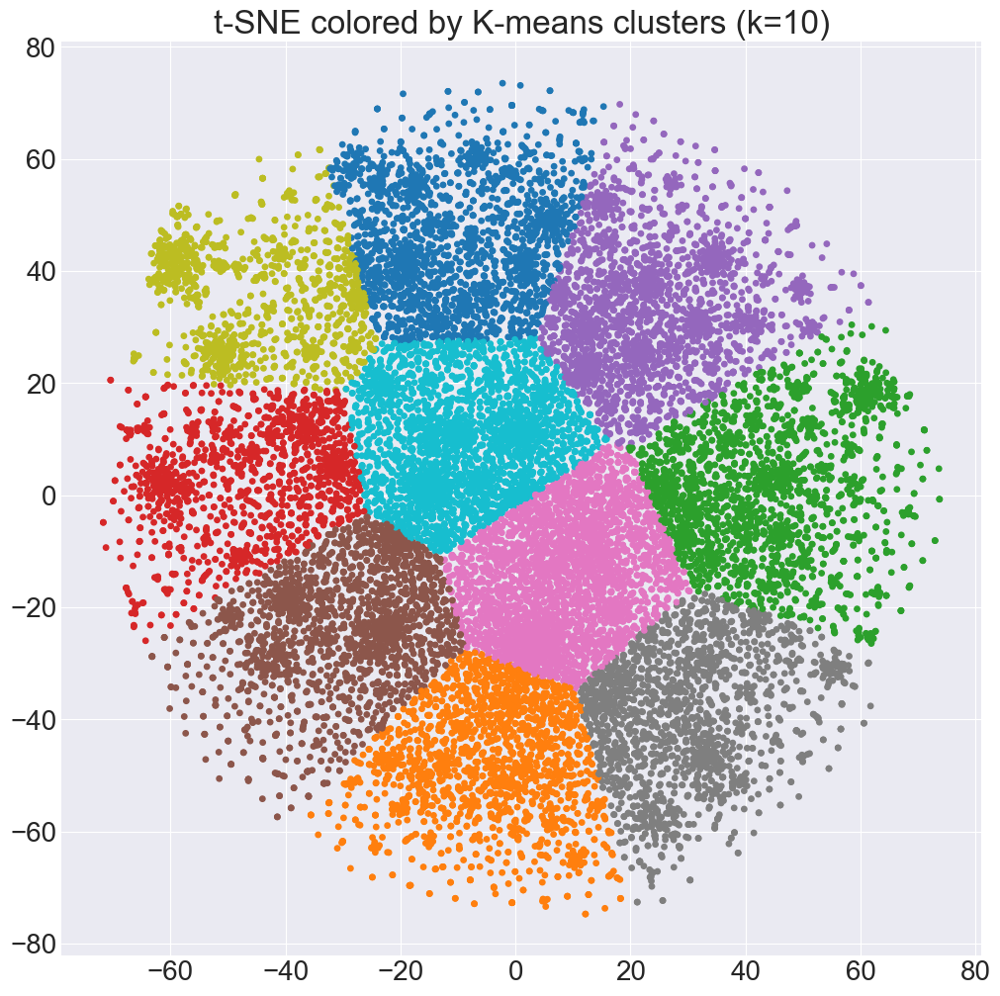

In [42]:

plt.figure(figsize=(12, 12))
plt.scatter(word_tsne[:,0], word_tsne[:,1], c=labels, cmap='tab10', s=15)
plt.title(f't-SNE colored by K-means clusters (k={k})')
plt.show()


# k = 100

In [43]:
k = 100

kmeans = KMeans(n_clusters=k, random_state=0, n_init=10)
labels = kmeans.fit_predict(word_tsne)

clusters = defaultdict(list)
for idx, cluster_id in enumerate(labels):
    clusters[cluster_id].append(idx)

for cluster_id in range(k):
    word_list = [ ind2word[i] for i in clusters[cluster_id] ]
    print(f"\nCluster {cluster_id} — {len(word_list)} words:")
    # print first 20
    print(", ".join(word_list[:20]))



Cluster 0 — 178 words:
again, recommend, highly, hesitate, gone, eyeballing, consider, gravitate, classify, readjusting, sight, recomend, suggest, inherited, categorize, lived, beatifully, torrential, downpours, continously

Cluster 1 — 165 words:
samsung, church, beach, essential, unbiased, galaxy, smart, schitts, creek, lunch, selects, disney, honest, apple, 40mm, electric, archs, x4, gravity, notorious

Cluster 2 — 218 words:
proof, gum, theses, loader, soap, shampoo, moths, marginal, unattractive, disheveled, childish, speeds, bottle, tooth, plasticky, conscience, tuxedo, sacrificing, upscale, glean

Cluster 3 — 325 words:
inside, front, lock, closes, top, pocket, inserts, filters, filter, edges, sleeves, pleated, area, bottom, sides, bands, screws, insert, tab, band

Cluster 4 — 212 words:
socks, jeans, yoga, classes, gloves, bike, pants, shorts, capri, leggings, heels, clothing, shirts, bras, capris, ons, dresses, swimsuits, clothes, tanks

Cluster 5 — 229 words:
friendly, repla

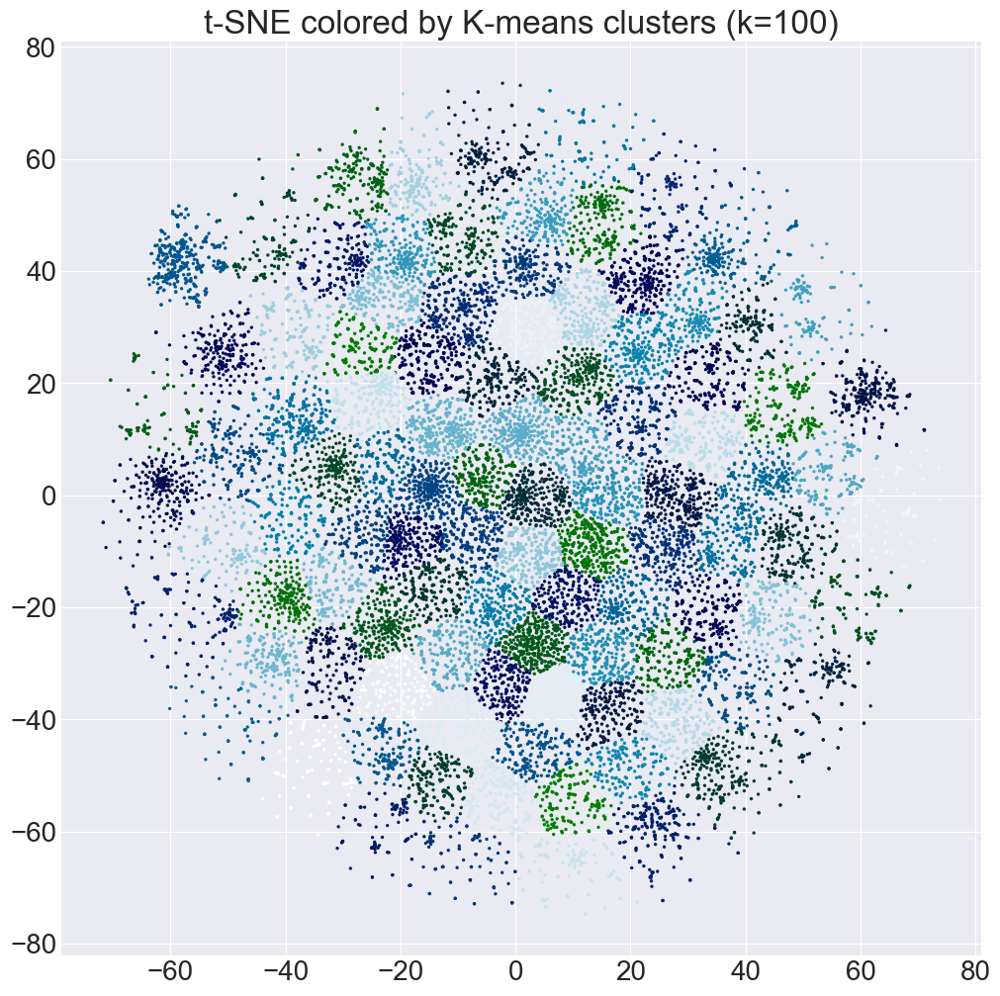

In [44]:
plt.figure(figsize=(12, 12))
plt.scatter(word_tsne[:,0], word_tsne[:,1], c=labels, cmap='ocean', s=2)
plt.title(f't-SNE colored by K-means clusters (k={k})')
plt.show()

In [45]:
k = 1000

kmeans = KMeans(n_clusters=k, random_state=0, n_init=10)
labels = kmeans.fit_predict(word_tsne)

clusters = defaultdict(list)
for idx, cluster_id in enumerate(labels):
    clusters[cluster_id].append(idx)

for cluster_id in range(k):
    word_list = [ ind2word[i] for i in clusters[cluster_id] ]
    print(f"\nCluster {cluster_id} — {len(word_list)} words:")
    # print first 20
    print(", ".join(word_list[:20]))



Cluster 0 — 18 words:
graduated, jagged, feat, raw', deceptively, calendar, shapeable, cycled, 'gold', weathered, 4oz, movado, fiery, 'screw, down', daytona, websits, 1yr

Cluster 1 — 33 words:
really, me, what, attention, absolutely, him, how, honestly, kinda, why, truly, cow, called, totally, everything, crazy, completely, saying, darn, wow

Cluster 2 — 20 words:
aviator, b08f7qq11t, sonja, rofarso, betro, boston, theater, danne, panvbo, crndzsis, outweighed, vesta, jolin, ourin, b004r05p3q, cocoship, b01beay0nc, jj, quib, gtr

Cluster 3 — 32 words:
arthritis, longsleeve, mommy, irritated, settings, monroe, rounding, camouflages, noses, tum, itches, blind, bypass, c5, c6, osteoarthritis, dew, frome, cranny, inflamed

Cluster 4 — 31 words:
investigating, eddie, bauer, counterfeit, thirds, pollen, schnauzer, standardized, overbearingly, strudy, witty, scrawny, viruses, goog, quiality, lou, exhaled, vhina, moss, agate

Cluster 5 — 21 words:
sleeves, ends, center, slit, trim, edge, slee

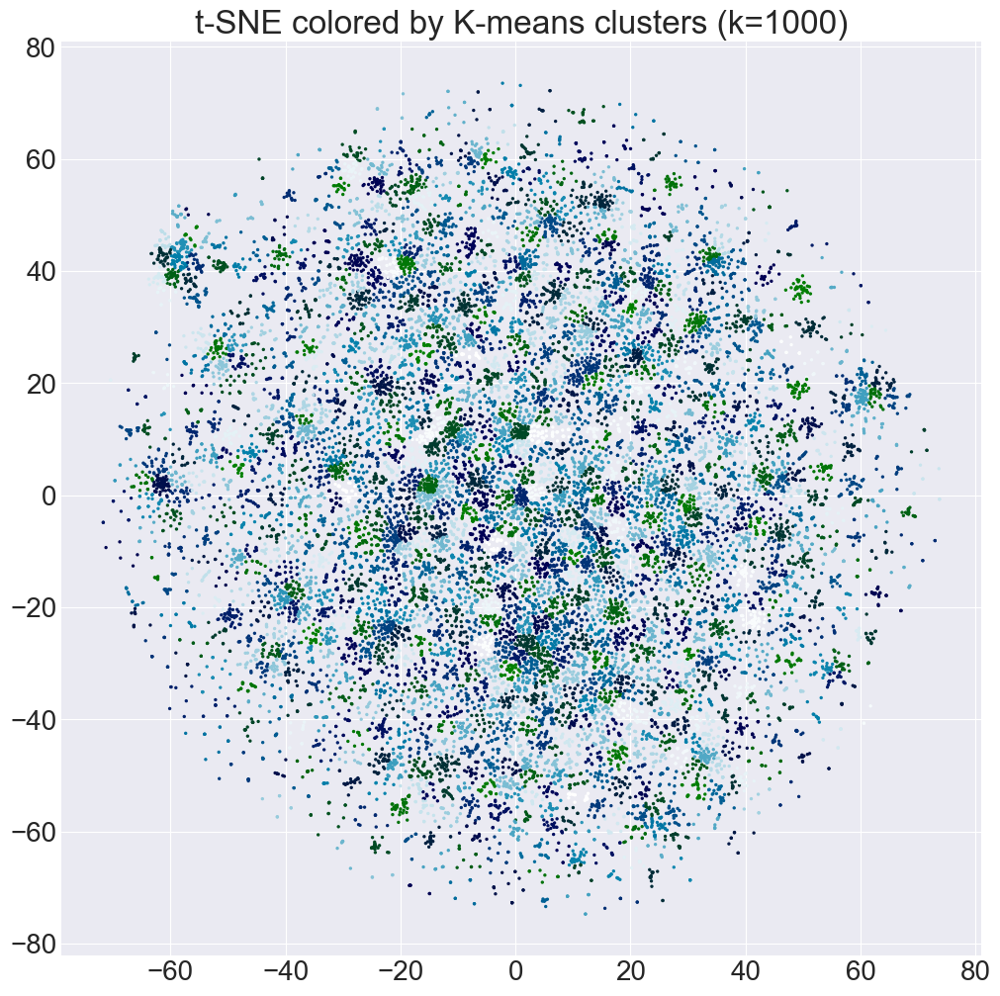

In [46]:
plt.figure(figsize=(12, 12))
plt.scatter(word_tsne[:,0], word_tsne[:,1], c=labels, cmap='ocean', s=2)
plt.title(f't-SNE colored by K-means clusters (k={k})')
plt.show()

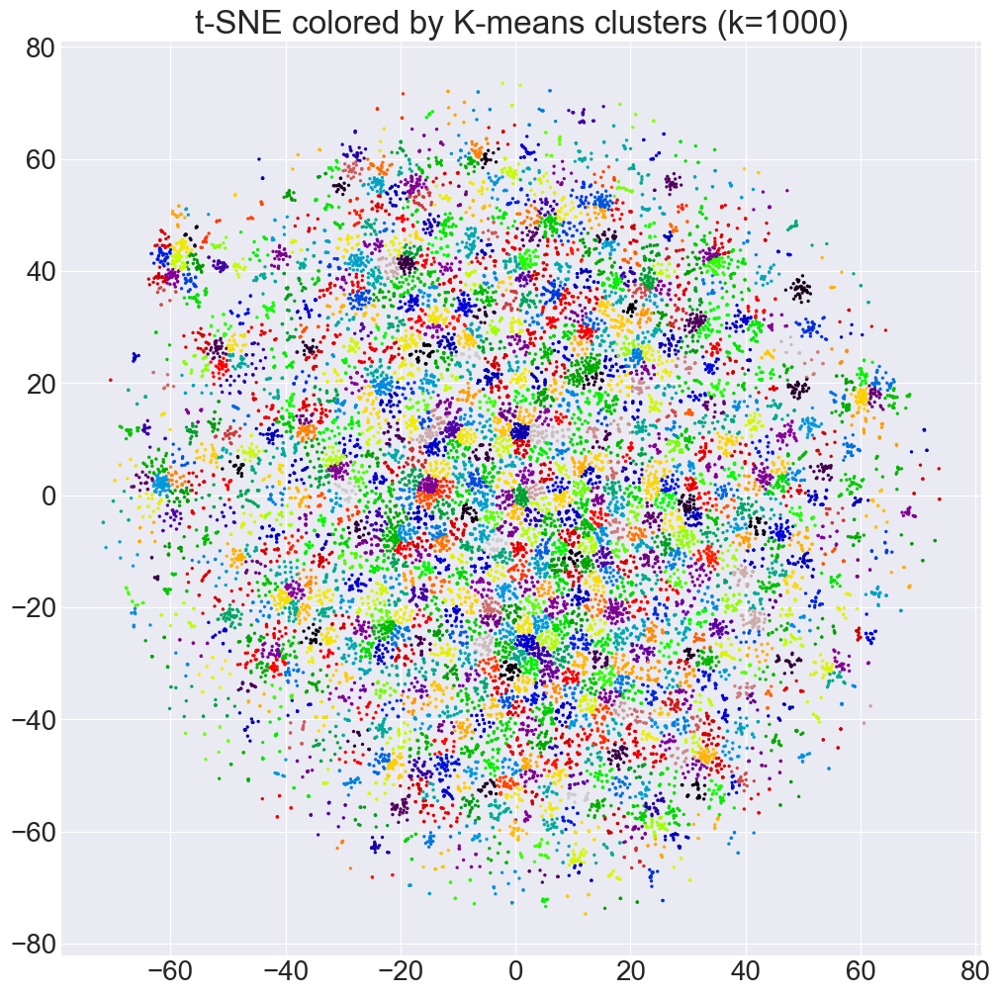

In [47]:
# Normalize labels to [0,1]
normed = labels / float(k)

# Try the ‘nipy_spectral’ or ‘gist_ncar’ colormaps:
plt.figure(figsize=(12,12))
plt.scatter(
    word_tsne[:,0], word_tsne[:,1],
    c=normed,              # continuous
    cmap='nipy_spectral',  # also try 'gist_ncar' or 'turbo'
    s=2
)
plt.title(f't-SNE colored by K-means clusters (k={1000})')
plt.show()


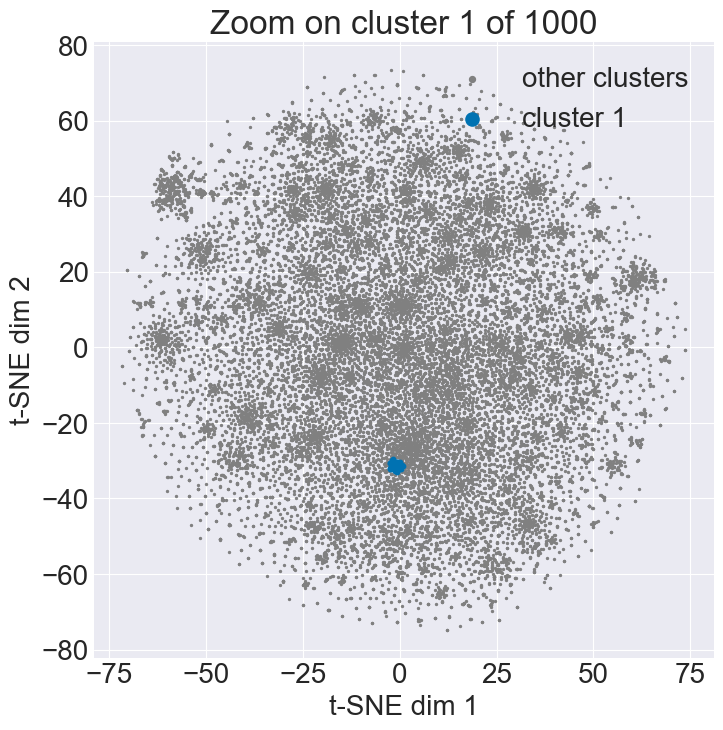

Cluster 1 (33 words):
really, me, what, attention, absolutely, him, how, honestly, kinda, why, truly, cow, called, totally, everything, crazy, completely, saying, darn, wow, badly, necessarily, whats, purposely, essentially, greatly, offering, peace, tucking, genuinely, thatll, dang, boosting …


In [54]:
# --- assume you already have ---
# word_tsne: np.ndarray of shape [vocab_size, 2]
# labels:   length‑vocab_size int array of cluster IDs 0…k-1
# ind2word: mapping from index -> word string

# choose which cluster to zoom into
cluster_search = 1

# mask for points in that cluster
mask = (labels == cluster_search)
pts_all = word_tsne
pts_cluster = word_tsne[mask]

# compute bounding box of the cluster
min_x, min_y = pts_cluster.min(axis=0)
max_x, max_y = pts_cluster.max(axis=0)

# add a little padding (5% of width/height)
pad_x = (max_x - min_x)
pad_y = (max_y - min_y)

xlim = (min_x - pad_x, max_x + pad_x)
ylim = (min_y - pad_y, max_y + pad_y)

# plot
plt.figure(figsize=(8, 8))

# 1) all points in light gray
plt.scatter(pts_all[:, 0], pts_all[:, 1],
            c='gray', s=2, label='other clusters')

# 2) this cluster in blue
plt.scatter(pts_cluster[:, 0], pts_cluster[:, 1],
            c='C0', s=10, label=f'cluster {cluster_search}')

# # set limits to zoom
# plt.xlim(*xlim)
# plt.ylim(*ylim)

plt.title(f'Zoom on cluster {cluster_search} of {k}')
plt.xlabel('t-SNE dim 1')
plt.ylabel('t-SNE dim 2')
plt.legend(markerscale=3)
plt.show()

# optional: print out the words in this cluster
words_in_cluster = [ind2word[i] for i in np.where(mask)[0]]
print(f"Cluster {cluster_search} ({len(words_in_cluster)} words):")
print(", ".join(words_in_cluster[:50]), "…")


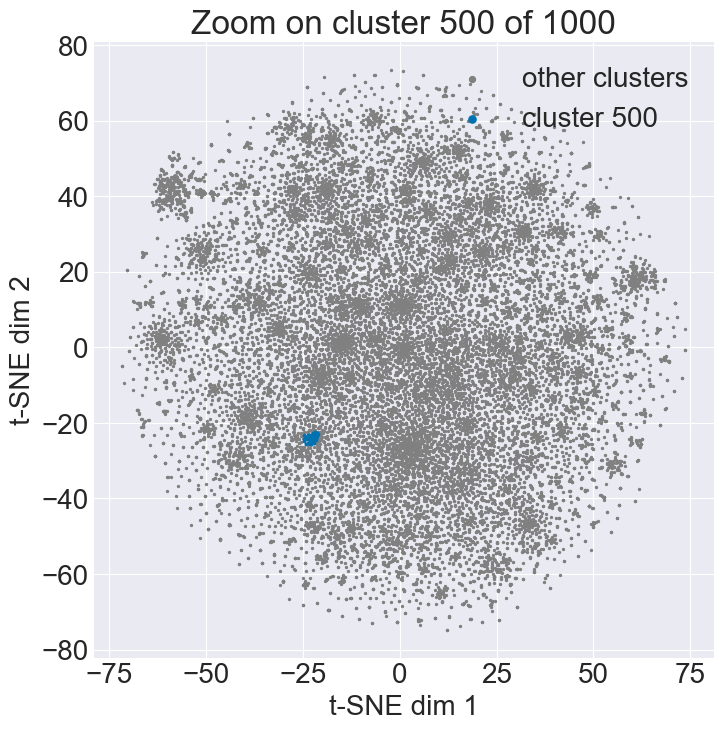

Cluster 500 (50 words):
differ, guessed, shore, unit, entering, '90s, cops, stems, aside, boukit, tens, energies, timeson, hubble, booth, drinking, balconette, suffering, curtains, gradually, enso, talanes, mods, furnished, ranging, freebies, speedos, breads, pigmentation, tangling, benefited, casino, infiltrating, stealing, reflectivity, aristocats, cpap, nicks, gpaa, leon, powering, dirndl, disconnecting, seperated, hardness, iso, viv, keloids, cabana, rooftops …


In [56]:
cluster_search = 500

# mask for points in that cluster
mask = (labels == cluster_search)
pts_all = word_tsne
pts_cluster = word_tsne[mask]

# compute bounding box of the cluster
min_x, min_y = pts_cluster.min(axis=0)
max_x, max_y = pts_cluster.max(axis=0)

# add a little padding (5% of width/height)
pad_x = (max_x - min_x) 
pad_y = (max_y - min_y)

xlim = (min_x - pad_x, max_x + pad_x)
ylim = (min_y - pad_y, max_y + pad_y)

# plot
plt.figure(figsize=(8, 8))

# 1) all points in light gray
plt.scatter(pts_all[:, 0], pts_all[:, 1],
            c='gray', s=2, label='other clusters')

# 2) this cluster in blue
plt.scatter(pts_cluster[:, 0], pts_cluster[:, 1],
            c='C0', s=3, label=f'cluster {cluster_search}')

# set limits to zoom
# plt.xlim(*xlim)
# plt.ylim(*ylim)

plt.title(f'Zoom on cluster {cluster_search} of {k}')
plt.xlabel('t-SNE dim 1')
plt.ylabel('t-SNE dim 2')
plt.legend(markerscale=3)
plt.show()

# optional: print out the words in this cluster
words_in_cluster = [ind2word[i] for i in np.where(mask)[0]]
print(f"Cluster {cluster_search} ({len(words_in_cluster)} words):")
print(", ".join(words_in_cluster[:50]), "…")


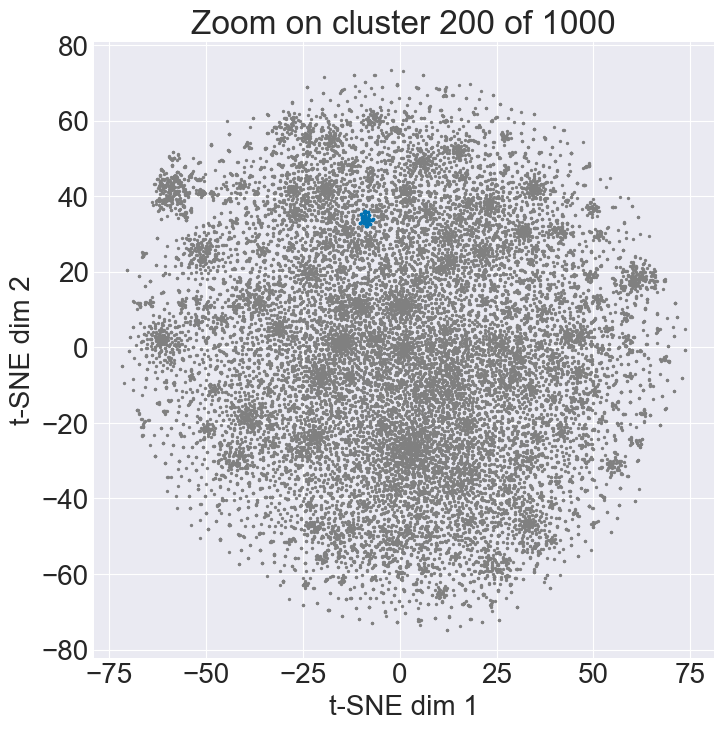

Cluster 200 (43 words):
tieks, interfere, flatted, partners, victorian, startle, doc, gdaughter, tendonitis, firsthand, boobies, fov, ass, cellphone, skates, centuries, belle, bounced, yoyo, interferes, chap, fidgeted, 38inches, faired, newborn, implants, cursed, cheongsam, complection, fibro, prayers, stoggles, dslr, dansko, polishes, gotcha, misjudged, frankenmuth, pools, difficulties, saree, supergirl, hemitite …


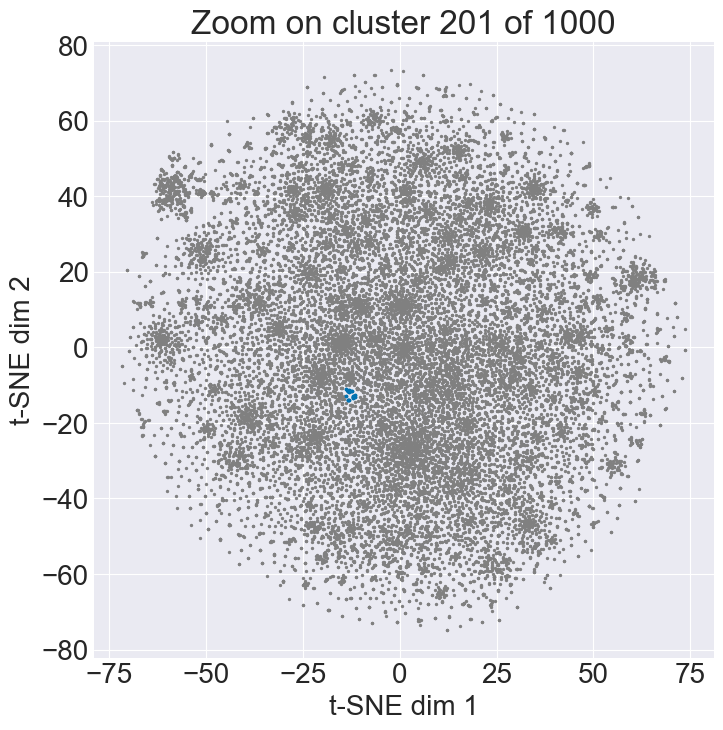

Cluster 201 (23 words):
bendy, dissipating, absorbing, observation, sweep, embellishment, pointing, indulgence, waring, perks, filtering, tanning, competently, illuminator, shortcomings, 8m, sags, owens, gasket, gaurd, 1cm, copied, internals …


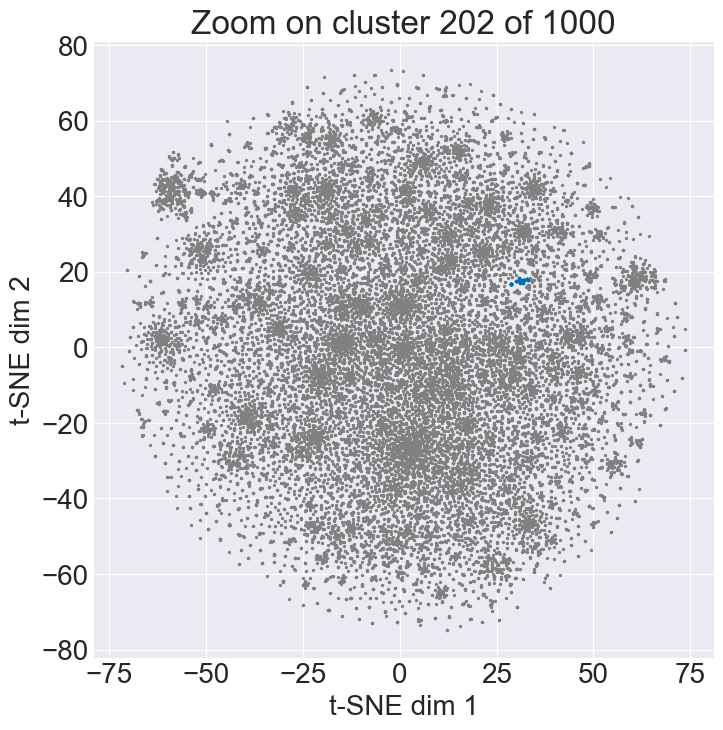

Cluster 202 (19 words):
fields, edition, livin, drones, destination, jamaica, writs, underfoot, sketching, dated, correlated, pashima, encompass, monaco, srms, partition, joshua, cancun, enoigh …


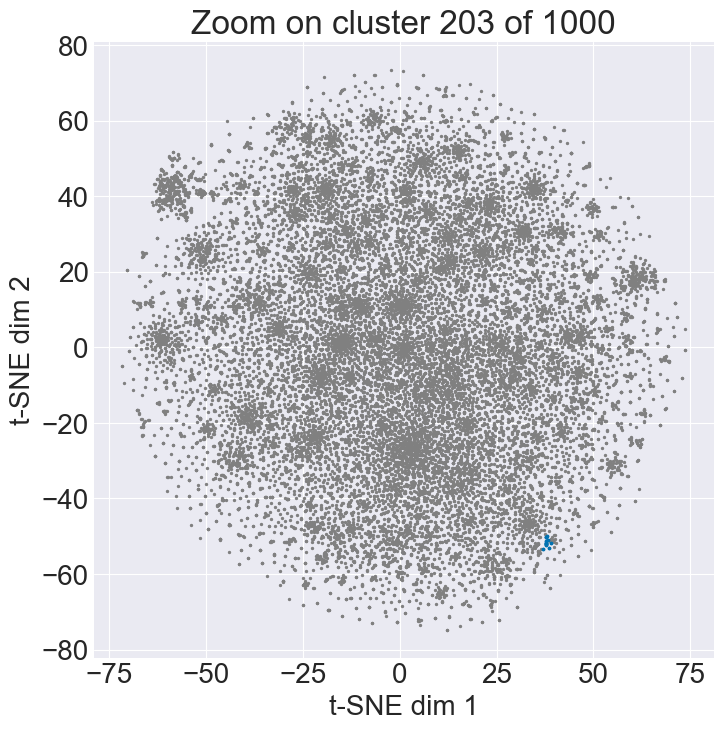

Cluster 203 (13 words):
unfolded, accessorized, assured, repaired, construed, improved, pompon, wornn, deemed, coordinated, interpreted, customized, ageless …


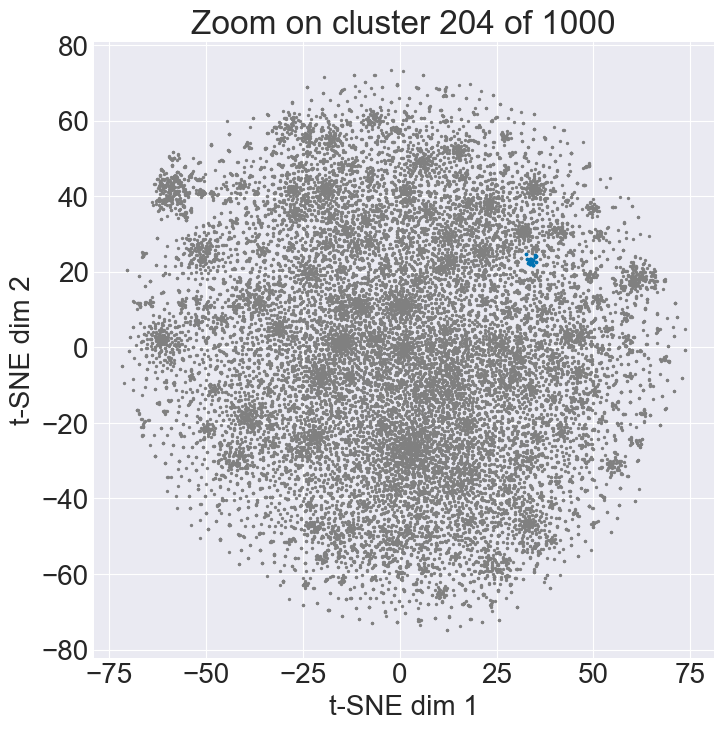

Cluster 204 (26 words):
stiffness, aesthetics, tiniest, sliminess, feela, straining, redesigning, reforming, heft, perfume, glitz, oomph, freshening, sexiness, clippers, rougher, bagginess, emery, gappy, rusting, encouragement, feminimity, accessorizing, scrappy, prowess, prestige …


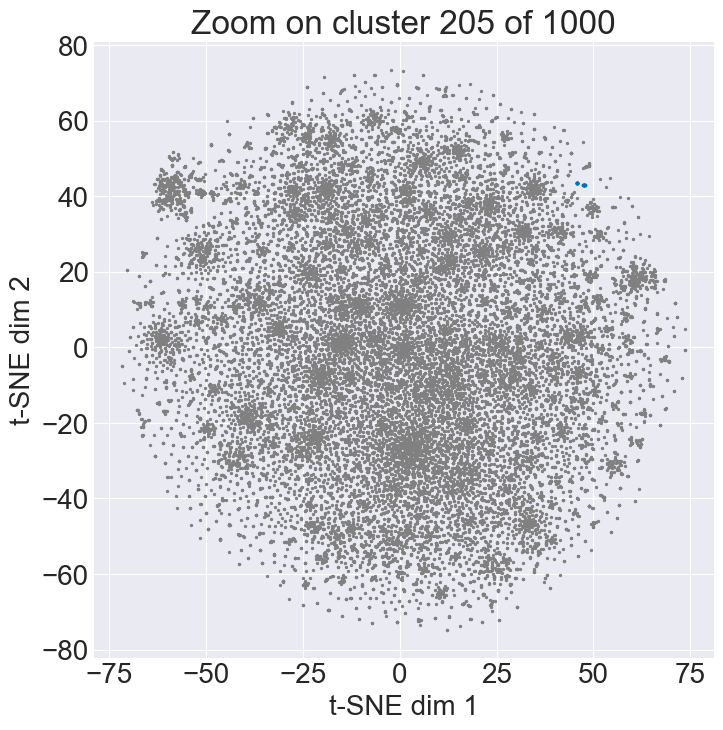

Cluster 205 (9 words):
few, lot, handful, couple, bunch, loads, dozen, alot, ton …


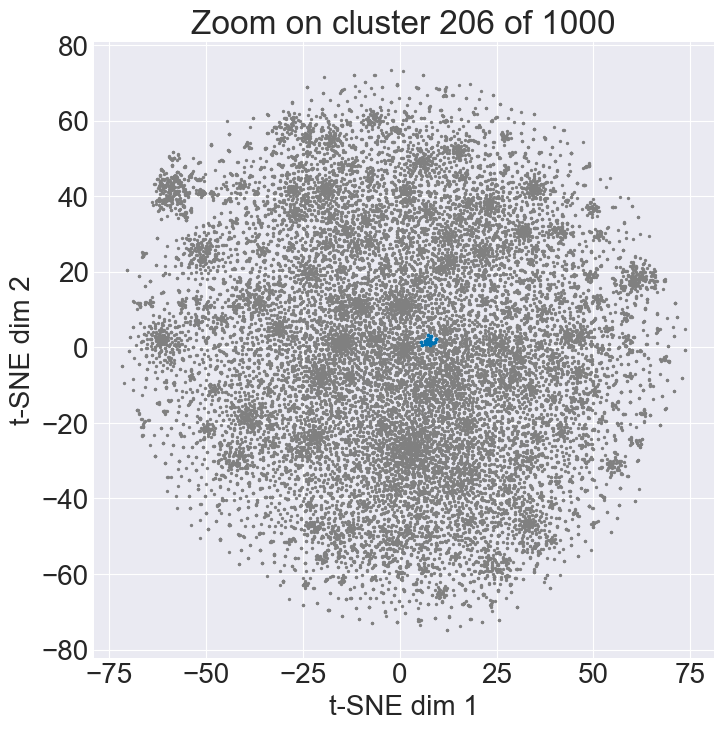

Cluster 206 (18 words):
idea, cowl, embroidered, convenience, unexpected, accuracy, shield, motif, complication, trend, bear, deign, tule, theory, saddles, chronograph, placket, varieties …


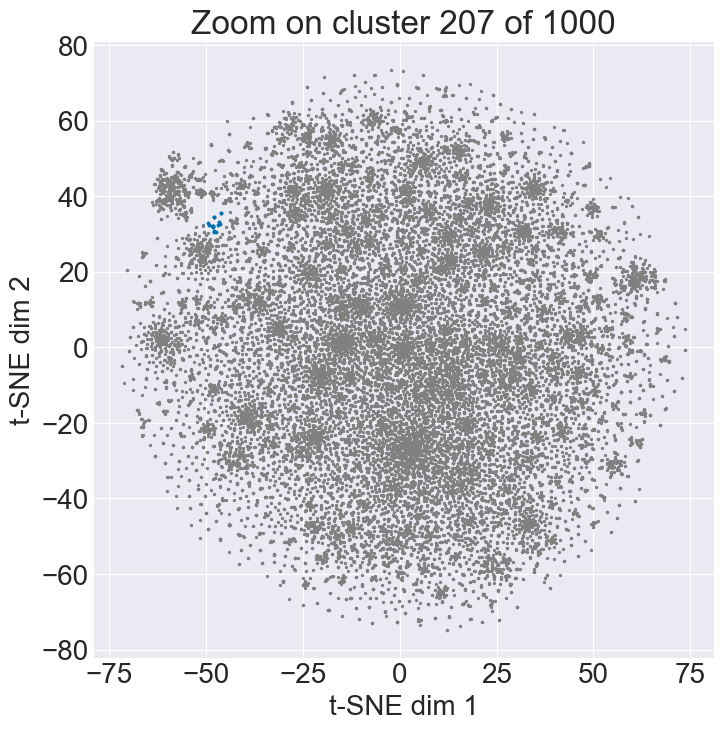

Cluster 207 (17 words):
blisters, discomfort, gizmo, soar, irritation, redness, reactions, soreness, poky, spits, nasty, incentives, incentive, bluchers, reals, vroom, tches …


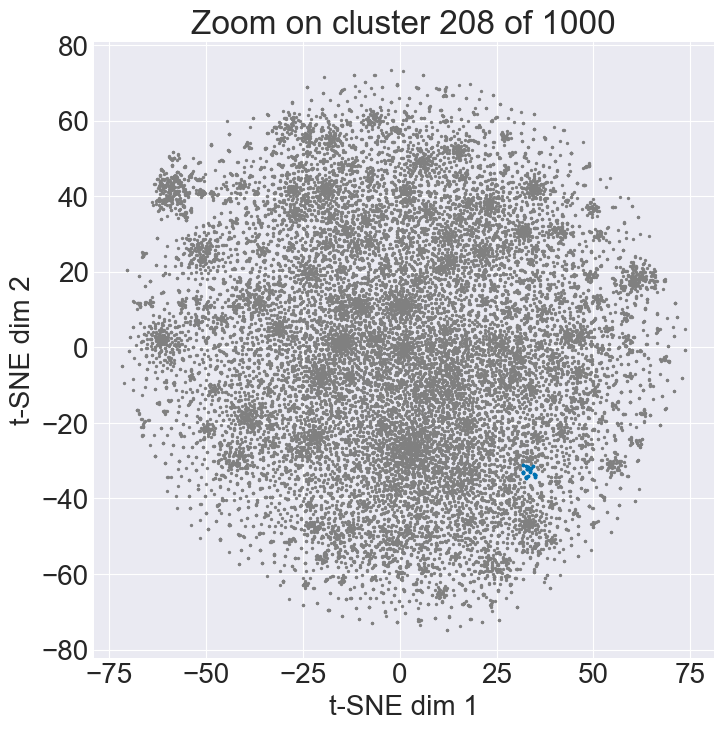

Cluster 208 (24 words):
crimp, breadth, commits, paring, evaluate, compresses, pilled, impedes, puts, dowse, launders, 1time, oughtta, receives, loveddddddddddd, doeznt, pulverized, softens, slouches, tickles, unzips, suze, nloved, haven''t …


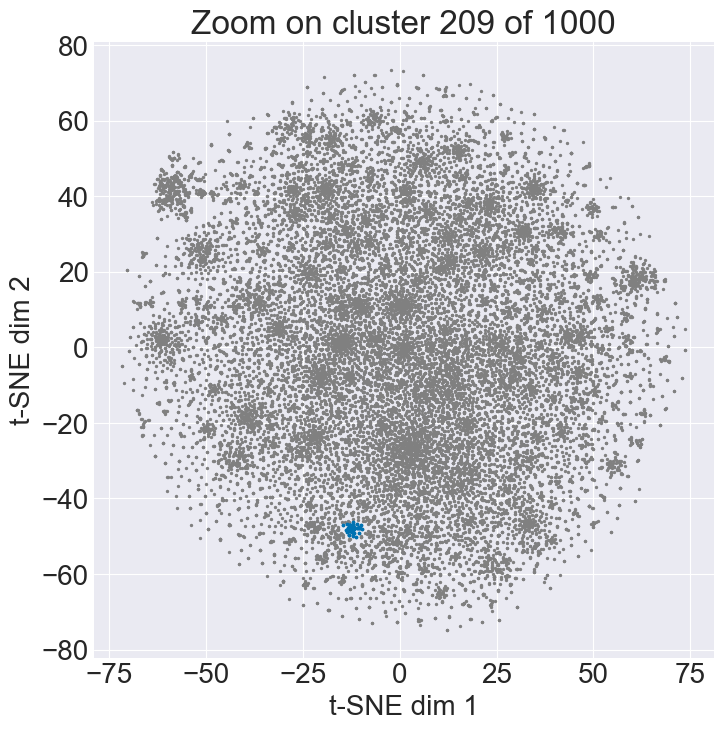

Cluster 209 (47 words):
editing, hopeful, 110lb, gauged, apt, grateful, altogether, sadisfyed, majorly, oooh, becuase, wealers, bama, presuming, thankful, 180pds, astonished, nearsighted, za, someday, ususally, presently, infact, uploading, gaining, 12p, 2mo, whiteys, disclosing, disclose, suffacating, officially, livid, submitting, a5, absolutley, copd, filing, photographer, pouds, 129lbs, 213lbs, 39bust, evertime, rainboots, 107lb, 230lb …


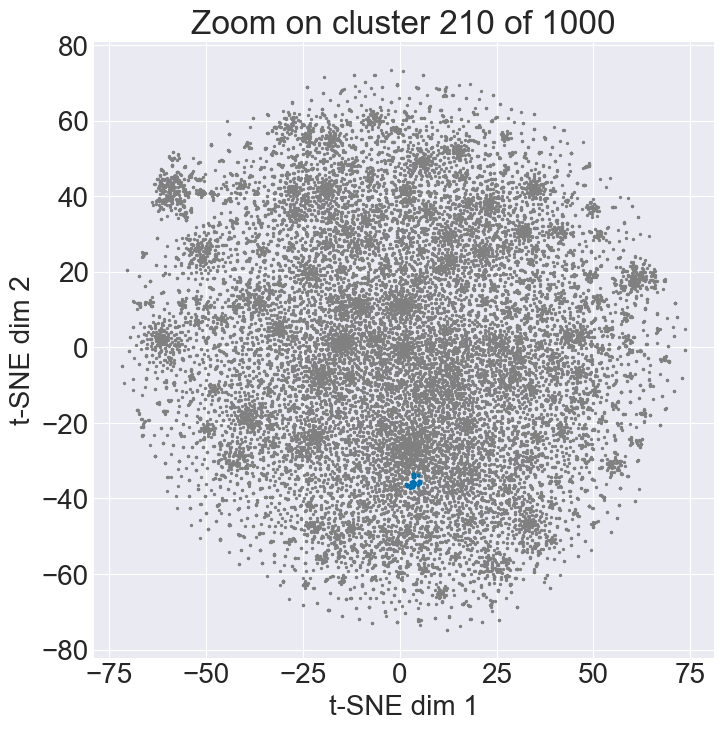

Cluster 210 (36 words):
ever, never, definitely, typically, occasionally, normally, usually, probably, certainly, rarely, bet, sometimes, anymore, likely, prob, eventually, flesh, naturally, ideally, generally, surely, definately, regularly, unlikely, definetly, cares, nobody, def, germs, males, accomplished, fro, personnel, xxx, clogging, probability …


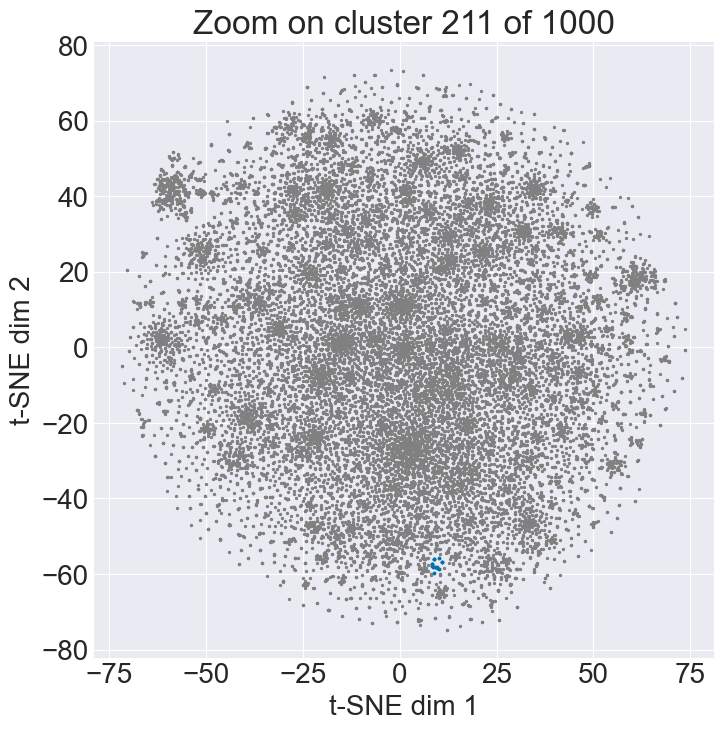

Cluster 211 (14 words):
again, defiantly, continue, unreservedly, mason, donot, supine, stilll, 1size, duct, 'up', kamik, purhcase, ull …


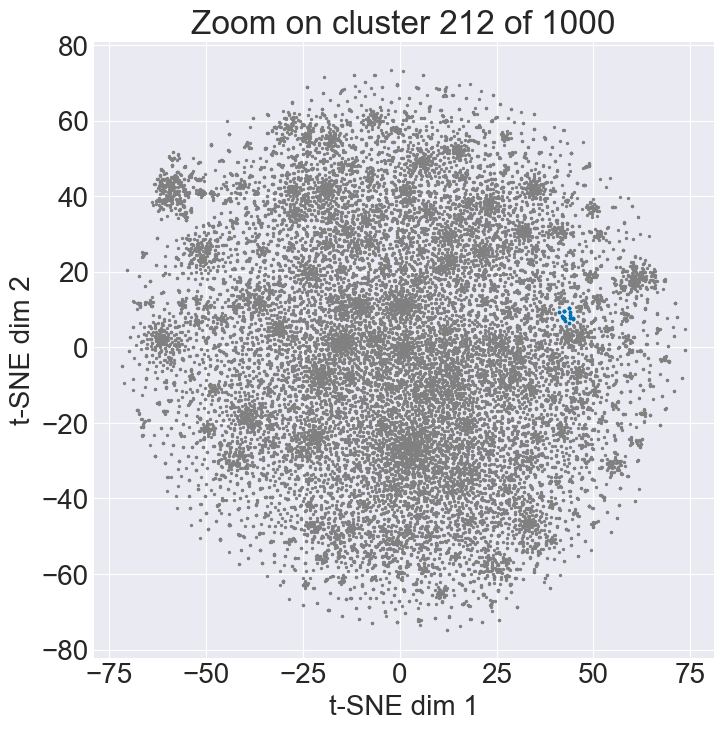

Cluster 212 (18 words):
braids, skilled, request, petit, profit, practicality, herbs, emfs, strike, treads, escape, 24hr, 80lbs, milagros, jamming, 45in, bx, fresheners …


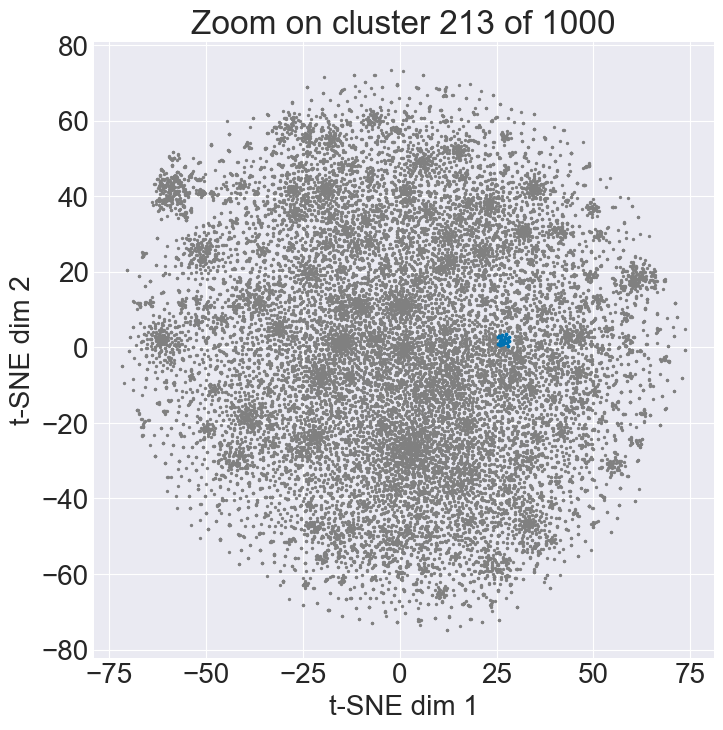

Cluster 213 (30 words):
simple, statement, fun, whimsical, trendy, classy, professional, unusual, elegant, comforts, simplistic, summery, sophisticated, feminine, striking, chic, oriented, handsome, cheerful, humorous, minimalist, practical, edgy, sporty, artistic, glamorous, androgynous, sami, believable, mod …


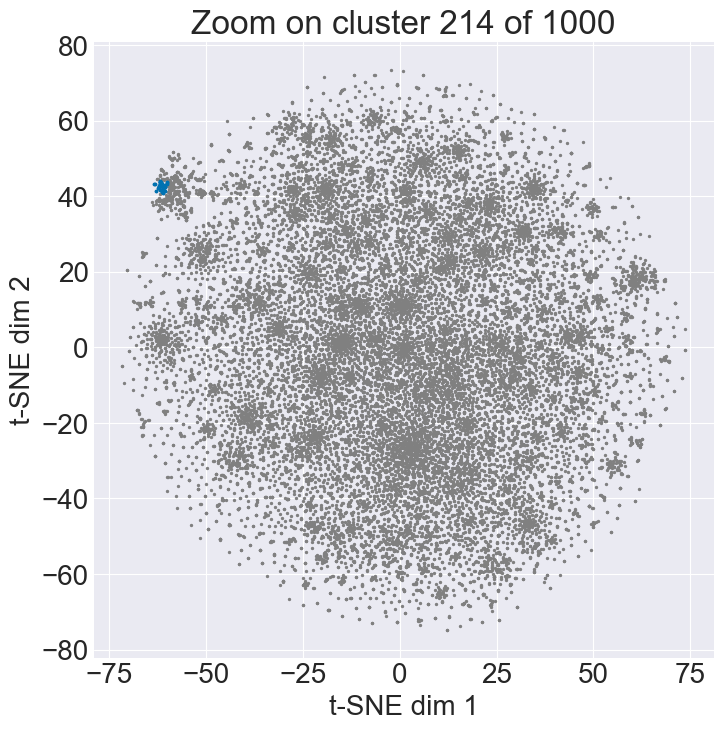

Cluster 214 (36 words):
un, para, excelente, rapida, entrega, facil, usar, combinación, corazón, marco, rígida, regalar, tipo, camisetas, ajustadas, bolsillo, delgada, accesorio, viaje, piernas, debí, pedir, número, fina, enamorada, asas, redondo, haberlo, vendedor, cumpleaños, mezcla, armonicos, sobre, freepeople, nada, lente …


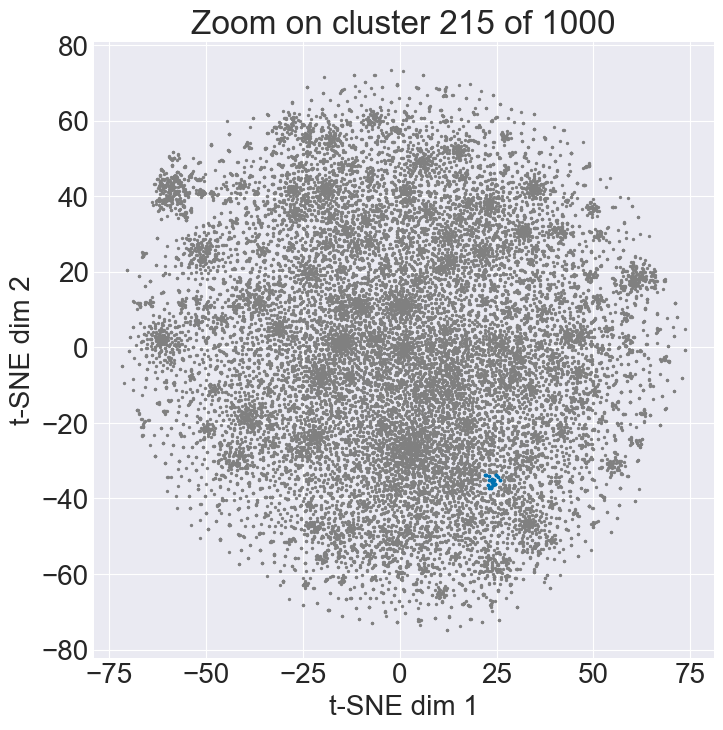

Cluster 215 (22 words):
soften, reshape, crush, jazz, survive, objects, manipulate, creep, situated, commitment, adapt, informed, adhere, retrieve, ouy, contracts, scan, overpower, fad, earn, dripped, squishes …


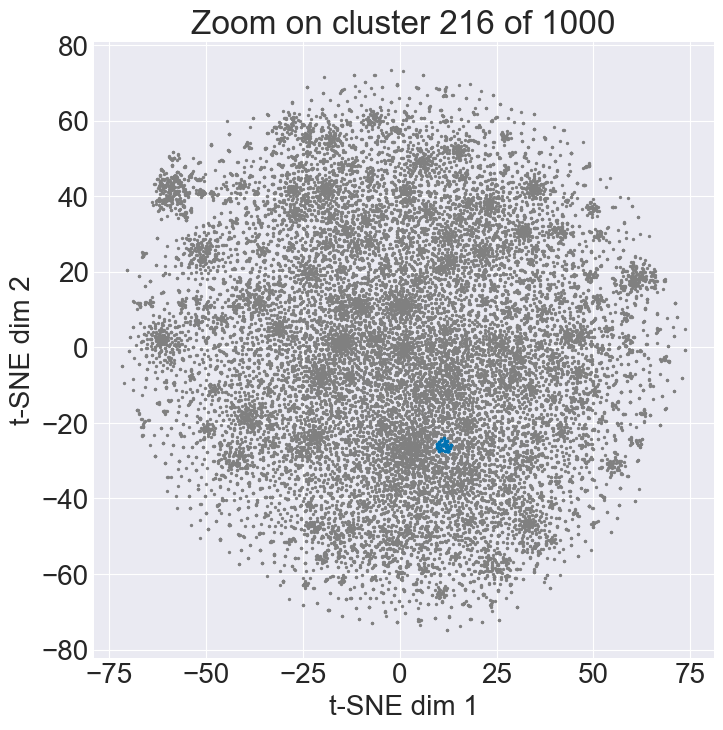

Cluster 216 (40 words):
is, are, looked, was, looks, isnt, were, its, look, felt, wasnt, thats, looking, feels, feel, puckers, sounds, theyre, arent, theyve, touches, werent, leaves, arnt, mailing, resembles, isa, grams, r, loupe, remain, pleather, compressions, shines, excuse, becomes, affects, spins, presents, suedes …


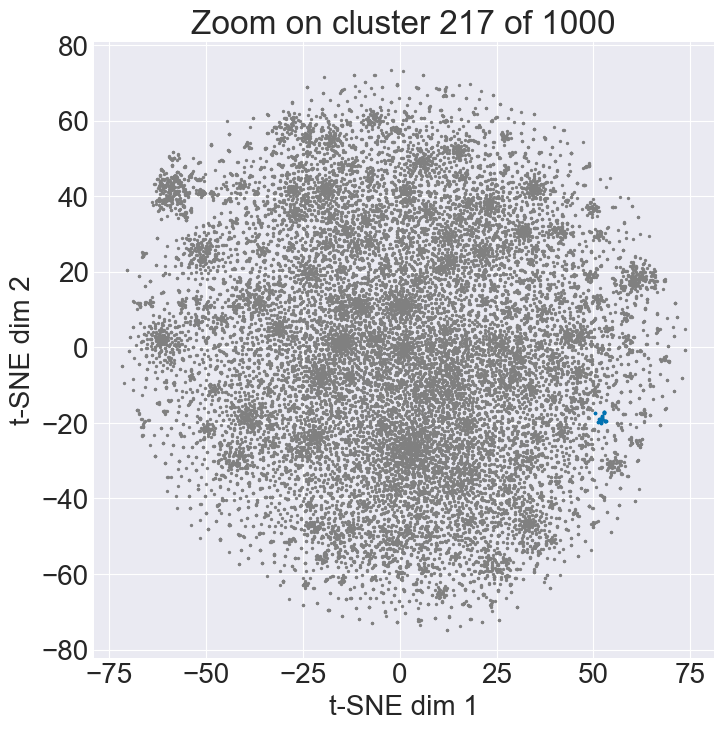

Cluster 217 (18 words):
overwhelmed, homage, depictions, performs, stinesy, conceals, wel, danglers, print001, mushed, pissed, sill, bichin, sums, goos, nestled, larnyard, scrambled …


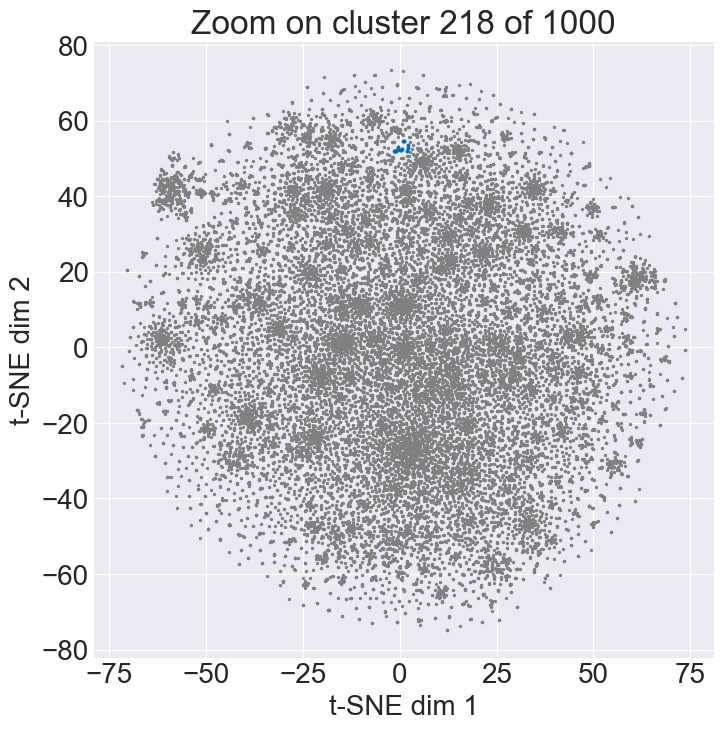

Cluster 218 (18 words):
twenty, thirty, fifty, fundraiser, thousands, forty, thanksgiving, cupcake, eighteen, cardio, nineteen, seventy, thirteen, twelve, fifteen, ringspun, zillion, murder …


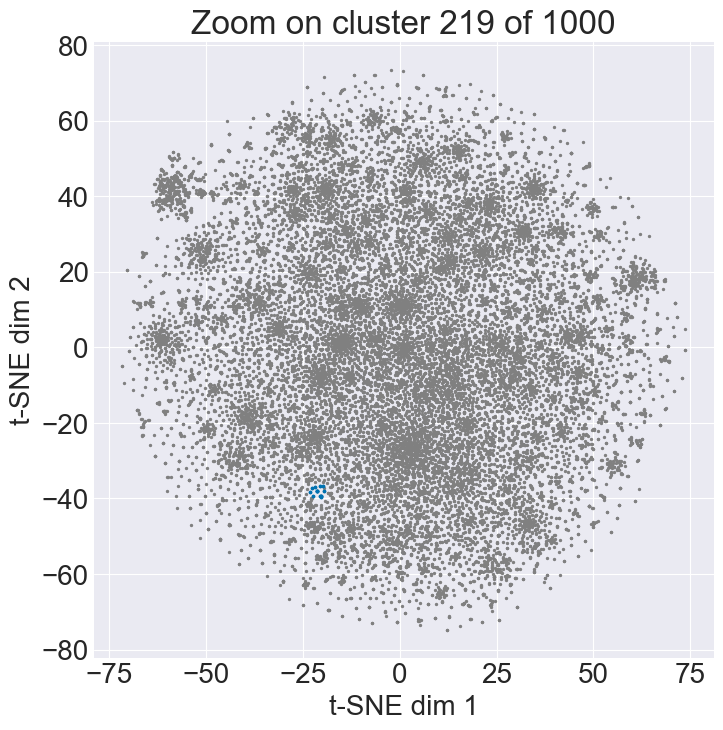

Cluster 219 (14 words):
technology, horizontal, granny, agreed, presumably, incognito, vac, scrubbies, dec10th, vacuumed, pkt, itii, pii, stow …


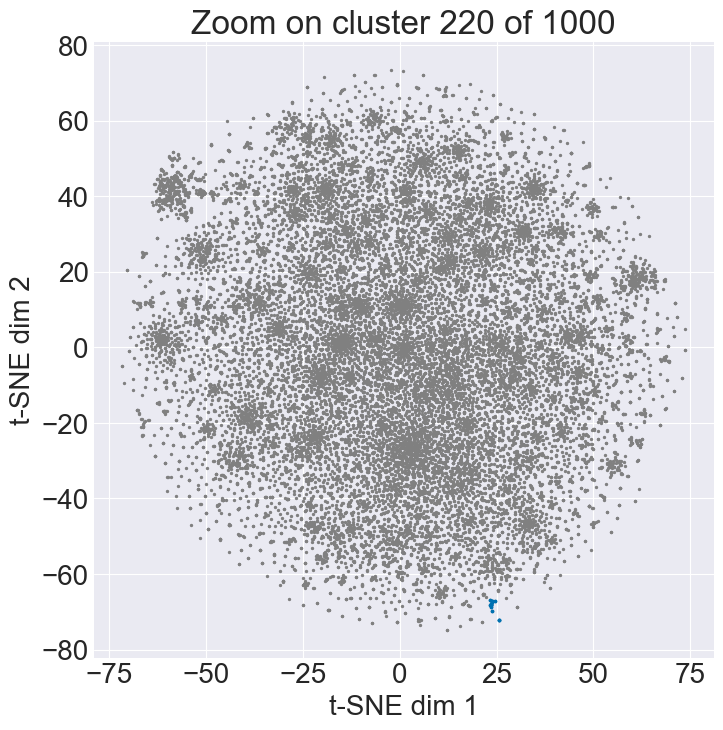

Cluster 220 (14 words):
needless, oxidize, alters, suffice, budge, certainty, nnooooopppee, emily, 'ever', sloopy, dumping, 'made, nonna, reps …


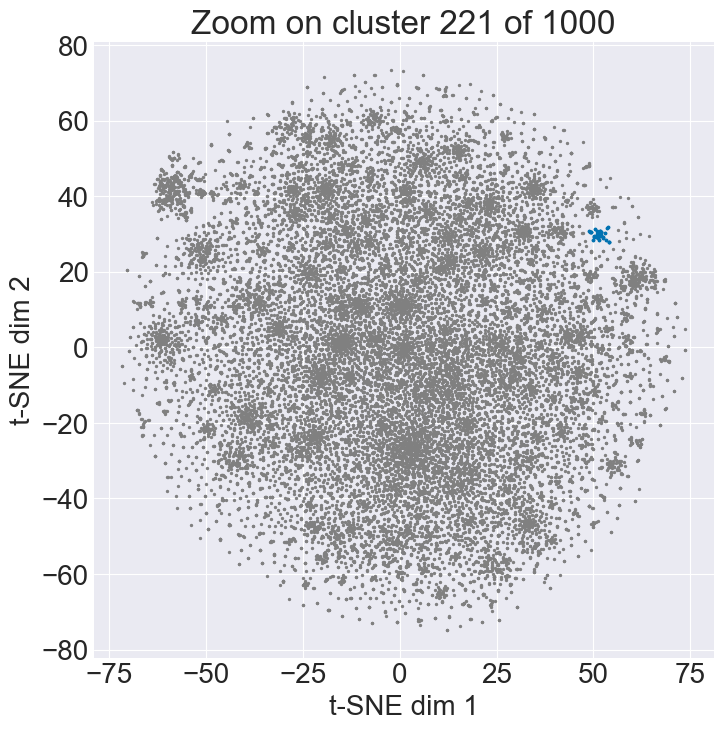

Cluster 221 (39 words):
sheen, riot, competitive, footing, bluestone, absoluely, openwork, unpolished, colorshifting, neclase, extent, zentron, rosary, raven, absolutly, meticulously, absoutely, mizuhara, headhands, glistening, sober, divers, luxuriant, absolutity, ia, liovely, f3607da099f827979b786d5ac2e1b4ad, inlove, mousepad, breathtakingly, dorothy, 2d, craved, umgee, brelace, pirce, e89a60b4609bbf3a7affa98407c4a877, braclet, thrre …


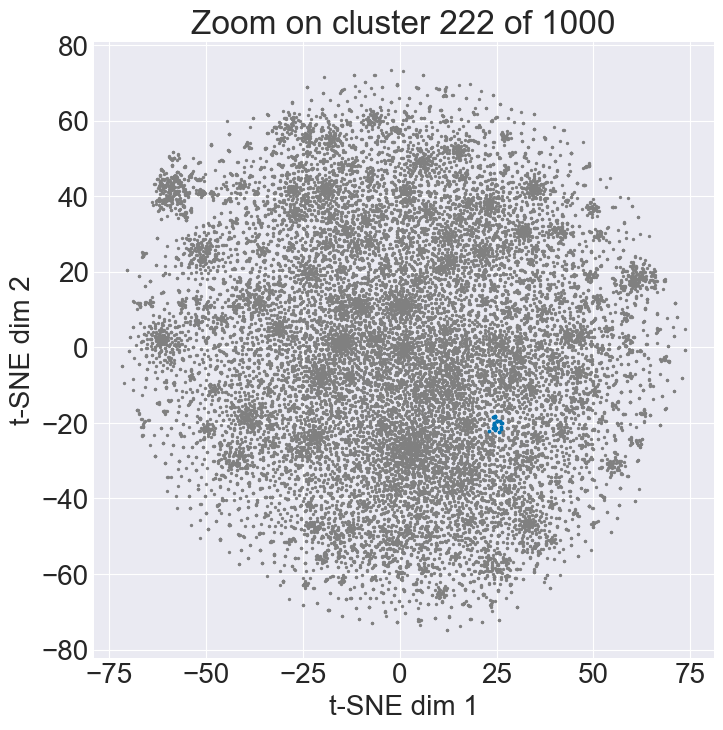

Cluster 222 (24 words):
secured, together, spray, closed, secure, fastened, backwards, connected, painted, shut, supported, contained, accentuated, cinched, organized, aligned, distribute, crushed, firmly, slow, alcohol, encased, waterproofing, plainly …


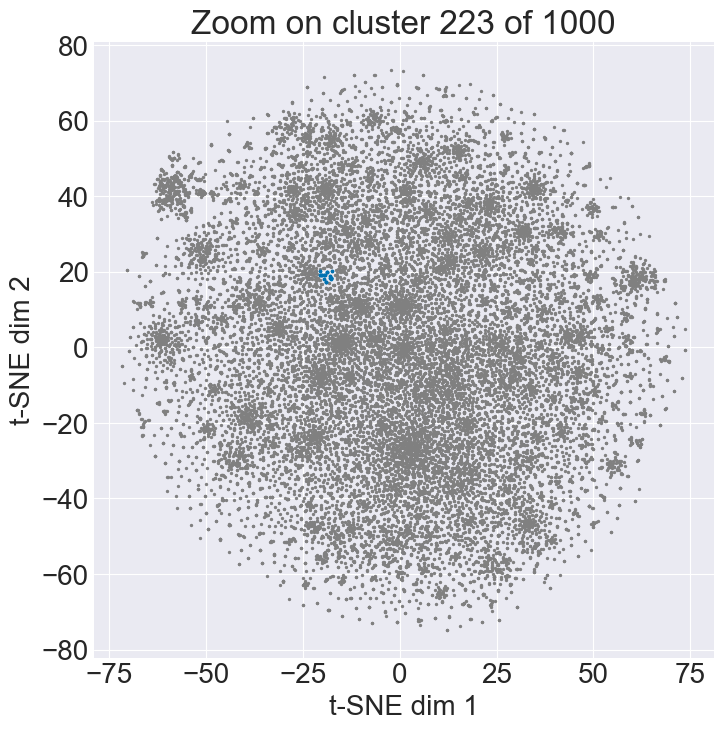

Cluster 223 (18 words):
allot, rainy, walls, op, microphones, minuscule, blustery, stares, inquiries, breeziest, chefs, kiss, putty, losts, lanterns, cuteee, glances, dryable …


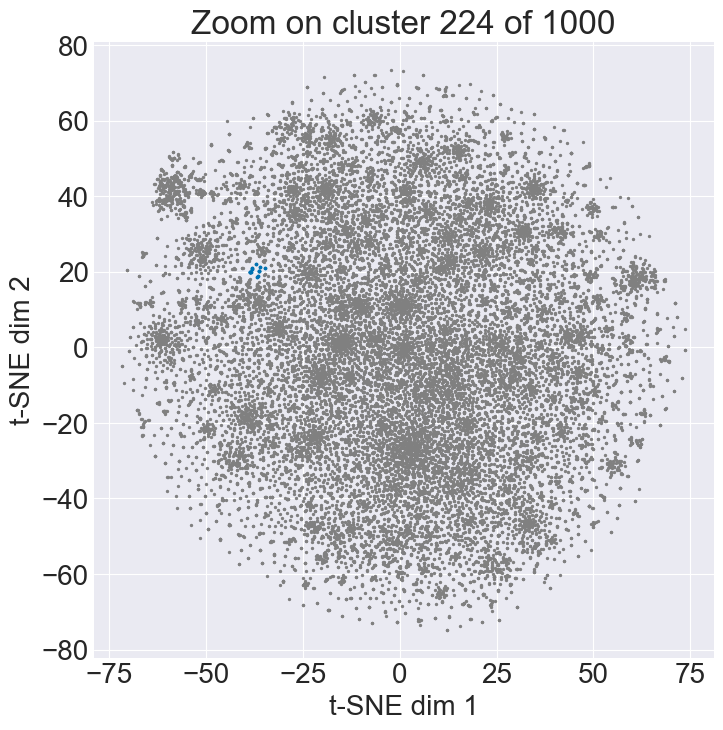

Cluster 224 (13 words):
goodness, term, newsboy, aa, tap, pompom, overdue, soldier, gosh, rates, stylelkeye, officer, mylanta …


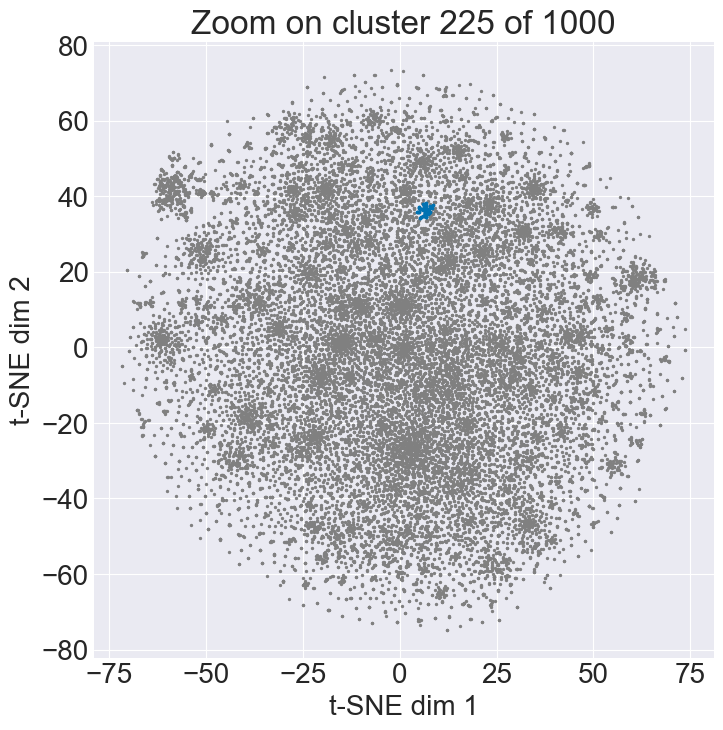

Cluster 225 (47 words):
pledge, hurry, gs, necessity, featuring, testify, heartbeat, turkish, 'small, nutshell, infantile, dorm, elderly, touchbar, housed, timely, alongside, drawings, paris, steamy, permeant, pantyline, wonderland, 5k, reduction, alpine, watchmaker, hamper, dojo, arc, pigmented, cherished, seashore, pep, procedure, surfaced, supercross, speech, attendant, unifrom, bohemia, kiln, motor, headlock, specializing, 000th, rainstorm …


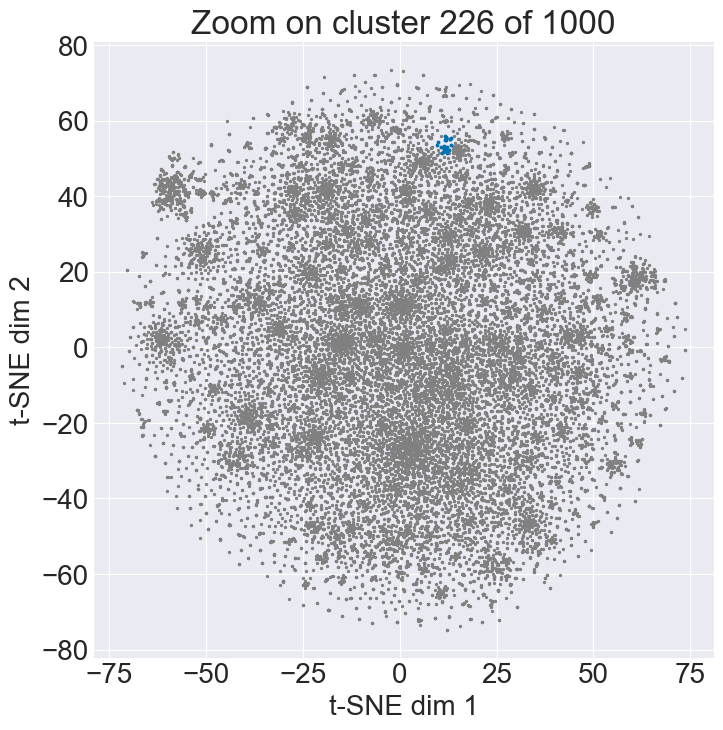

Cluster 226 (25 words):
forest, decoration, events, undergarment, photographed, diaper, generalized, token, temporary, housecoat, capezio, coaster, gatherings, instances, kakashi, undergremnt, hills, sackcloth, rewards, chests, brunch, hardcore, affairs, jasmine, recognition …


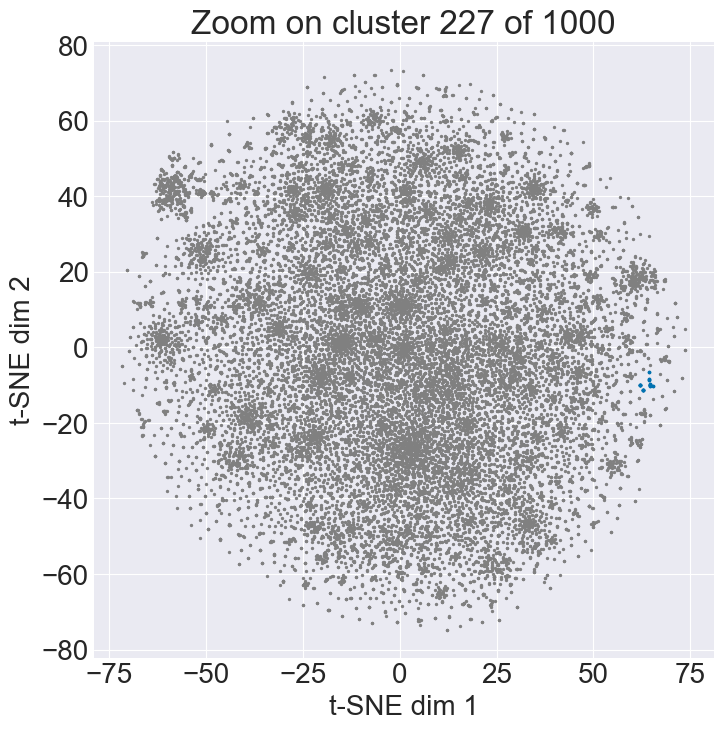

Cluster 227 (15 words):
cooler, colder, warmer, mildly, tremedously, weathers, warmish, rotates, migraine, blazing, sultry, overcast, windchill, tom, waits …


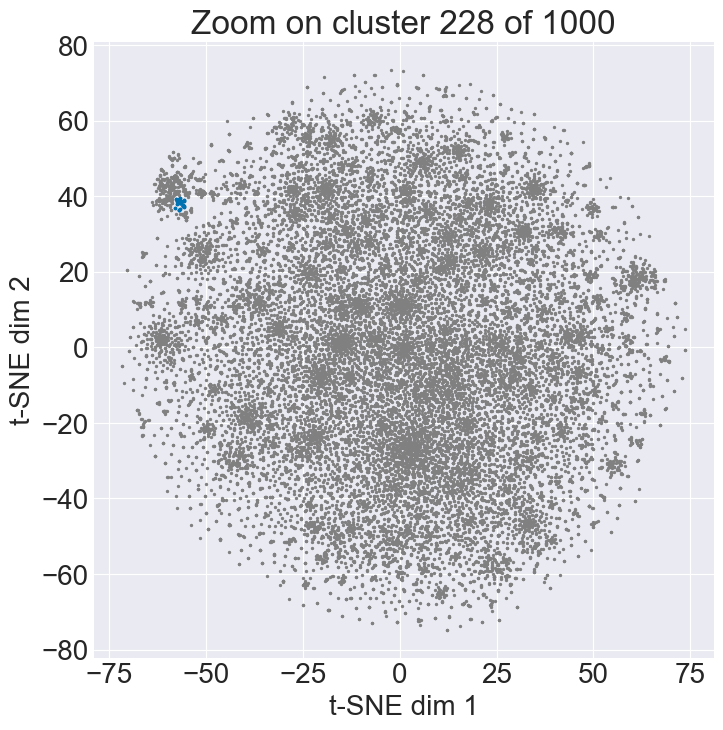

Cluster 228 (25 words):
le, gustaron, mi, hijo, hermosos, las, nietas, mala, la, es, en, foto, sobrina, talla, acuerdo, esposo, cuanto, su, igual, imagen, pequeño, sin, llegar, ser, minúsculo …


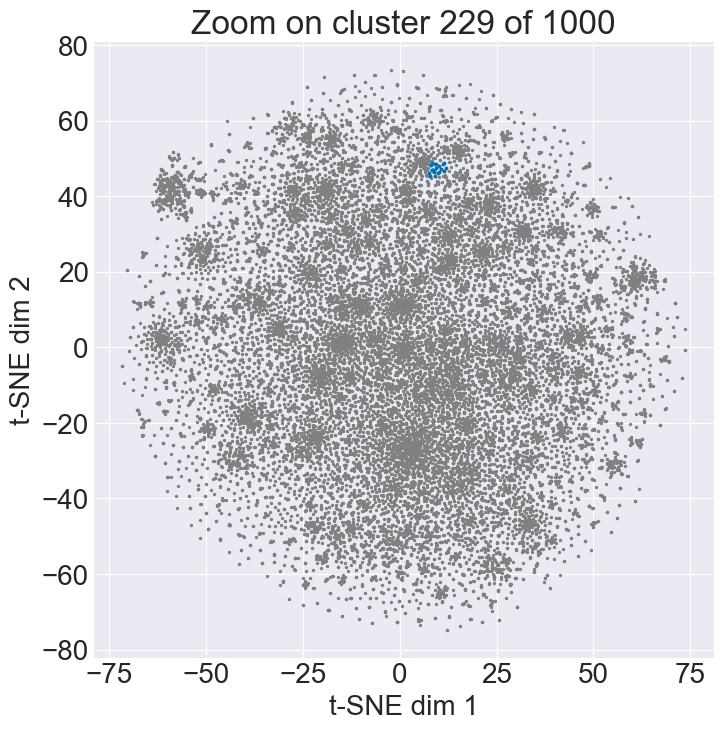

Cluster 229 (21 words):
treasured, broach, trending, religious, favor, rayban, aliittle, kingdom, containing, giveaway, considerable, appointment, coupon, drizzle, perpetually, chats, nana, anticipation, cookout, itemat, prized …


In [60]:
for i in range (30):
    cluster_search = 200 + i

    # mask for points in that cluster
    mask = (labels == cluster_search)
    pts_all = word_tsne
    pts_cluster = word_tsne[mask]

    # compute bounding box of the cluster
    min_x, min_y = pts_cluster.min(axis=0)
    max_x, max_y = pts_cluster.max(axis=0)

    # add a little padding (5% of width/height)
    pad_x = (max_x - min_x) 
    pad_y = (max_y - min_y)

    xlim = (min_x - pad_x, max_x + pad_x)
    ylim = (min_y - pad_y, max_y + pad_y)

    # plot
    plt.figure(figsize=(8, 8))

    # 1) all points in light gray
    plt.scatter(pts_all[:, 0], pts_all[:, 1],
                c='gray', s=2, label='other clusters')

    # 2) this cluster in blue
    plt.scatter(pts_cluster[:, 0], pts_cluster[:, 1],
                c='C0', s=3, label=f'cluster {cluster_search}')

    # set limits to zoom
    # plt.xlim(*xlim)
    # plt.ylim(*ylim)

    plt.title(f'Zoom on cluster {cluster_search} of {k}')
    plt.xlabel('t-SNE dim 1')
    plt.ylabel('t-SNE dim 2')
    # plt.legend(markerscale=3)
    plt.show()

    # optional: print out the words in this cluster
    words_in_cluster = [ind2word[i] for i in np.where(mask)[0]]
    print(f"Cluster {cluster_search} ({len(words_in_cluster)} words):")
    print(", ".join(words_in_cluster[:50]), "…")


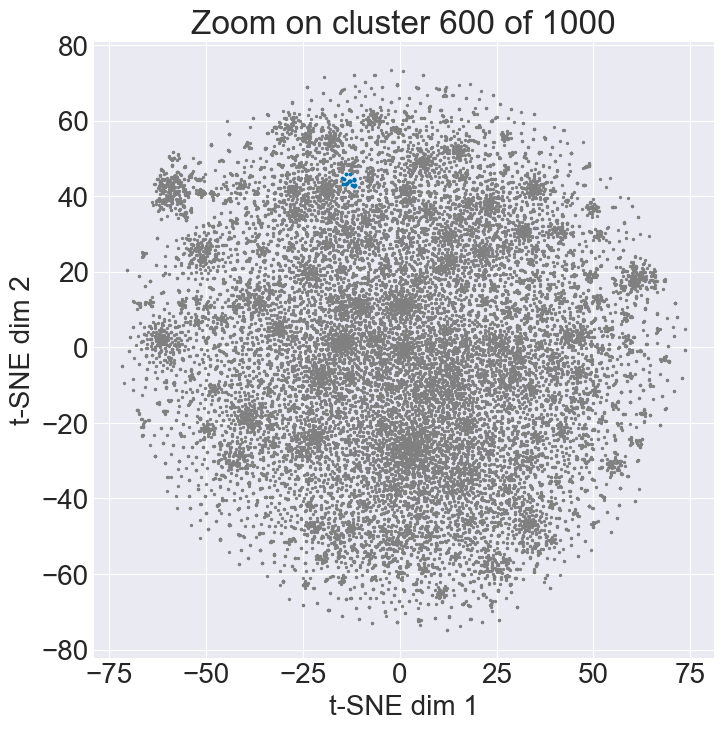

Cluster 600 (19 words):
mosquito, heritage, shrine, description', stacking, reception, indian, sperrys, bouquets, farm, hometown, poses, iwatch, van, convert, joker, voodoo, saga, pinterest …


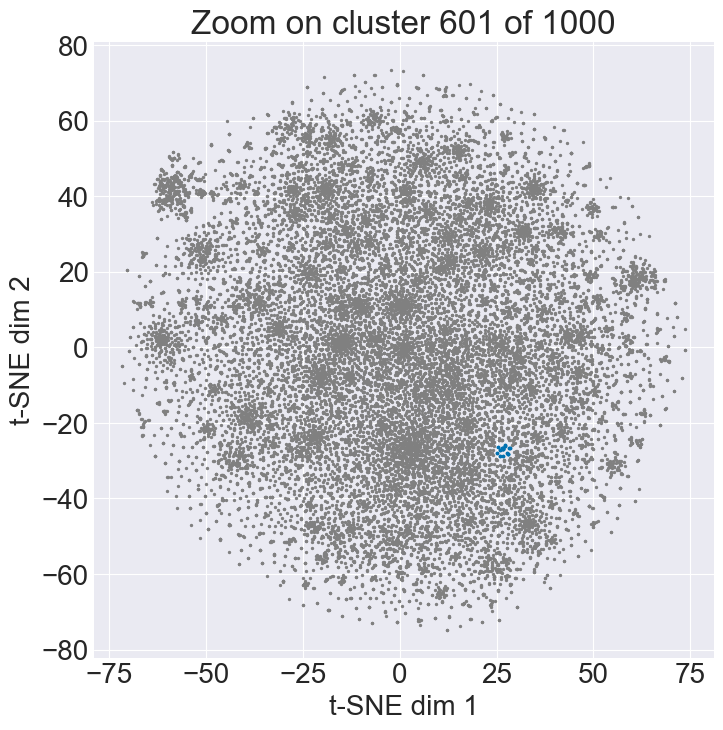

Cluster 601 (18 words):
faded, sassy, loosened, became, fades, thrown, halfway, delivers, sticking, bringing, bled, spanned, heats, tightens, sneezing, dissipated, tapping, dulled …


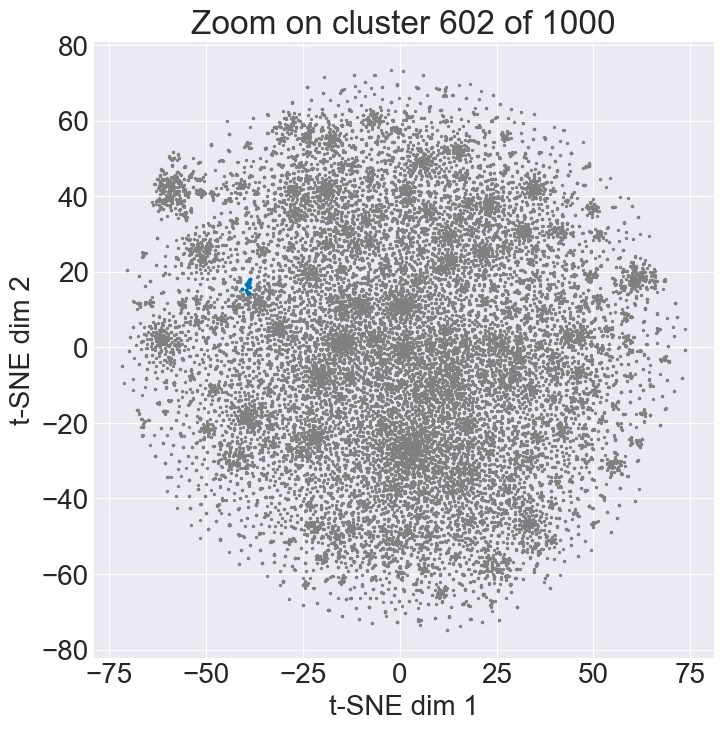

Cluster 602 (25 words):
swirl, hashtag, novmay, bakoor, clavicle, solves, tahitian, lanzoom, gemske, lk, omega, superlong, prayer, bolo, c7, execellent, coiled, tauntaun, 'family, tree', absofruitly, elegeant, medalion, my14, sress …


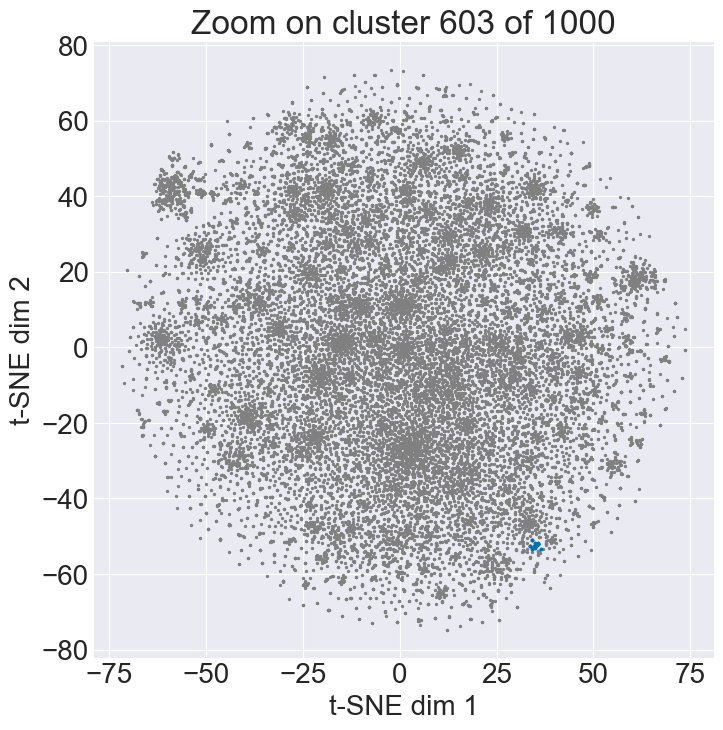

Cluster 603 (18 words):
wiped, overlooked, tacked, pried, banned, enought, jerseys, unsupportive, dirted, terrified, nightcream, tweeked, regretting, patted, bogged, understood, interchanged, liberating …


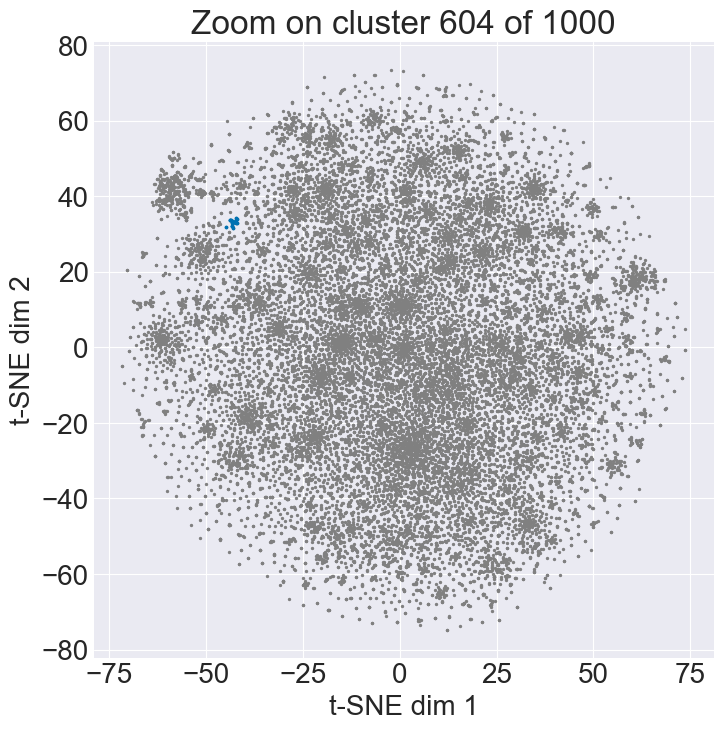

Cluster 604 (19 words):
tj, cookware, parent, mushrooms, creams, maxx, marshalls, registration, moisturizers, msm, timers, calendars, playgrounds, marshals, nicknames, barbudo, barba, negra, drake …


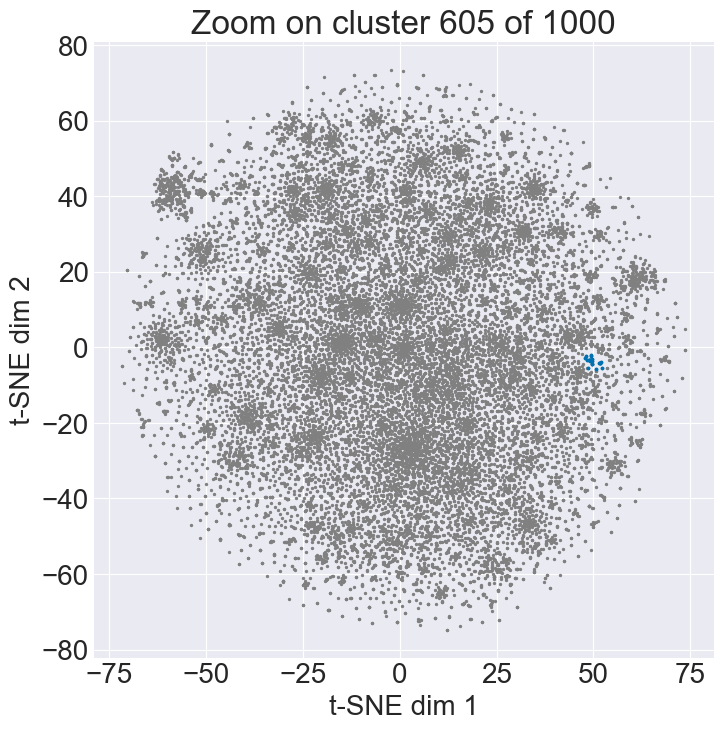

Cluster 605 (23 words):
pizazz, spendy, lareg, ounces, 12m, tolerable, recreation, amused, bearable, worths, peeing, waaayyy, 'nice, splurged, overruns, slower, jammed, oranges, nontheless, altough, longerbin, 18hrs, rosy …


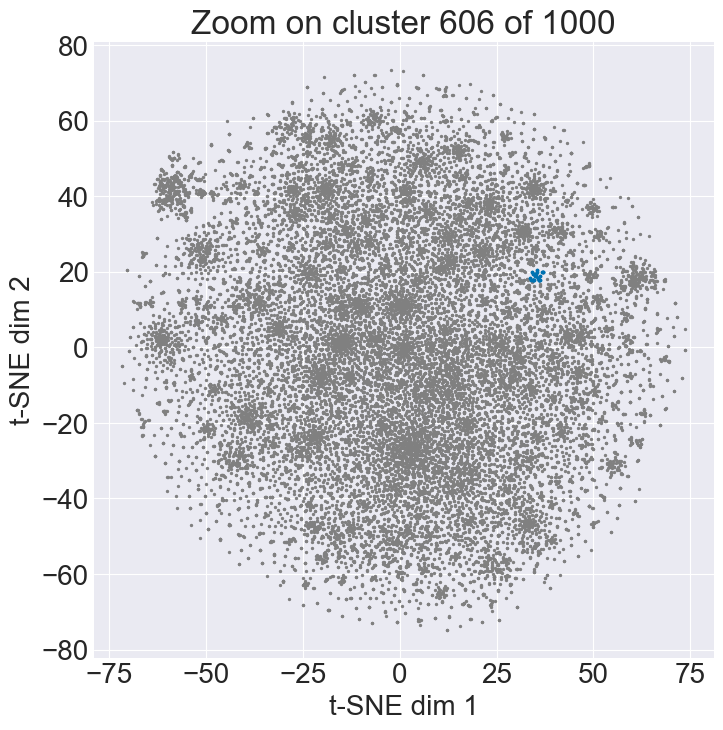

Cluster 606 (26 words):
scuff, rug, muddy, extrmeley, onsie, absurdly, unassuming, chid, penlight, intricately, yu, tow, datk, fleck, makeover, sooooooooooo, tooooooo, foreheads, corduroys, gott, clipboard, somehwhat, wist, dindont, watchface, coastal …


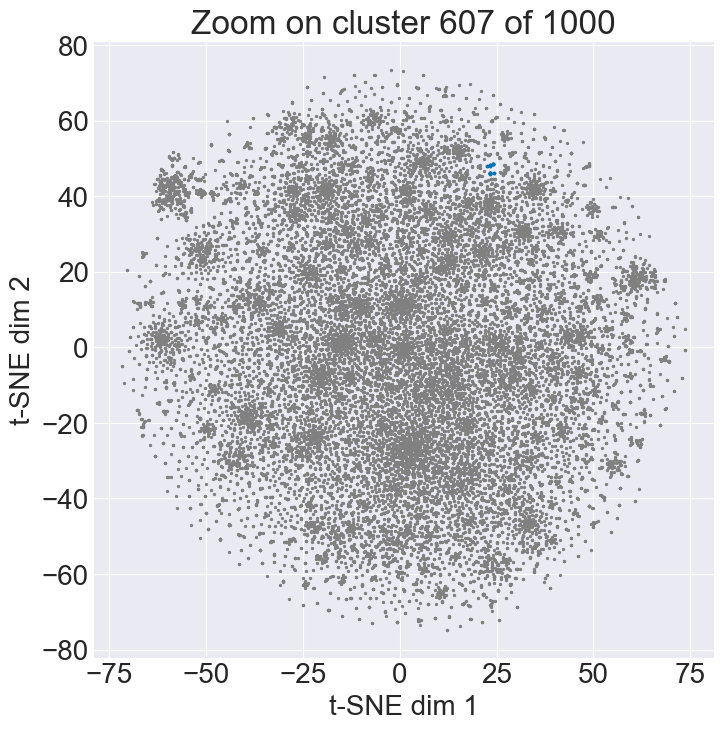

Cluster 607 (13 words):
flash, football, breaker, restaurant, lightning, 10k, carnival, lightening, oxygen, groupon, hockey, notre, dame …


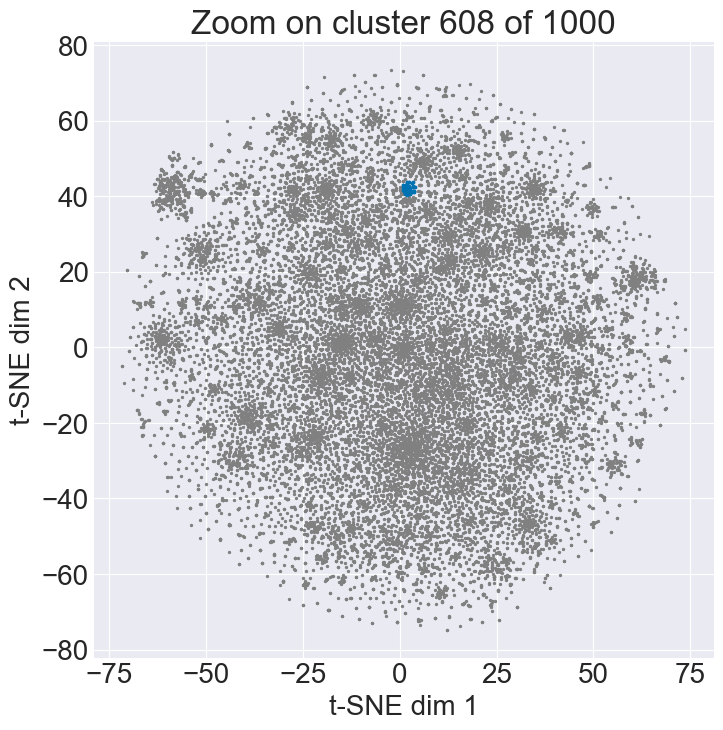

Cluster 608 (44 words):
burglar, file, northstyle, squatting, bbqs, pantsuit, shadow, muslin, spooky, employers, belf, headcover, 0mm, maim, discoloring, hubberds, sno, olympic, distilled, slowing, adverse, wafer, reconcile, valid, peached, acutally, headlamp, skank, fuzziness, tasselled, madewell, meaty, moobs, syrup, jcpenney, cheesecloth, barts, jupiter, stormtropper, acorns, stilettos, fpr, sierra, wildfox …


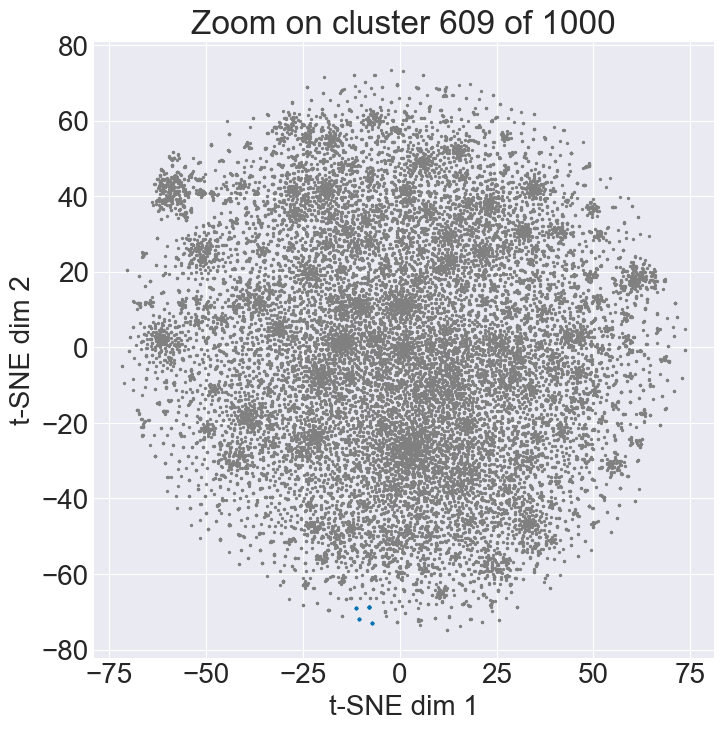

Cluster 609 (10 words):
comment, speak, 'v', believed, chiming, vince, camuto, attest, vouch, nubbed …


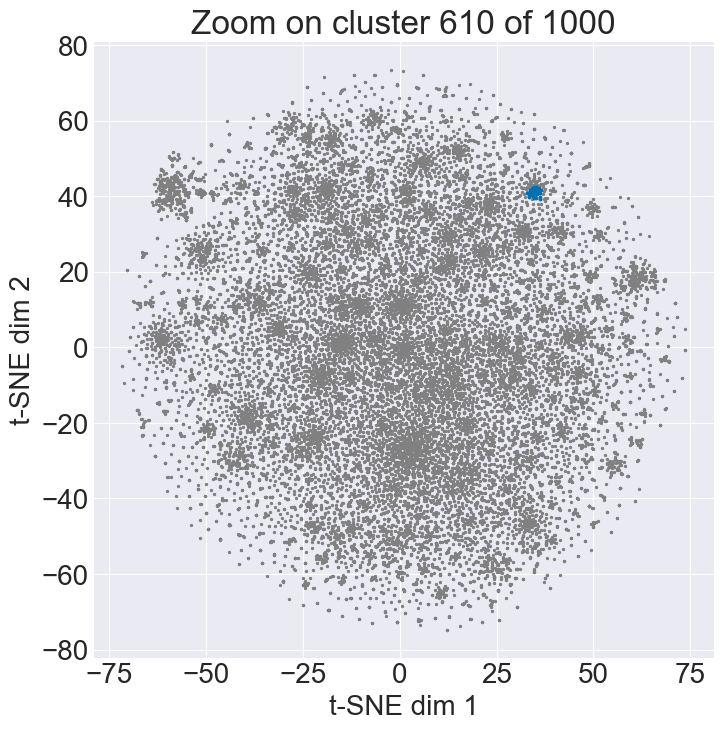

Cluster 610 (48 words):
cowbell, limp, batwing, sausage, million, ridge, tent, stilletto, reish, 1xl, cuddling, goddess, replica, trinket, hanky, peasant, linebacker, muumuu, totem, manacle, tubby, gecko, hussy, blob, rucksack, pudge, twig, dork, cheese, swivels, billboard, mallofusa, evergreen, babe, foul, transfomer, pocketknife, bonafide, champ, beacon, thirtyone, shivering, persian, 30c, saps, rockstar, tarp, peas …


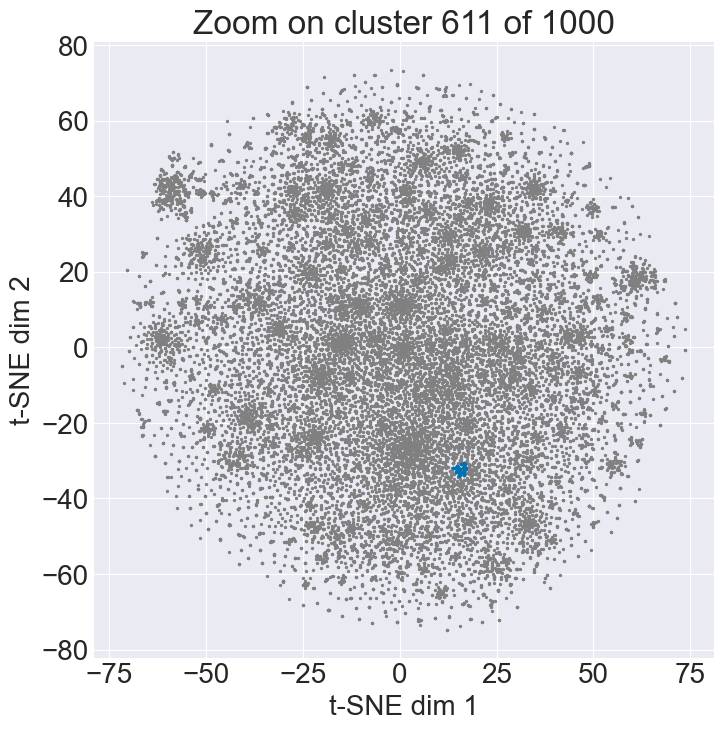

Cluster 611 (33 words):
go, work, allow, pop, come, stick, hold, holds, stand, worked, coordinate, arrive, accommodate, perform, fill, suck, enhance, tangle, sell, treat, engage, focus, float, expand, count, chenille, pucker, drown, yank, insure, sync, ensuring, divide …


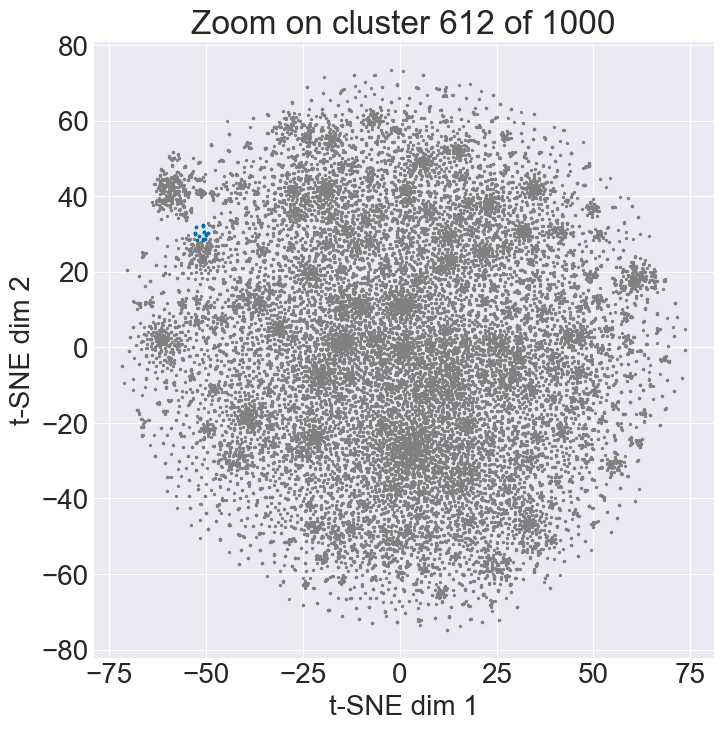

Cluster 612 (14 words):
boo, offense, clue, wobbling, brainer, maui, jims, reed, texting, unwatned, ulnar, lululemon, exacto, rail …


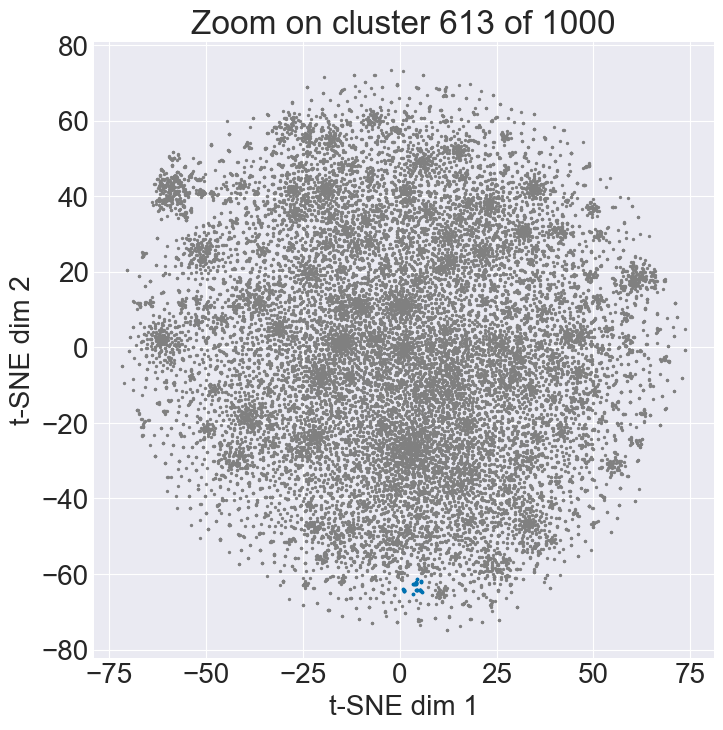

Cluster 613 (23 words):
forgot, propellers, erect, moisturize, rimless, deer, npow, xland, wanna, accomplish, fooled, skerrd, responds, natured, dare, discuss, misled, betision, recall, network, wanderlust, stove, dissuaded …


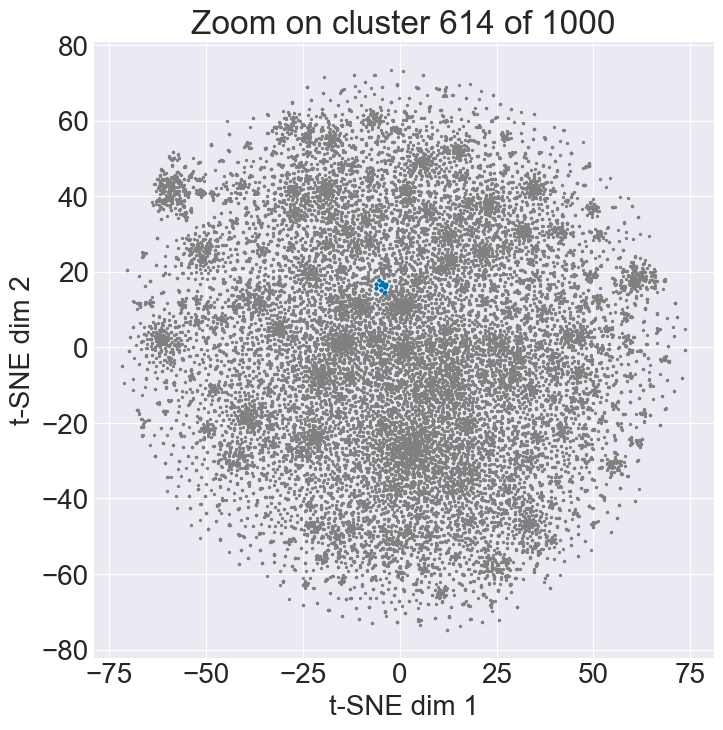

Cluster 614 (23 words):
fond, jewerly, morse, coupled, kerrits, macrons, zoom, outback, machinery, chamois, b4cause, vibes, accordance, beret, john, pope, blaming, classics, affiliated, prodiuct, leos, unstatisfied, scintillating …


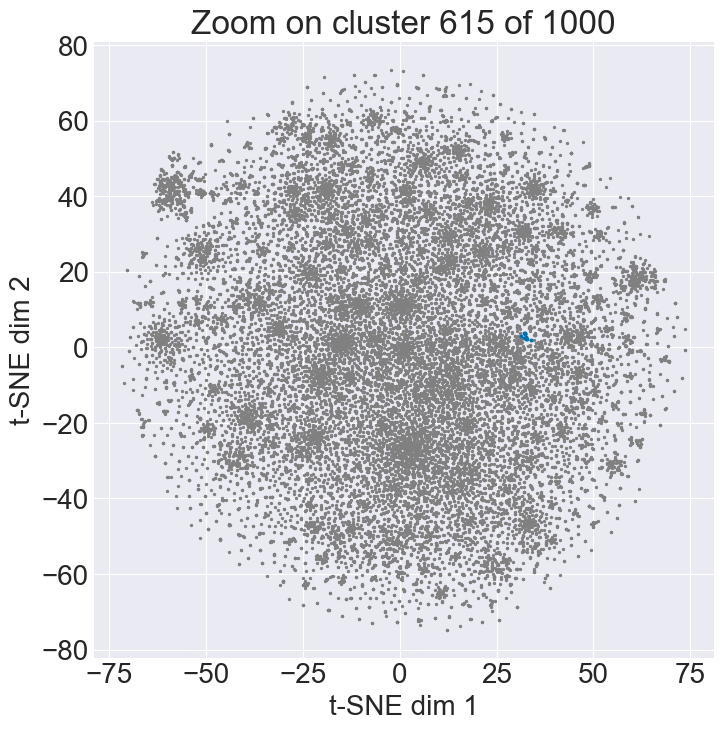

Cluster 615 (12 words):
moda, modacrylic, algebra, elastane, polyamide, behaved, denier, ee, urethan, heathery, spandax, simulating …


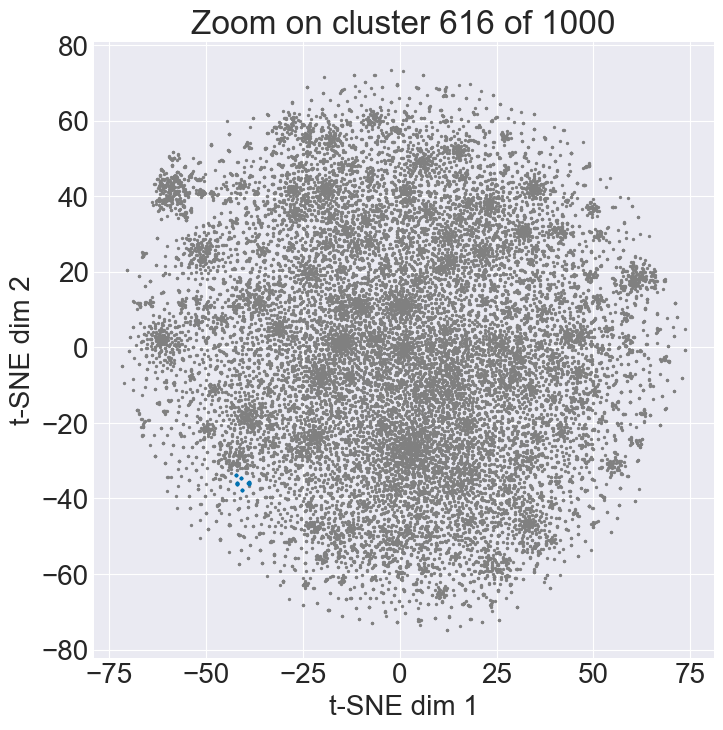

Cluster 616 (15 words):
uncertain, mishaps, leggy, interlock, gerat, freakish, stifling, normov, sculpting, othe, carifa, sgs, revolutionary, eeyore, echoing …


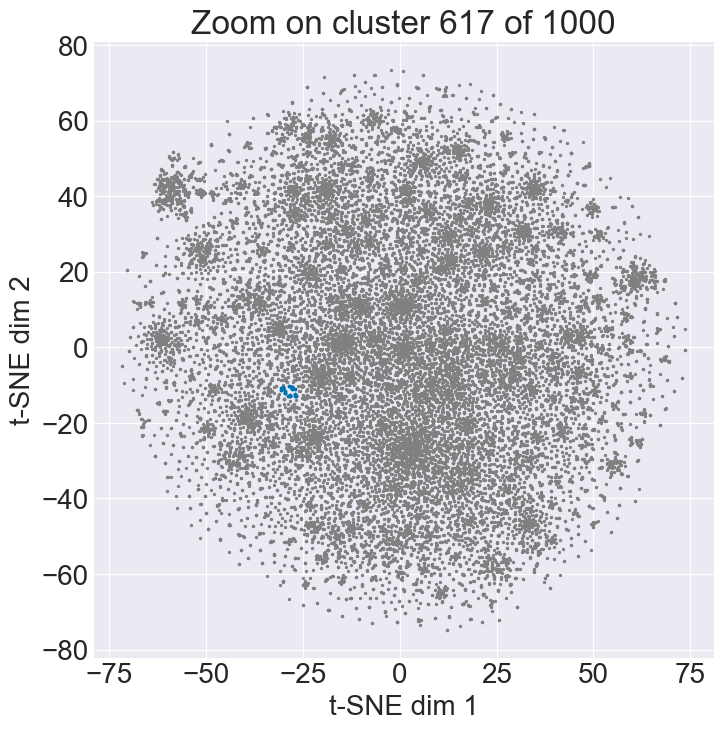

Cluster 617 (27 words):
package, names, moment, rinse, pile, sequence, squats, mow, kamossa, flowiest, coziest, untangling, pumping, stunningly, quarrel, improperly, swapping, bmw, 10am, ae, inverted, pkg, sparse, gort, confirming, limitless, patterning …


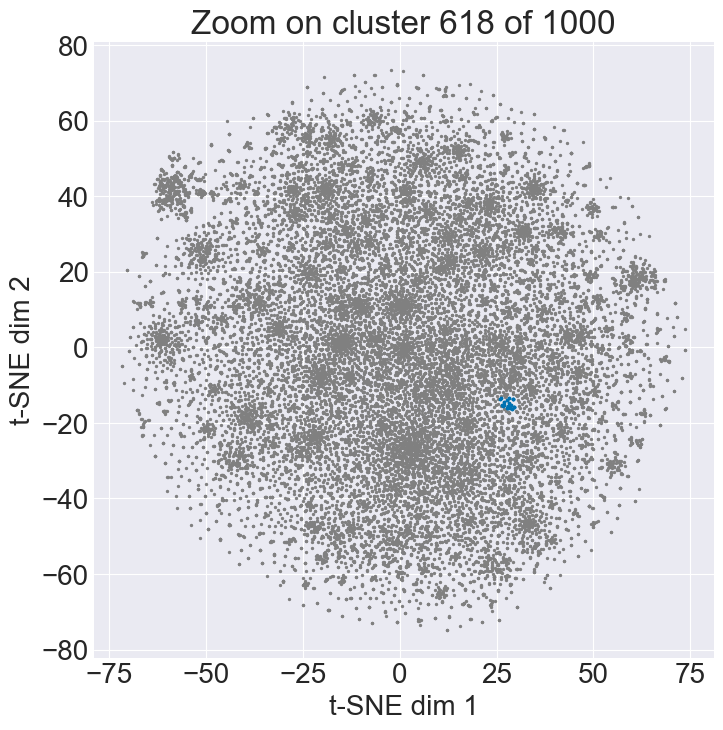

Cluster 618 (25 words):
securely, well, tightly, comfortably, nicely, poorly, obvious, snugly, noticeable, beautifully, bunches, neatly, wonderfully, attractively, shapely, solidly, evenly, superbly, bunched, appropriately, sturdily, decently, weirdly, excellently, crotchet …


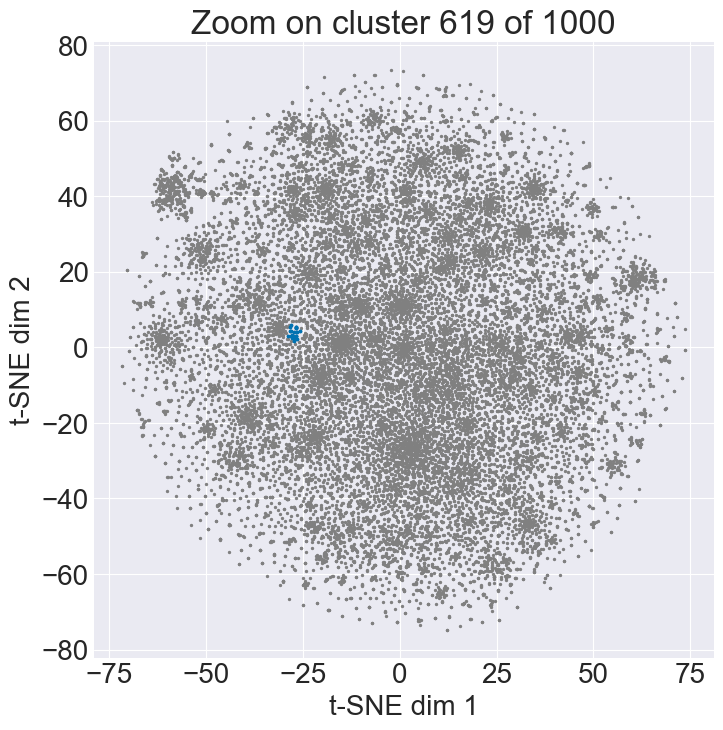

Cluster 619 (25 words):
styled, style, flower, version, classic, type, jean, timeless, denim, silhouette, modern, country, designer, utility, particular, owl, series, inin, antique, western, hi, strapped, aztec, category, jeggins …


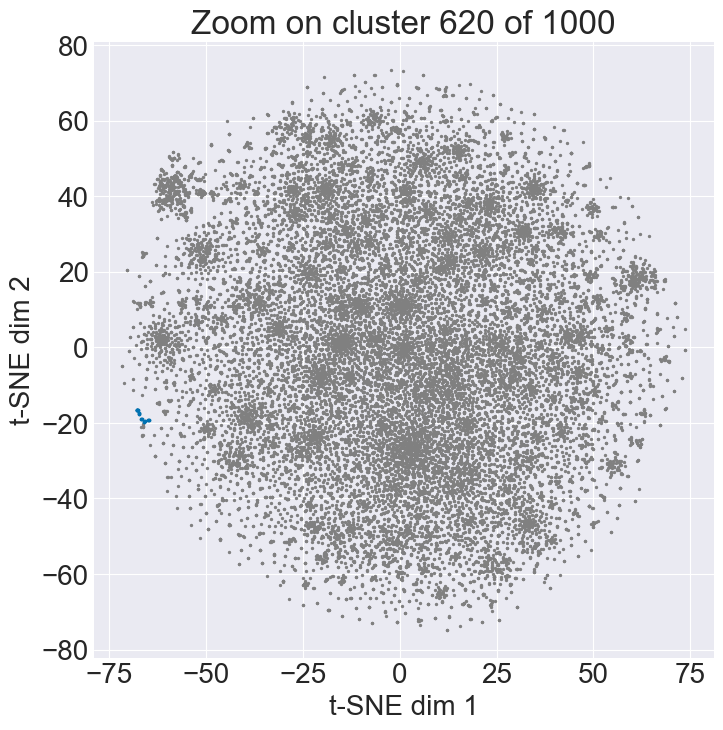

Cluster 620 (12 words):
prevented, drives, drove, entail, procrastinated, incase, annoy, forces, killed, compel, werar, debate …


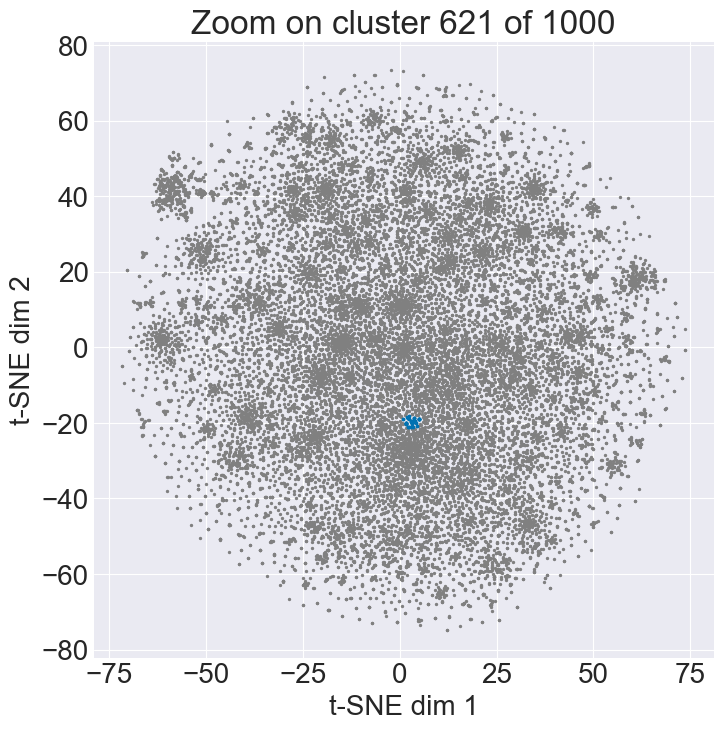

Cluster 621 (32 words):
of, for, extra, additional, true, amount, home, yard, security, causing, causes, mic, withstand, resort, providing, timing, crossed, among, operation, scissors, ruined, language, showcases, leftover, specially, dor, aop, truer, knocks, toque, public', toughest …


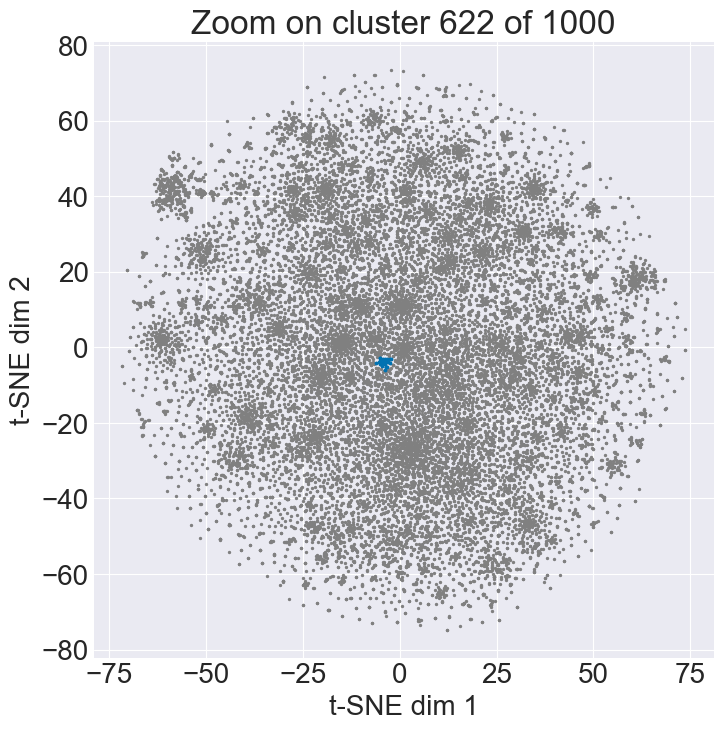

Cluster 622 (30 words):
enhanced, coolers, rubbed, bite, loom, splotch, tongue, pga, denote, wizards, tire, smears, flawed, slashes, beading, bubbling, unhemmed, shooters, brooks, blasted, fisherman, ferigno, rowing, haines, bathtub, commemorate, dimpled, vamp, getmyid, costumer …


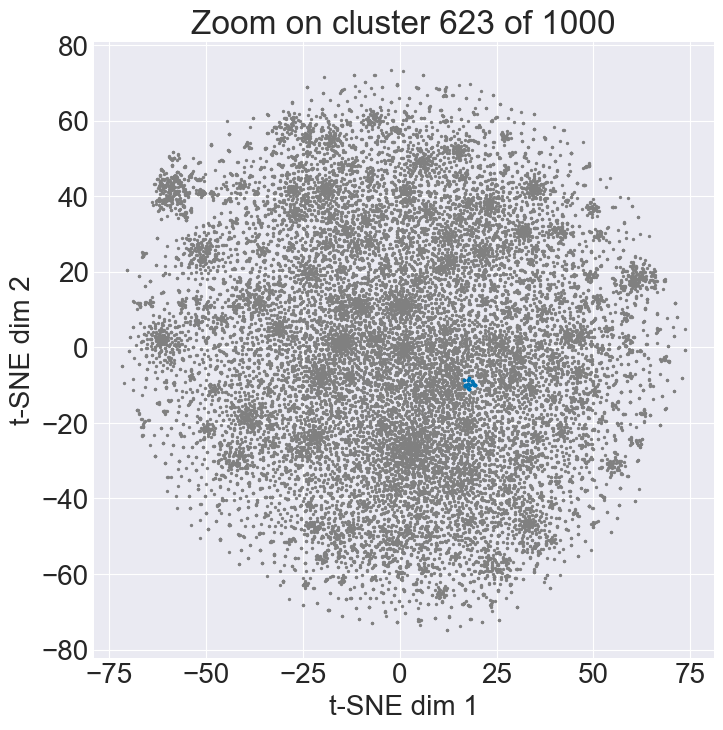

Cluster 623 (21 words):
adjustable, removable, storage, overlap, zippered, features, layer, generous, liner, threaded, compartments, organization, divided, finishing, sections, shortened, slots, dimensional, detachable, artificial, overlock …


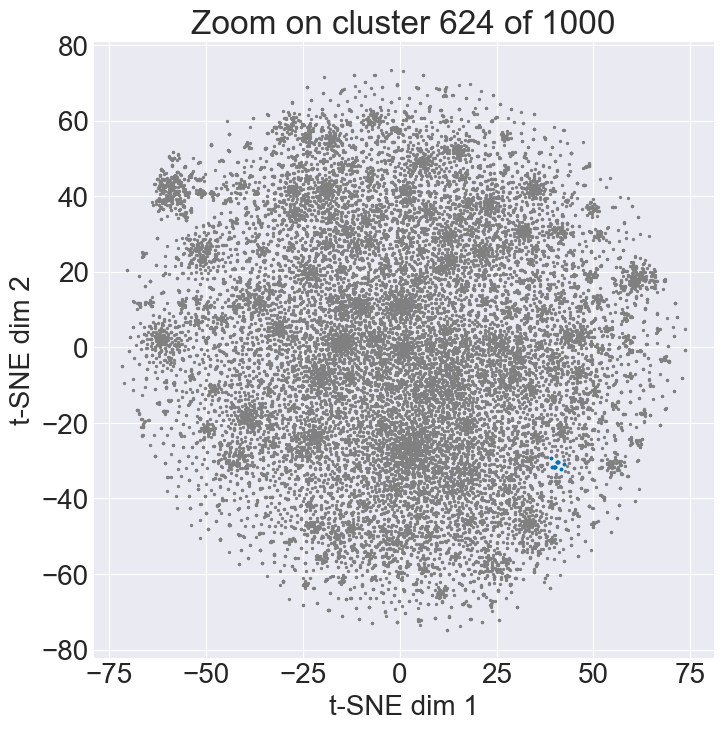

Cluster 624 (12 words):
repel, recurrence, wrestling, adapts, eggbeater, ladden, finagling, princes, mlm, e1aa76b2538353f624d31dc701ba1931, toll, snipers …


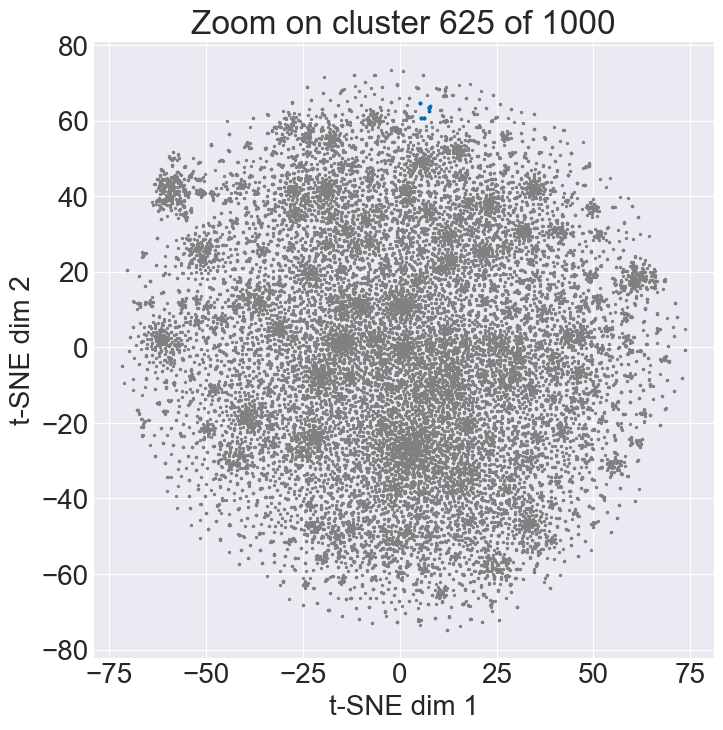

Cluster 625 (11 words):
fan, pilates, tos, lover, 33x36, 188lb, bearer, barre, and143lbs, steady, leverage …


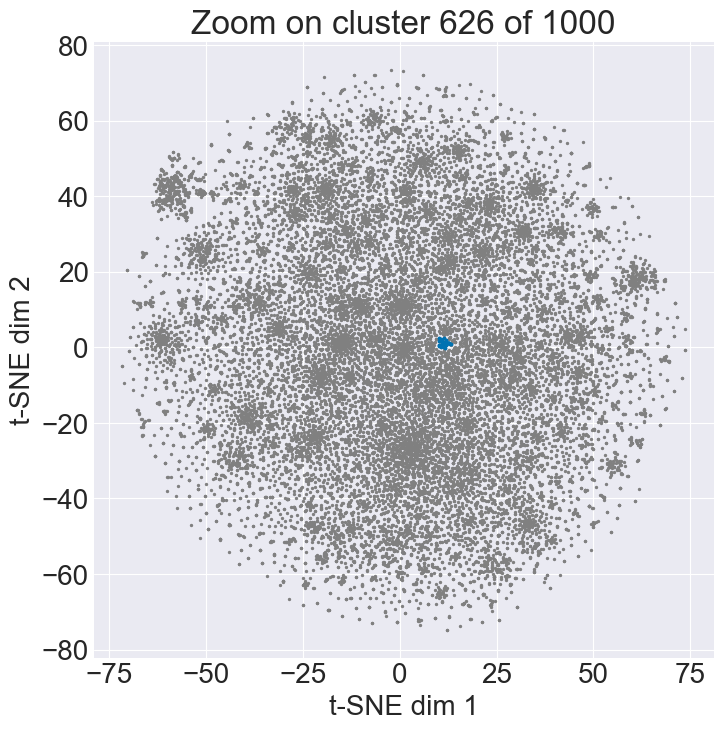

Cluster 626 (31 words):
locket, watch, heart, necklace, bracelet, stone, ring, bead, lanyard, choker, fob, clock, power, word, charm, script, pendant, anklet, wristband, message, butterfly, buddha, digital, watchband, ouch, requiring, carabiner, pendent, centerpiece, analog, veil …


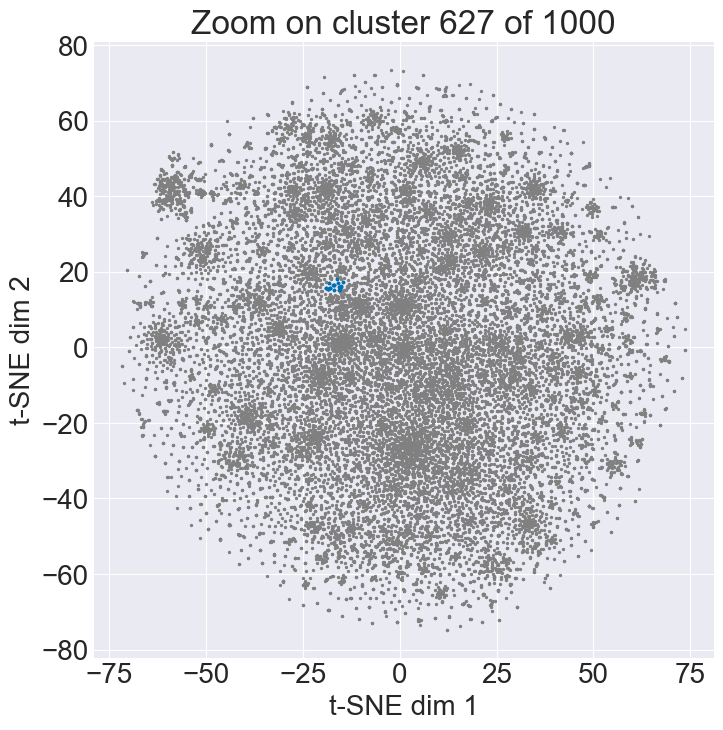

Cluster 627 (21 words):
vibrant, coordinates, vivid, fluorescent, glittering, pc, sinister, chili, pepper, extract, skiny, scattered, glares, restores, packets, 00mm, kap, swirly, healthier, coles, shoyu …


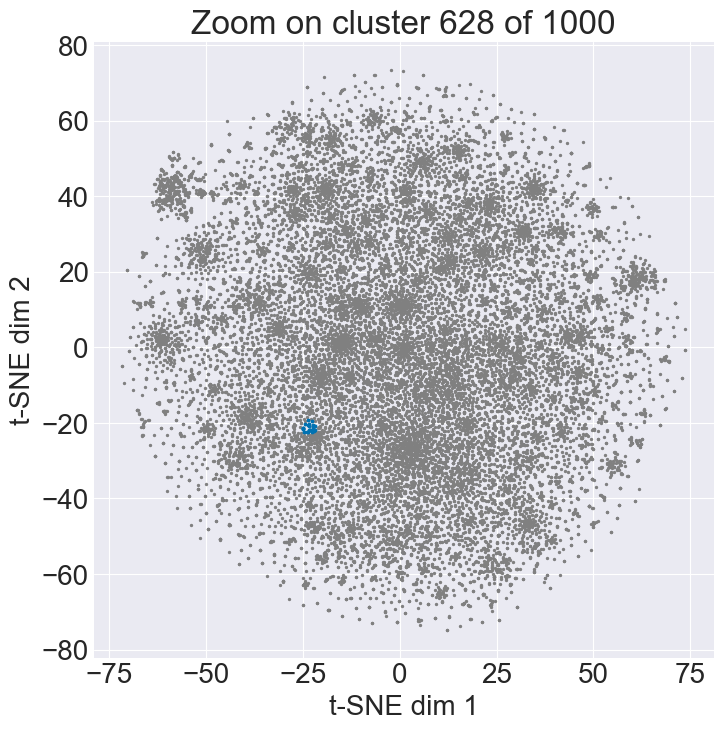

Cluster 628 (24 words):
ava, industrial, angles, tiffanys, wording, detached, rearview, stinging, 80s, escaping, galaxies, thorns, spades, ks, ponies, paws, slowest, submerged, paydirt, feminist, quay, unsewed, bathingsuits, flatfooted …


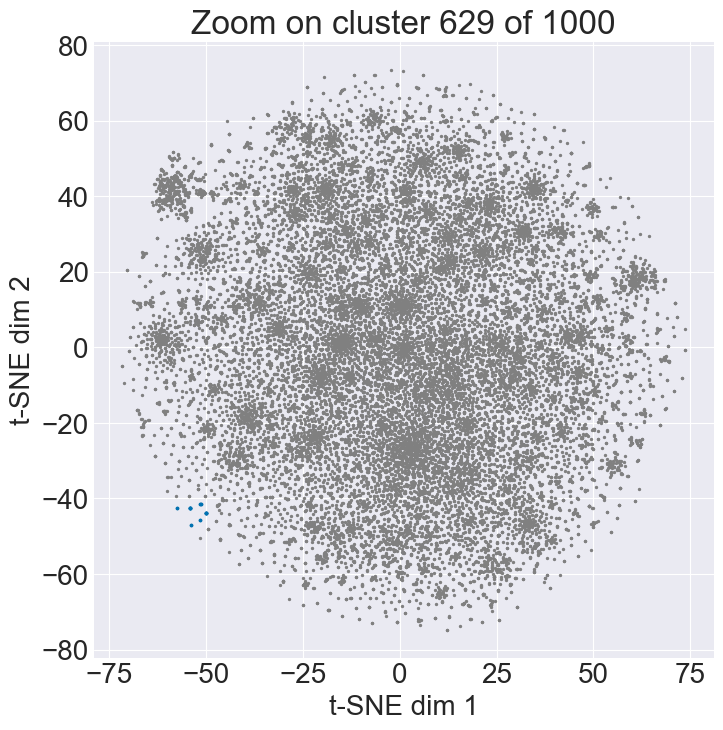

Cluster 629 (11 words):
bucks, peeking, kk, x2, dollars, oval, flame, geometric, badass, fireball, stormtrooper …


In [61]:
for i in range (30):
    cluster_search = 600 + i

    # mask for points in that cluster
    mask = (labels == cluster_search)
    pts_all = word_tsne
    pts_cluster = word_tsne[mask]

    # compute bounding box of the cluster
    min_x, min_y = pts_cluster.min(axis=0)
    max_x, max_y = pts_cluster.max(axis=0)

    # add a little padding (5% of width/height)
    pad_x = (max_x - min_x) 
    pad_y = (max_y - min_y)

    xlim = (min_x - pad_x, max_x + pad_x)
    ylim = (min_y - pad_y, max_y + pad_y)

    # plot
    plt.figure(figsize=(8, 8))

    # 1) all points in light gray
    plt.scatter(pts_all[:, 0], pts_all[:, 1],
                c='gray', s=2, label='other clusters')

    # 2) this cluster in blue
    plt.scatter(pts_cluster[:, 0], pts_cluster[:, 1],
                c='C0', s=3, label=f'cluster {cluster_search}')

    # set limits to zoom
    # plt.xlim(*xlim)
    # plt.ylim(*ylim)

    plt.title(f'Zoom on cluster {cluster_search} of {k}')
    plt.xlabel('t-SNE dim 1')
    plt.ylabel('t-SNE dim 2')
    # plt.legend(markerscale=3)
    plt.show()

    # optional: print out the words in this cluster
    words_in_cluster = [ind2word[i] for i in np.where(mask)[0]]
    print(f"Cluster {cluster_search} ({len(words_in_cluster)} words):")
    print(", ".join(words_in_cluster[:50]), "…")


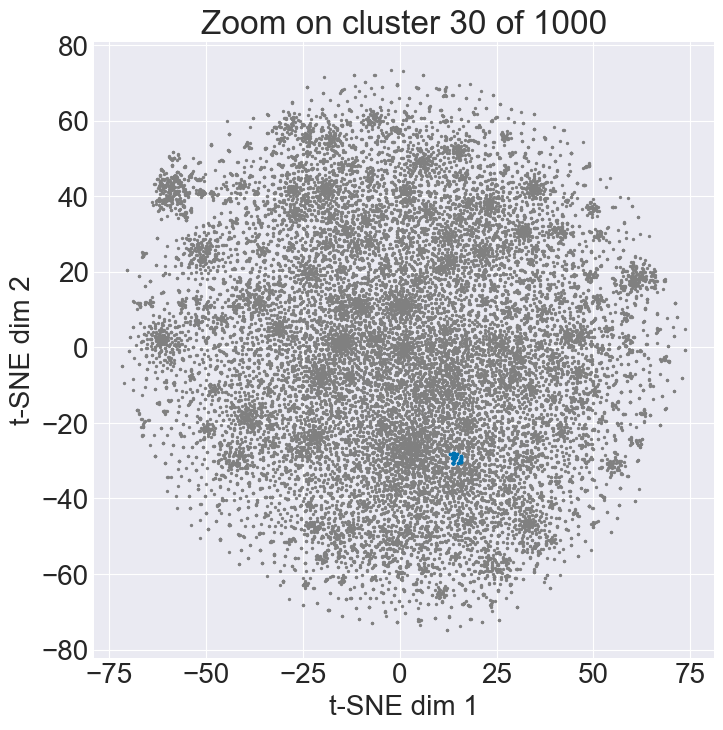

Cluster 30 (30 words):
stay, showed, showing, keep, prevent, shows, show, compliment, matched, stays, match, protects, keeps, save, stayed, hug, protect, kept, sheds, shrinks, mark, block, define, brighten, reveal, exist, blocks, complement, hugged, relieve …


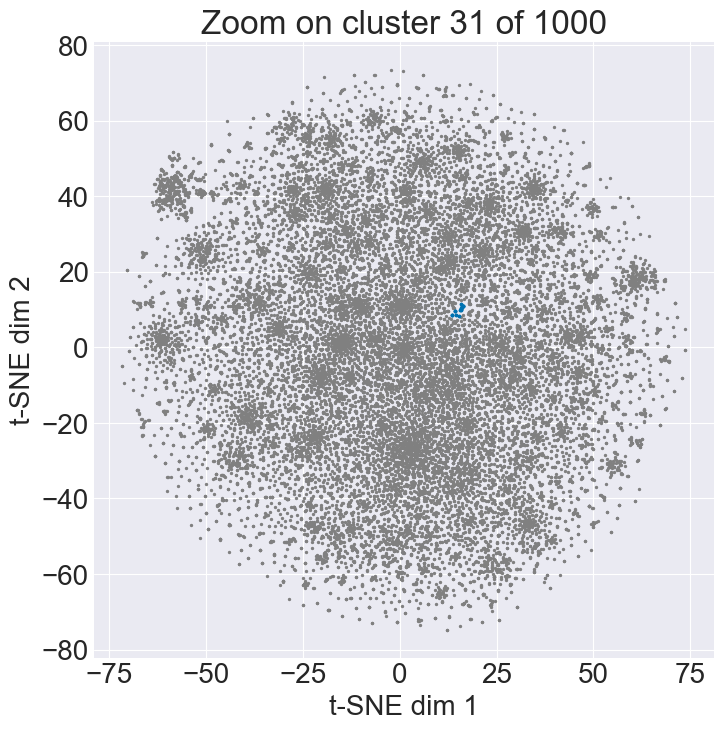

Cluster 31 (17 words):
phony, chovura, steamer, artwork, disastrous, patio, havanna, toggle, panfish, hogs, lacew, surger, 'air, force', dimples, voids, flown …


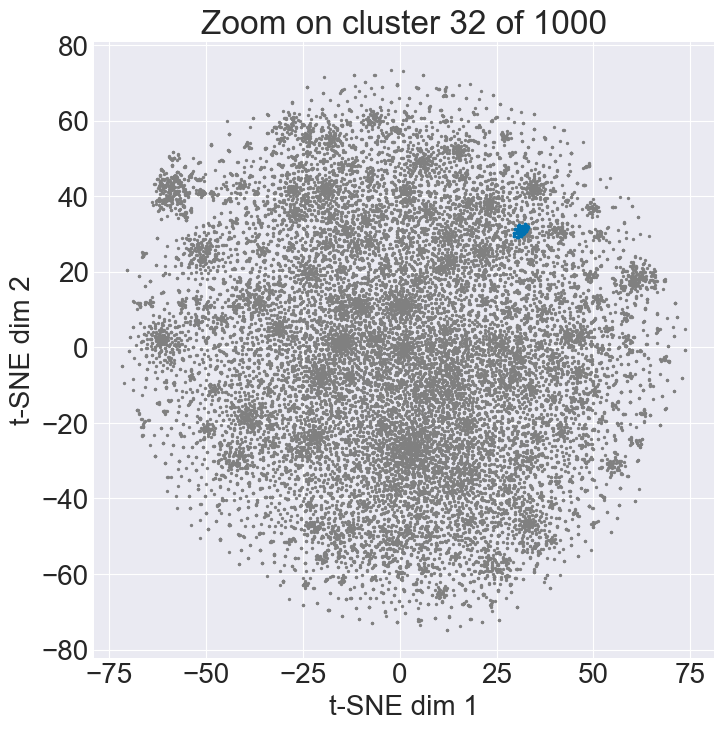

Cluster 32 (54 words):
silkey, visual, nod, salmon', 'run, melon, boost, stressful, chilli, glimmer, theatrical, cheeky, romantic, chunk, ketchum, immature, thumbnail, dim, underlining, moe, metro, lob, litter, freshly, tannned, corkscrew, awoke, climber, acted, cutter, shocks, harse, warped, macram, sacky, dressup, coaxing, pizzazz, ballie, hells, sparklies, motorized, stilish, recurve, funnt, clueless, risqué, mushroomish, guesswork, smail …


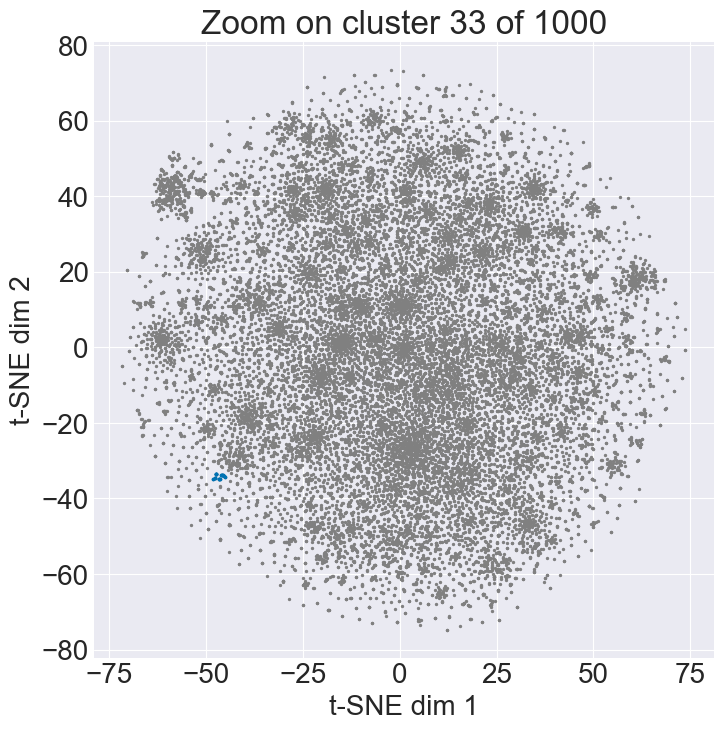

Cluster 33 (15 words):
shoreline, cutesies, toed, harm, sketcher, steve, madden, sprays, orthopedically, powders, etcetera, rite, scrapped, gowalk, afordable …


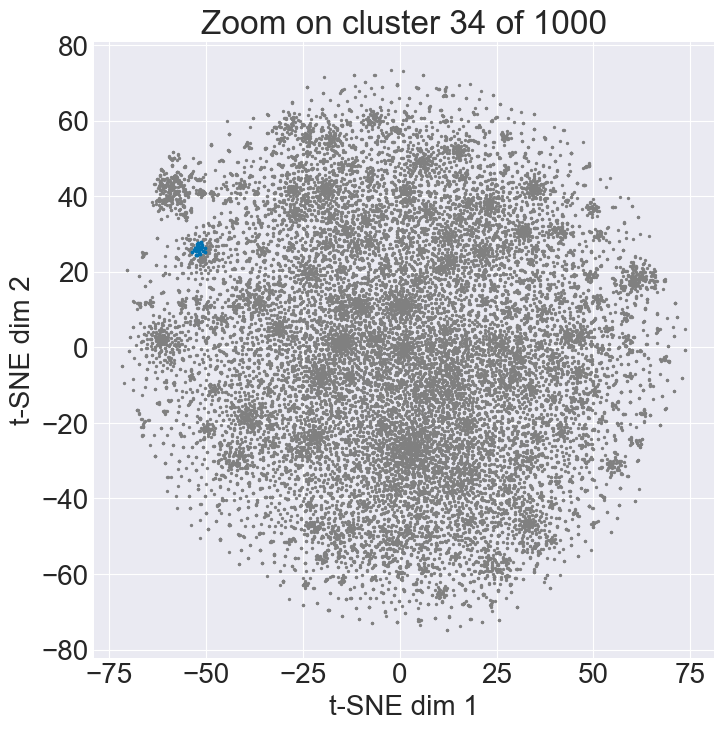

Cluster 34 (34 words):
connection, dings, frills, reveals, rollers, leaks, responses, locally, isues, markings, exhibition, aglets, muss, compunctions, itchies, chronographs, 'pouch', roughhousing, rhyme, 's, uh, puns, chopsticks, clumsiness, droppers, envies, 'just, 'rolls', indications, whiskering, beiges, squeaking, incorporates, unaboob …


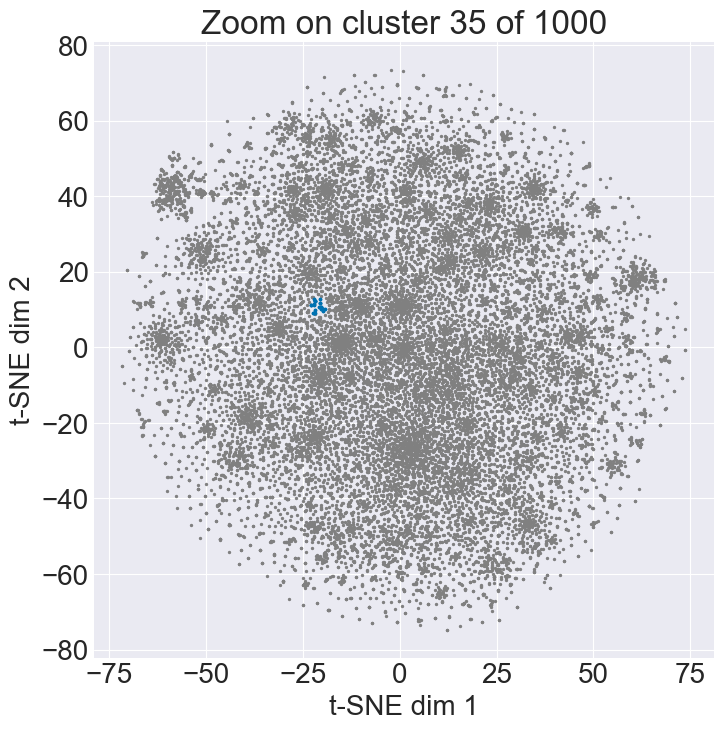

Cluster 35 (26 words):
continuous, market, humidity, rainbow, east, realwe, helper, cowrie, cowie, north, rimmed, s925, imperfection, radiant, nanny, nina, beaitiful, stalled, saks, untreated, dhnewsun, pictue, borden, stainlesssteel, simone, 11mm …


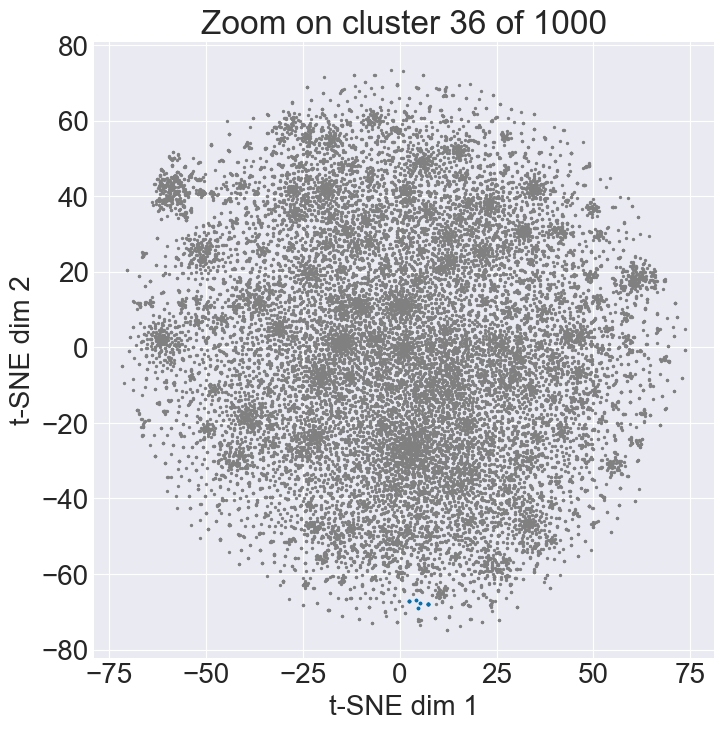

Cluster 36 (8 words):
share, represent, yall, chanting, pathetic, mon, tues, weds …


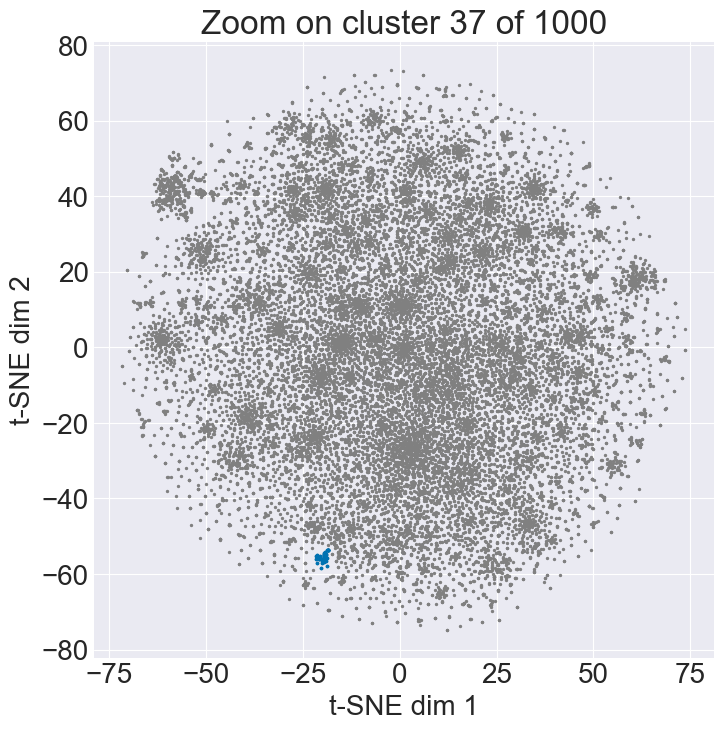

Cluster 37 (43 words):
samantha, blindly, smokin', pilly, chafed, frustrated, 578b5f630b7b862a70c8c904e40a8991, 49a87ff36319e0c99baf36090a4ce0fa, lonely, spooked, 4125afc74d71fc45cd0f5c905293f16d, 20g, badboy, hehe, 7tall, dementia, consequently, progressively, alyassa, sleepers, raine, kawaii, gif, filthy, 36f, molding, earcuff, undercoat, paypal, d51ffa669ad597416917dd04f27afc7c, 8f808e5b30cc90aed2097be233f17eeb, denied, thicc, introduced, kicker, disgustingly, chinchilla, resolves, sz5, rind, vice, rejected, redwine …


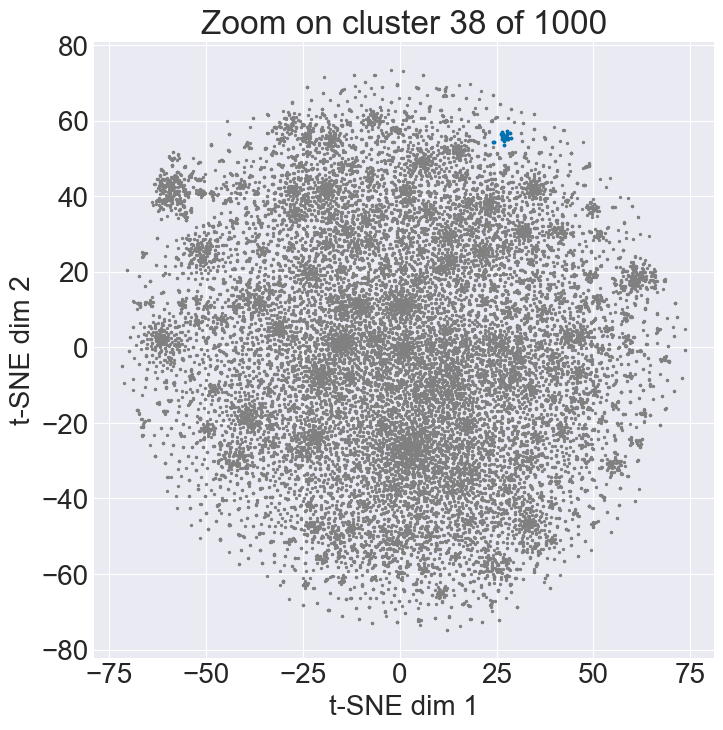

Cluster 38 (29 words):
nuisance, hangar, glaring, substitute, kindness, emeralds, carton, 10pt, celines, taco, nut, pith, saddleback, nonexistent, snugglefest, uns, getter, looker, veyron, stinker, participating, prettily, constellation, rattling, friggen, watchmakers, a959e4283f9aa957aca784fd4c56d7c1, brazil, disapointment …


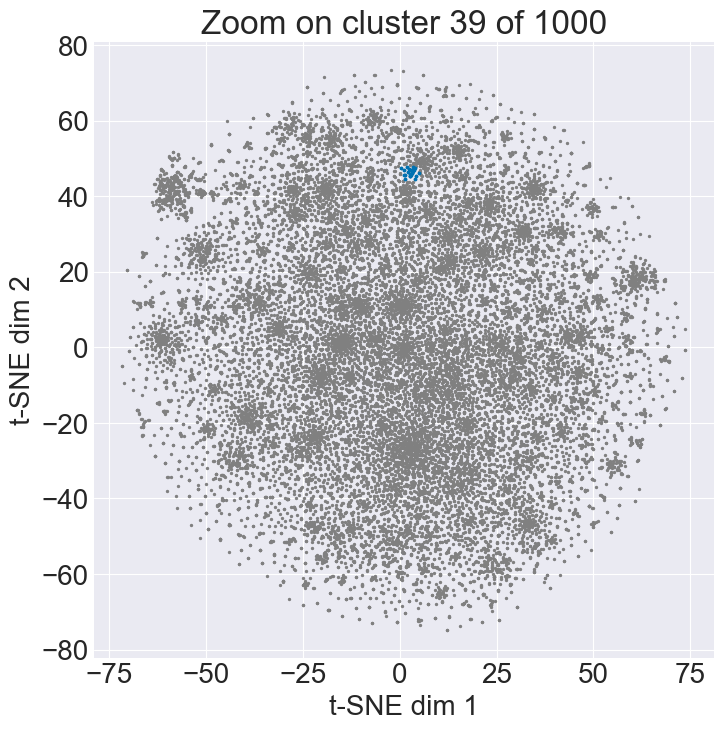

Cluster 39 (22 words):
heights, goth, hotel, explored, toting, offgas, receptionists, dinners, daring, photoshoot, petites, flexfit, likeness, lifesaver, bahamas, folders, 25f, valentines', whoevers, picnic, fol, catwoman …


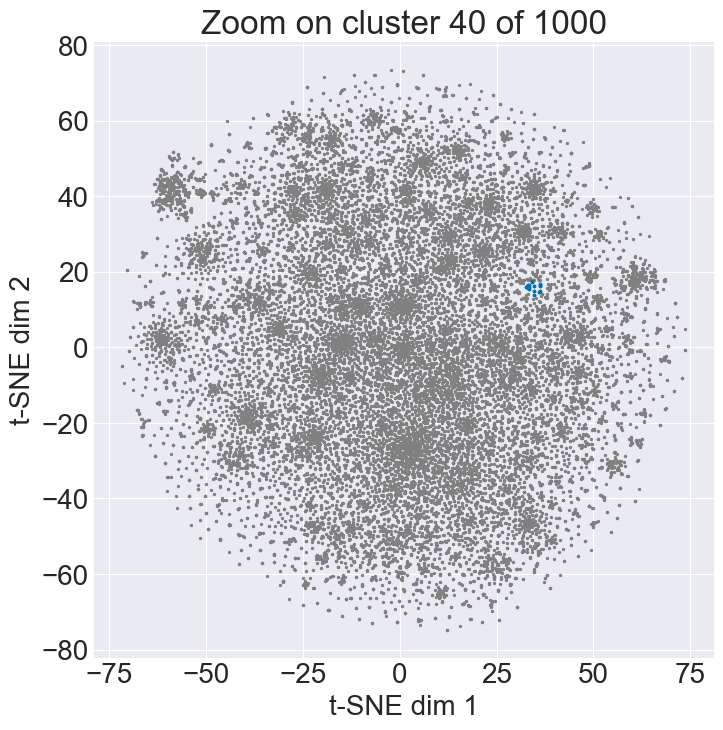

Cluster 40 (18 words):
ood, application, hell', fears, disproportionate, dosnt, chapsticks, role, narrator, bery, posh, greata, ter, sanctioned, wasit, 113lbs, definetely, threally …


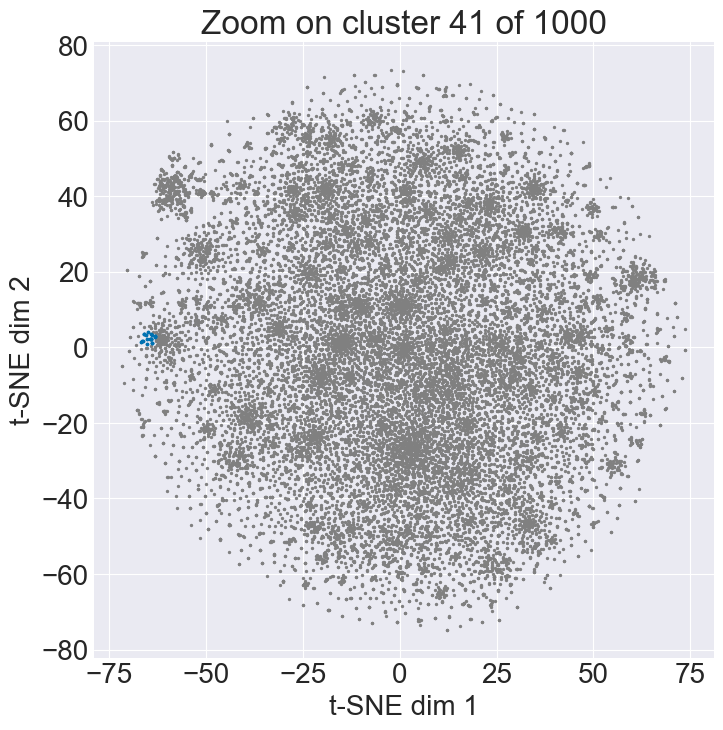

Cluster 41 (20 words):
dave, unwanted, phew, weeee, edited, phoney, shockingly, handlebar, yupf, handsomely, thoughtfully, subliminal, messaging, jodhpurs, brandy, convienent, theyrenotgonnaknow, takenotes, summarize, ihope …


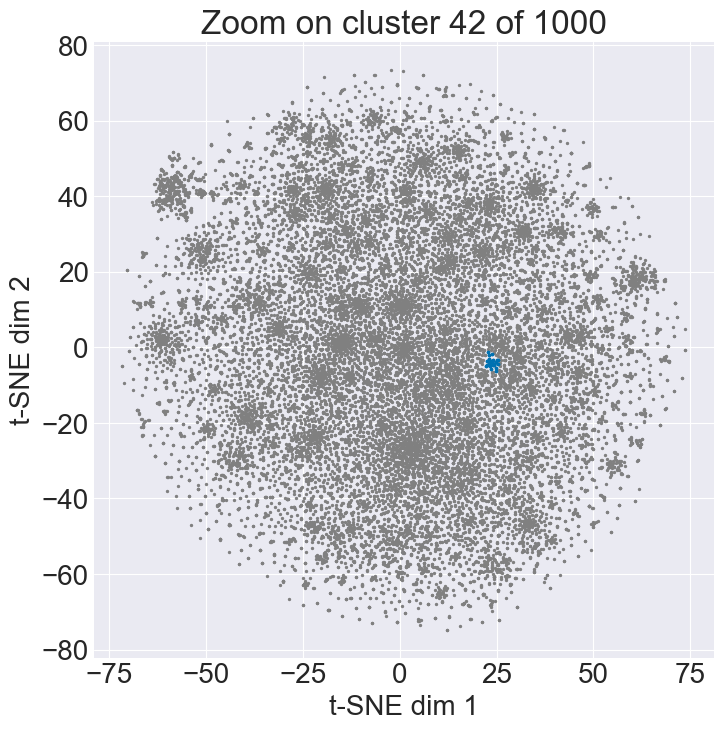

Cluster 42 (31 words):
material, fabric, function, weight, wrinkles, lining, texture, thickness, lettering, fabrics, generously, yarn, appearance, combo, control, brushed, bulk, level, balance, craftmanship, absorbent, micro, lacy, circulation, gathers, rouching, fabrication, wrinkling, underlayer, outsole, materiel …


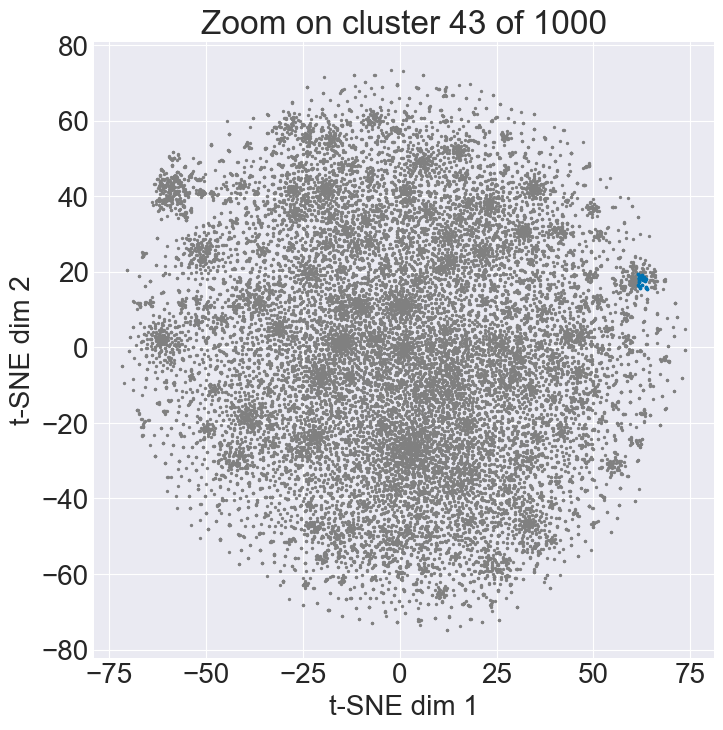

Cluster 43 (27 words):
weigh, weighing, 115lb, 175lbs, 95lbs, 117ish, 40c, 190lbs, 110lbs, 155lbs, weighed, 160lbs, 140ish, 143ish, 42d, 4ft, 125lb, 5foot, 145pounds, 150ish, 30ddd, is13, 127lbs, aprox, 30dd, 120lb, 15o …


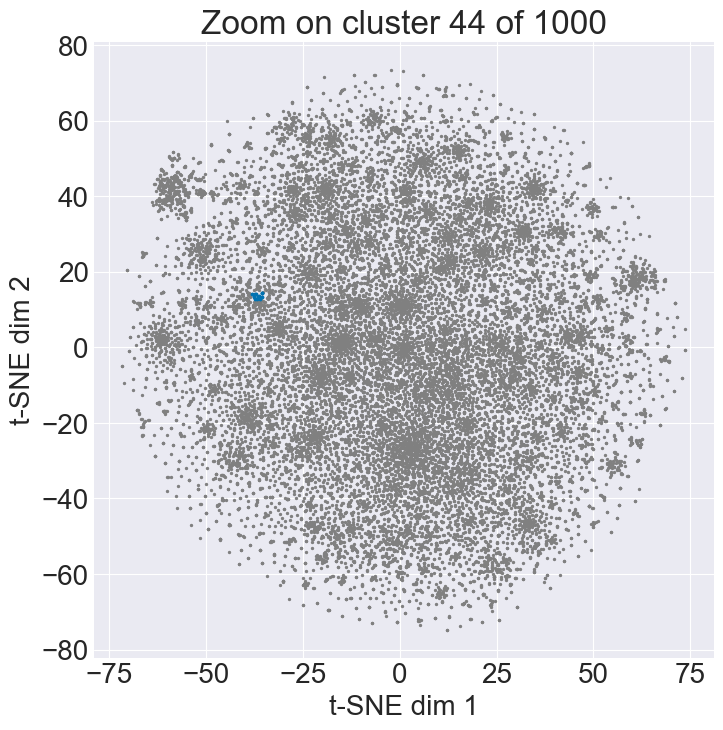

Cluster 44 (14 words):
tech, acquisition, dealer, danedvi, genhoo, halova, wagner, mirramor, gymnast, mealguet, sharpness, transcends, qill, hynes …


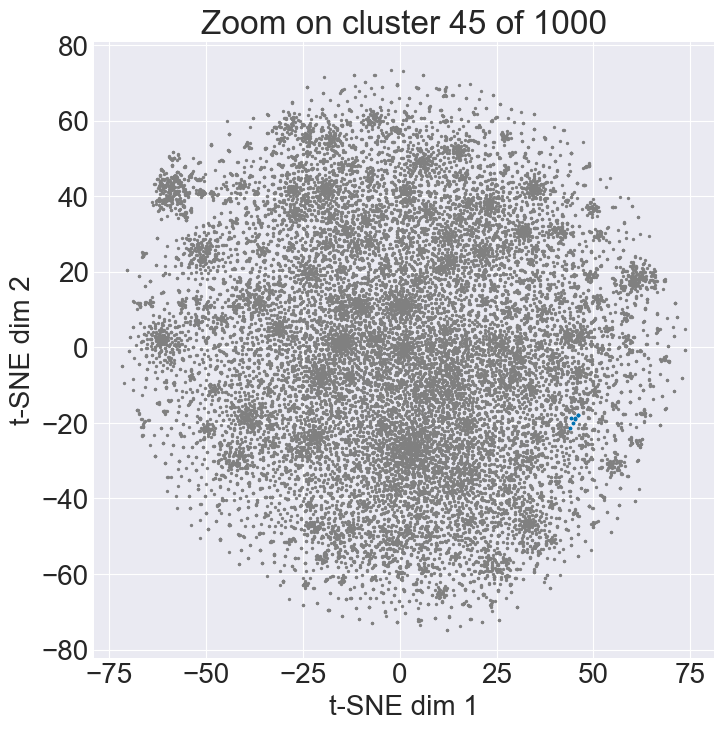

Cluster 45 (7 words):
cherries, reindeer, nonprofits, annoyingly, unwearably, narrowly, magically …


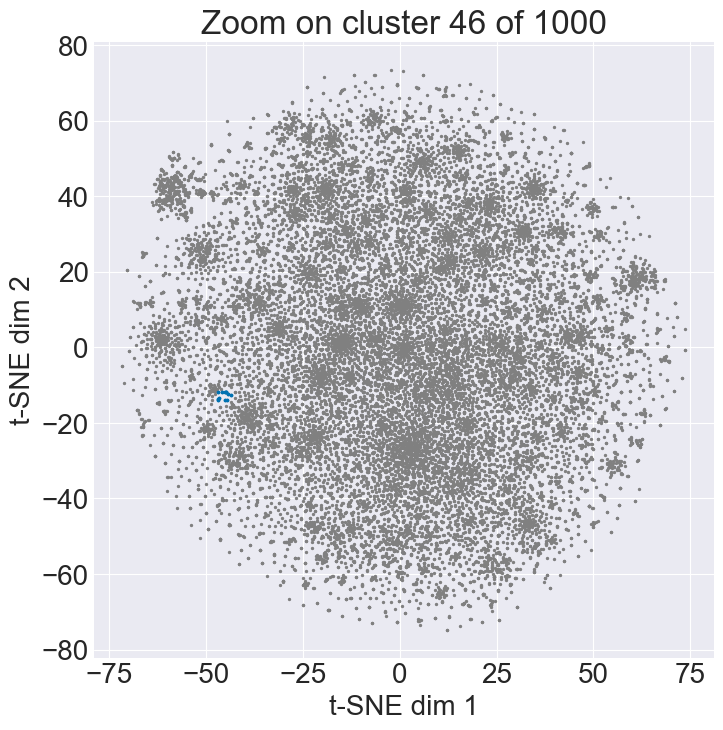

Cluster 46 (12 words):
mens, womens, sz, babydoll, adidas, nike, stride, size10, us12, euro, chloe, 8y …


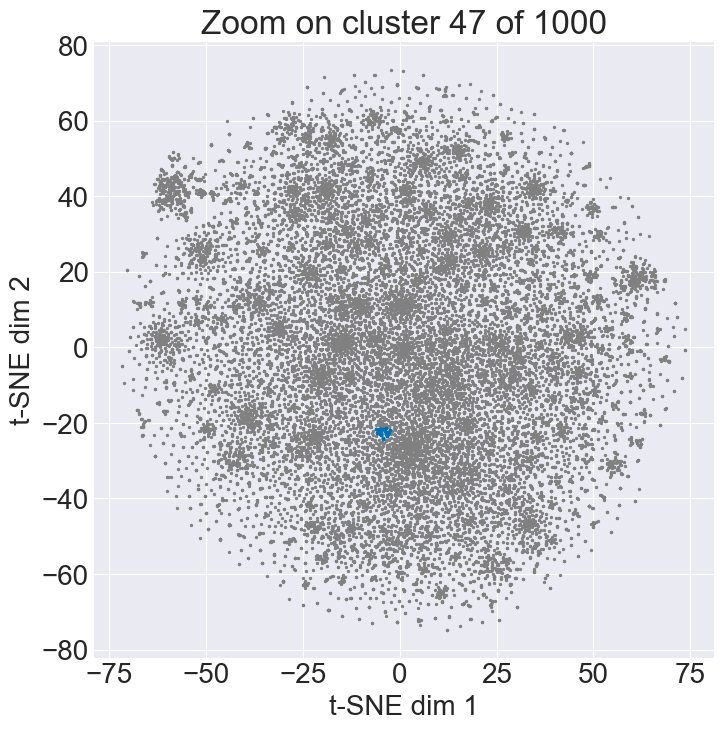

Cluster 47 (30 words):
perfectly, ok, good, reasonable, bad, limited, poor, awful, fine, terrible, okay, specific, decent, adequate, intended, alright, horrible, meh, hey, moderately, acceptable, physique, calculate, mega, inconsistent, intact, outrageous, entertainment, errors, excellence …


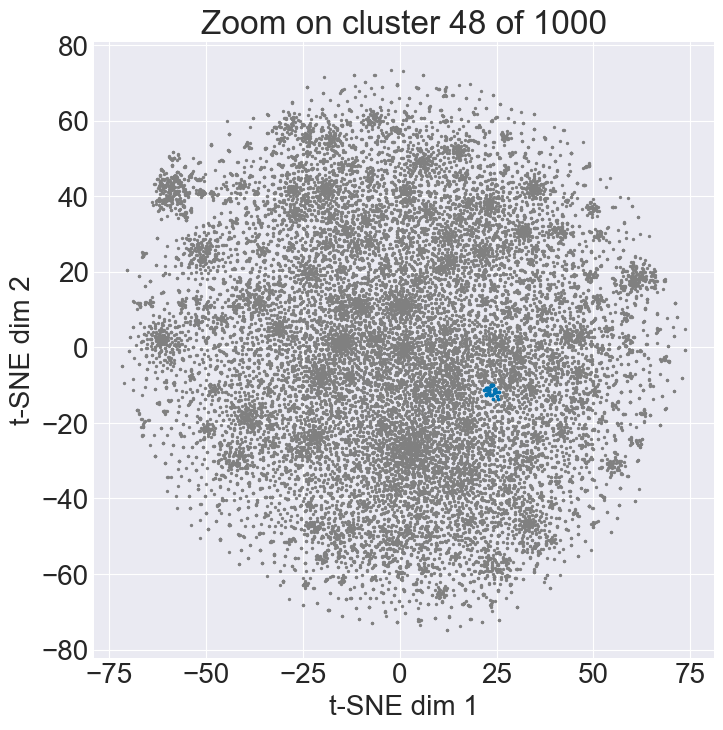

Cluster 48 (34 words):
small, big, long, large, short, oddly, shot, tiny, busty, crooked, petite, surprising, square, chubby, fat, attracts, reversible, huge, bling, slender, referring, pillow, wavy, painful, sponge, gather, smallish, cone, plunging, clumsy, squashed, wigs, oncw, apocalypse …


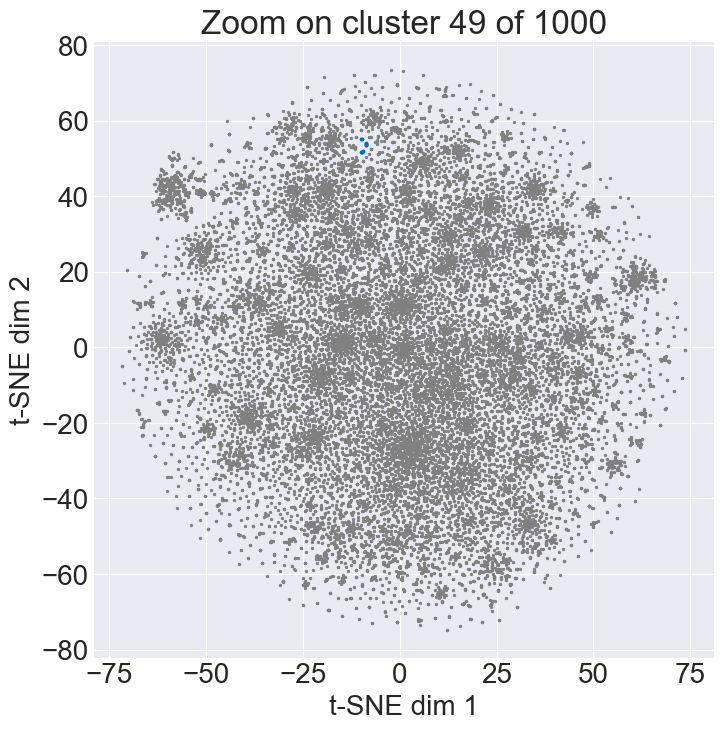

Cluster 49 (10 words):
crafting, experirncing, charitable, donations, akula, boomer, subs, kindergarten, classroom, notoriously …


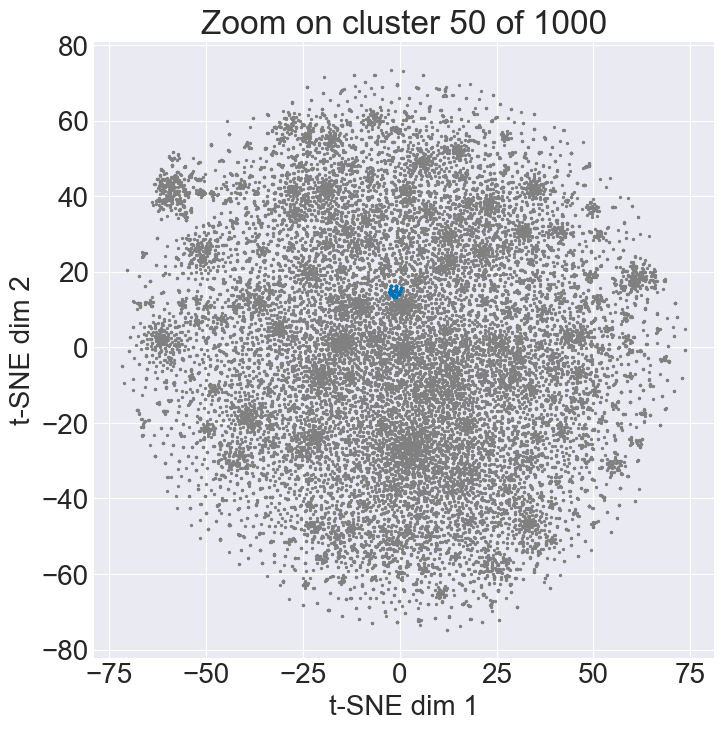

Cluster 50 (32 words):
range, sheerness, esthetics, integrity, blades, 1920s, incorrect, biceps, burberry, louis, pelle, companys, perception, outdorsy, stile, afunta, tilley, automatics, rap, inaccuracy, caliber, comfiness, arrangement, cus, jovivi, weightlessness, validity, trimester, cajun, 1800's, underneth, plackets …


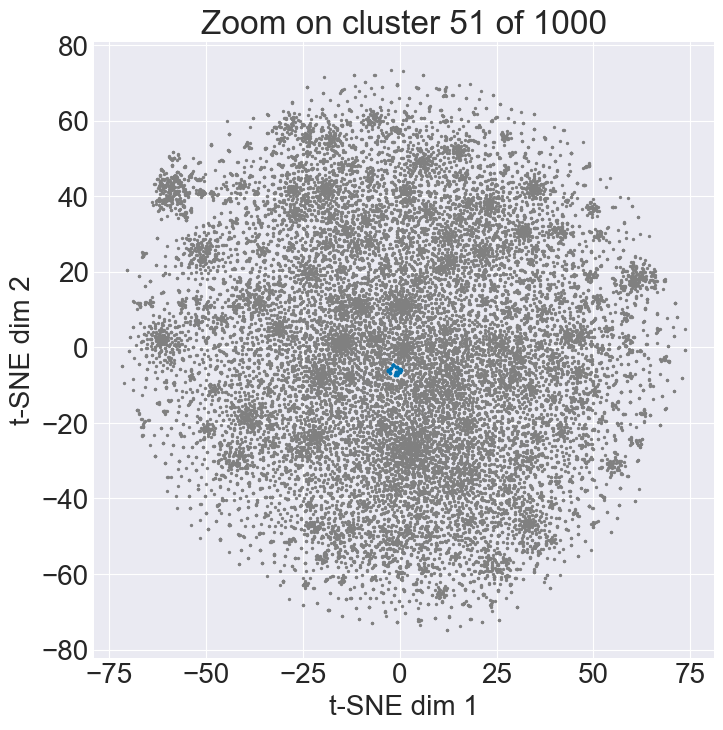

Cluster 51 (27 words):
stoppers, sandels, elevates, sleezy, slobby, 'plus, mattress, sol, flames, thins, invisibly, bolts, eazy, lava, affortable, leus, 'granny', petal, garuda, hourly, chime, seahorse, achieves, cristal, conical, stingers, macaroons …


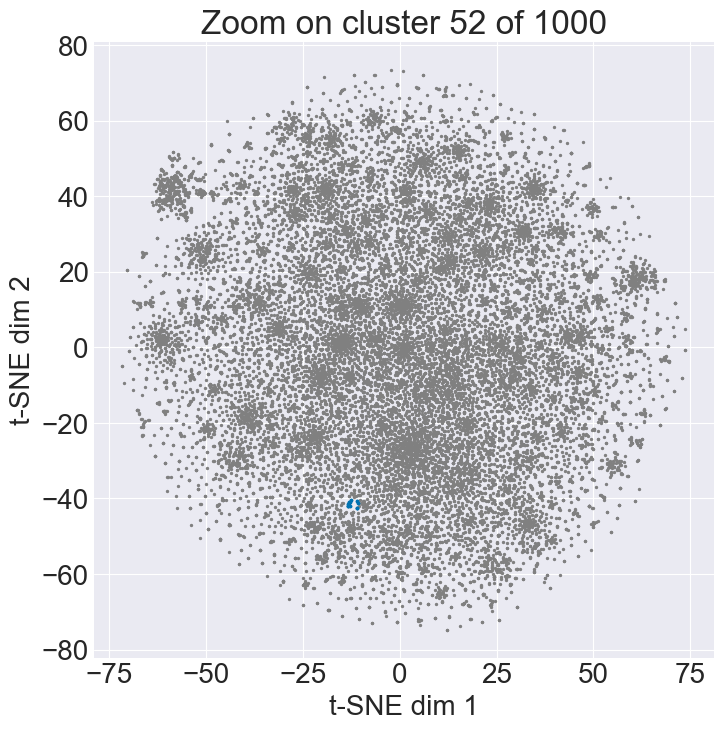

Cluster 52 (12 words):
stats, a8, chords, bomb, appearances, ambiguous, anyhow, artistry, declined, 7a3b5400931b64348bcef9cc0318b1e5, ike, communition …


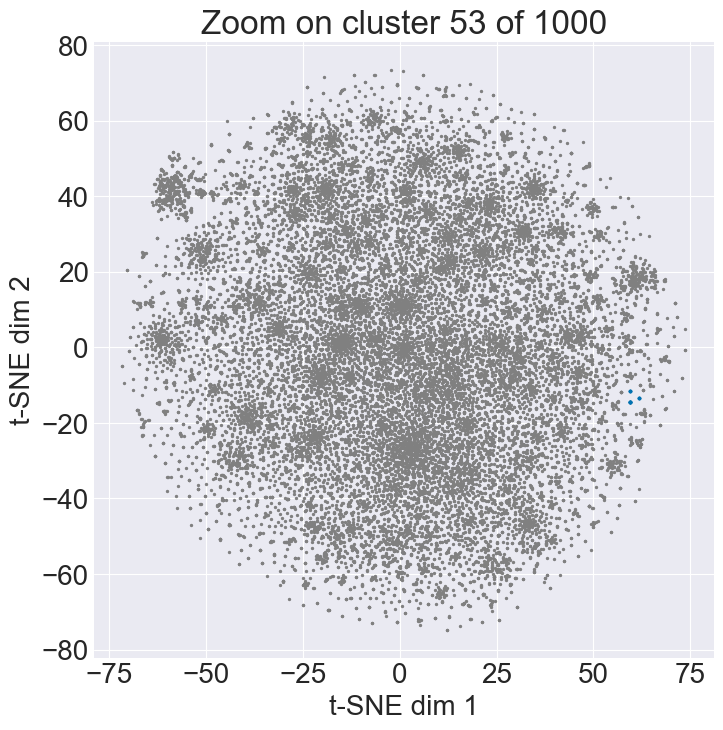

Cluster 53 (8 words):
unacoo, fiting, plunges, serging, scrubbers, ms, pima, frankenstien …


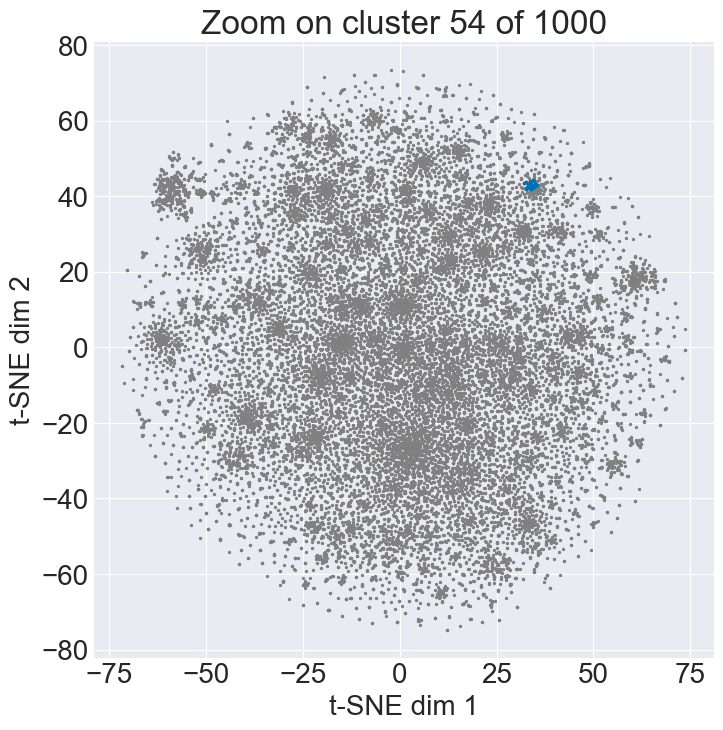

Cluster 54 (29 words):
princess, canvass, tinsel, lycra, dream, magicians, mumu, yoke, glorified, yachting, negligee, rat, freight, puzzle, sixth, diesel, cowhand, carnation, chippendale, chihuahua, torsod, cave, freak, rolex, pringles, ironman, prarie, thinish, guldens …


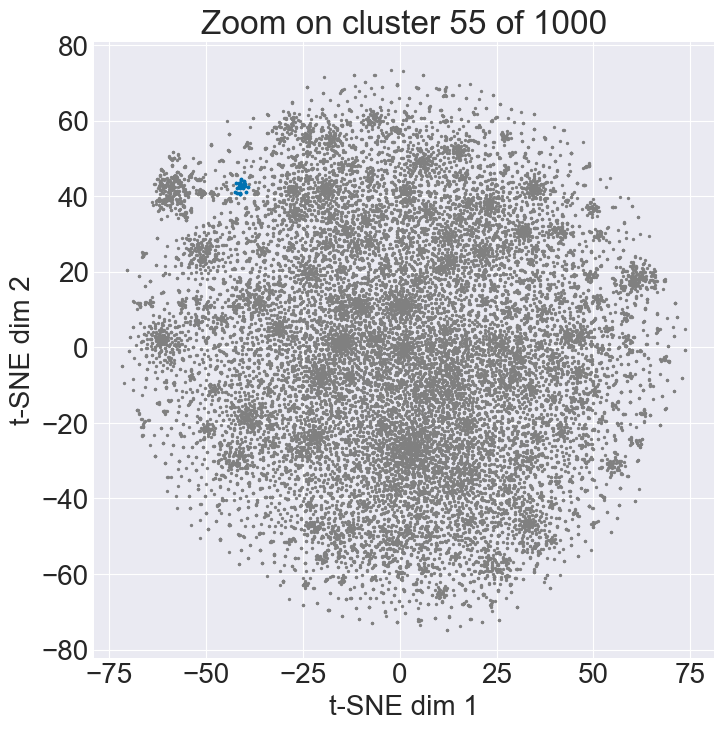

Cluster 55 (29 words):
unknown, battle, bumming, confuse, bug, puzzles, kees, unuseable, unsuitable, shirt', blizzard, impress, surprises, sauna, glitzy, spoken, rob, antsy, 11n, adn, throwaway, ultras, 32g, conducting, fuse, relevant, cutesy, otaku, clevage …


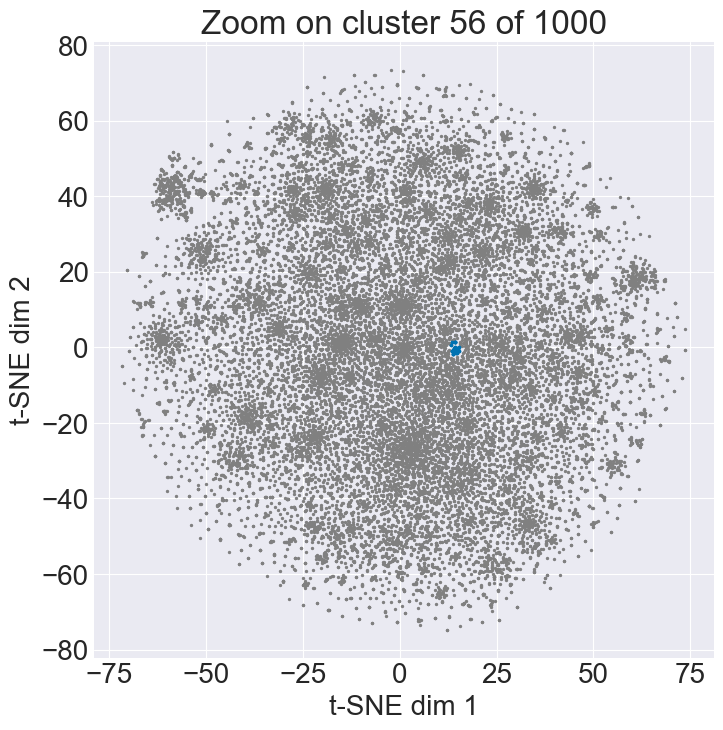

Cluster 56 (27 words):
stones, flowers, beads, glass, rhinestone, pearls, glitter, crystals, hearts, contents, sequins, feathers, tassels, rhinestones, diamonds, crystal, gems, jewels, halo, sparkling, czs, controls, fuzz, offs, opal, statements, shields …


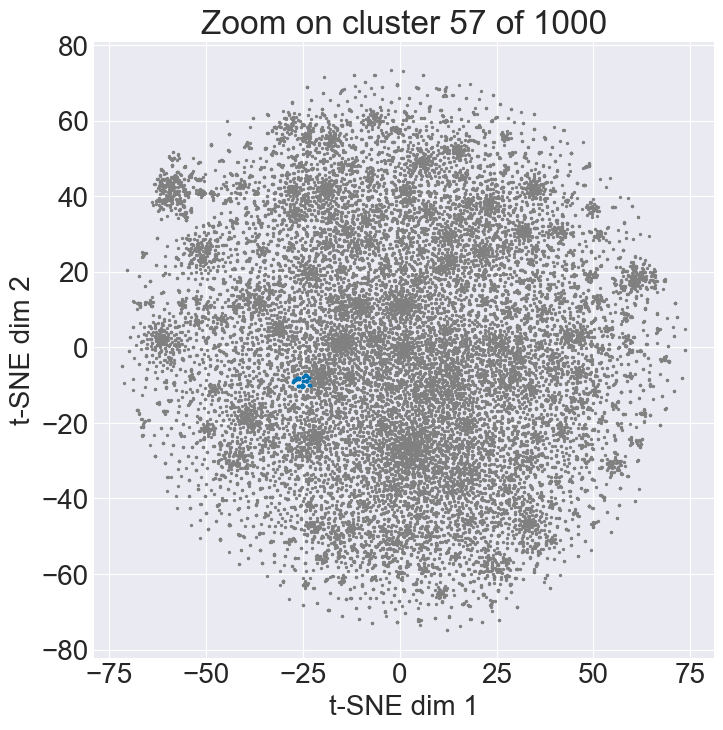

Cluster 57 (33 words):
max, beatiful, exam, scrapes, connectors, 'children, free', wedgie, ofter, lifts, billowing, moons, smudges, mastermind, ponytails, method, breathy, joey, bullet, replaceable, dds, handgun, trucks, kneecap, nightmares, 'off, meats, 18x18, tut, 'hides', ying, 32aa, attendees …


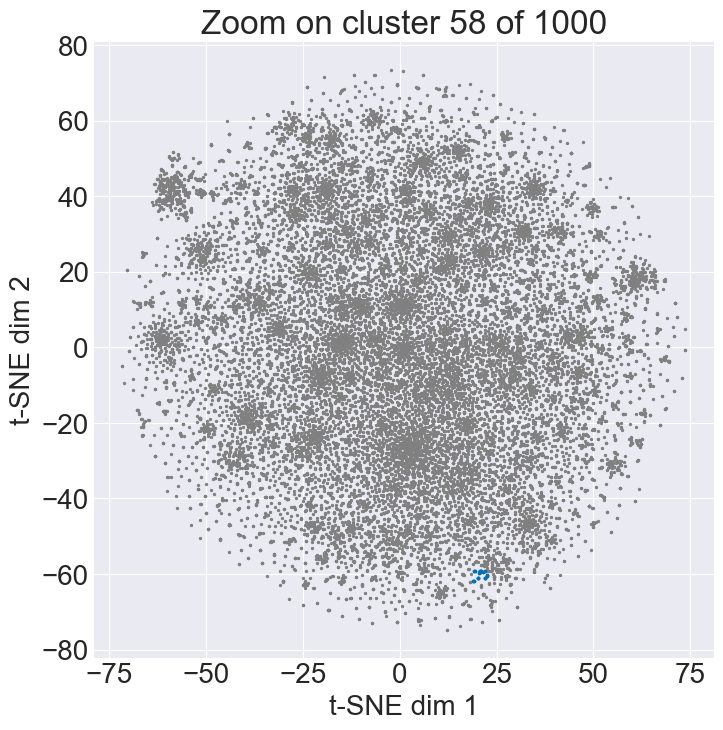

Cluster 58 (19 words):
yesss, marilyn, miracles, celebri, twit, stockier, zenni, firearm, arrest, stabilicers, cleat, nickname, suffocate, softshell, w223, na, wayfairers, cheat, transform …


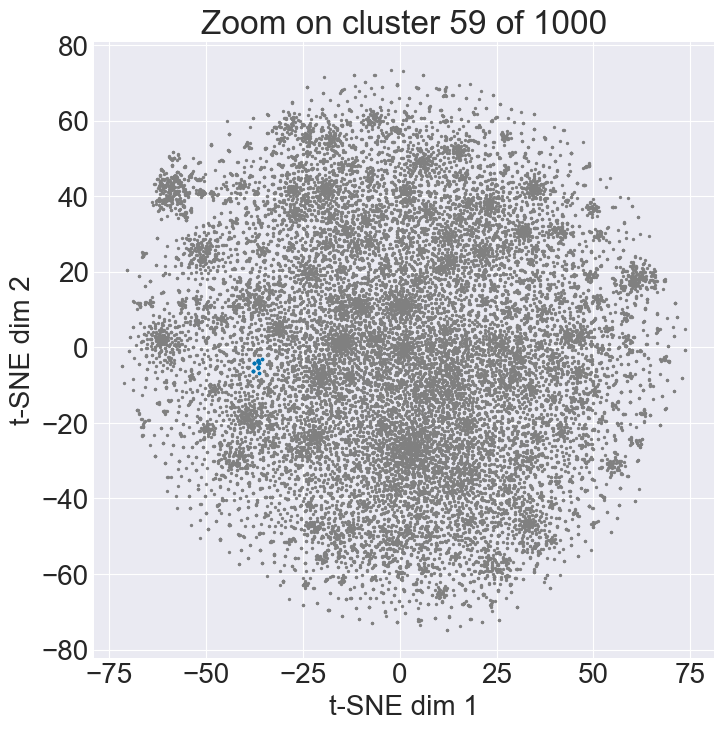

Cluster 59 (16 words):
she, shes, he, desire, anyone, hes, someone, everyone, hers, underwire, daddy, mickey, frustrates, consumers, hubs, gilded …


In [62]:
for i in range (30):
    cluster_search = 30 + i

    # mask for points in that cluster
    mask = (labels == cluster_search)
    pts_all = word_tsne
    pts_cluster = word_tsne[mask]

    # compute bounding box of the cluster
    min_x, min_y = pts_cluster.min(axis=0)
    max_x, max_y = pts_cluster.max(axis=0)

    # add a little padding (5% of width/height)
    pad_x = (max_x - min_x) 
    pad_y = (max_y - min_y)

    xlim = (min_x - pad_x, max_x + pad_x)
    ylim = (min_y - pad_y, max_y + pad_y)

    # plot
    plt.figure(figsize=(8, 8))

    # 1) all points in light gray
    plt.scatter(pts_all[:, 0], pts_all[:, 1],
                c='gray', s=2, label='other clusters')

    # 2) this cluster in blue
    plt.scatter(pts_cluster[:, 0], pts_cluster[:, 1],
                c='C0', s=3, label=f'cluster {cluster_search}')

    # set limits to zoom
    # plt.xlim(*xlim)
    # plt.ylim(*ylim)

    plt.title(f'Zoom on cluster {cluster_search} of {k}')
    plt.xlabel('t-SNE dim 1')
    plt.ylabel('t-SNE dim 2')
    # plt.legend(markerscale=3)
    plt.show()

    # optional: print out the words in this cluster
    words_in_cluster = [ind2word[i] for i in np.where(mask)[0]]
    print(f"Cluster {cluster_search} ({len(words_in_cluster)} words):")
    print(", ".join(words_in_cluster[:50]), "…")


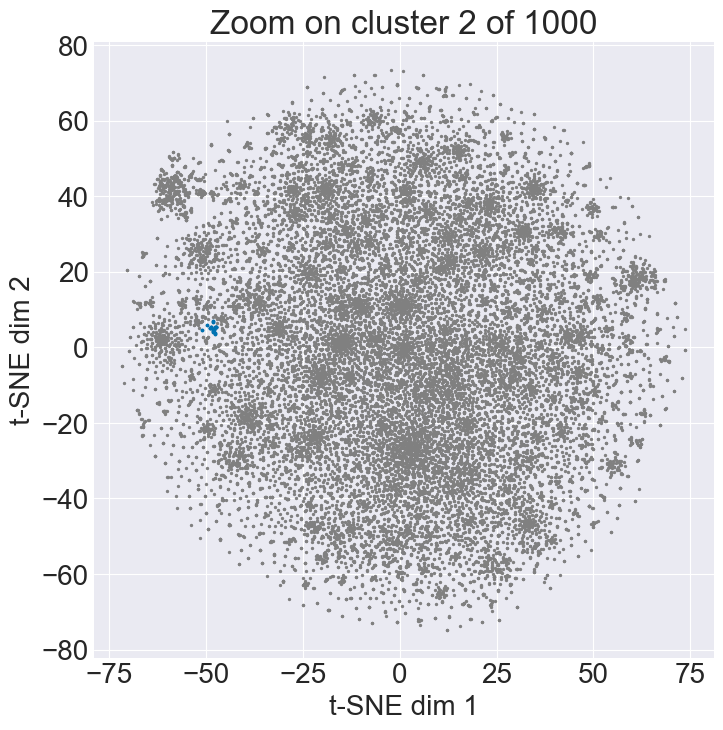

Cluster 2 (20 words):
aviator, b08f7qq11t, sonja, rofarso, betro, boston, theater, danne, panvbo, crndzsis, outweighed, vesta, jolin, ourin, b004r05p3q, cocoship, b01beay0nc, jj, quib, gtr …


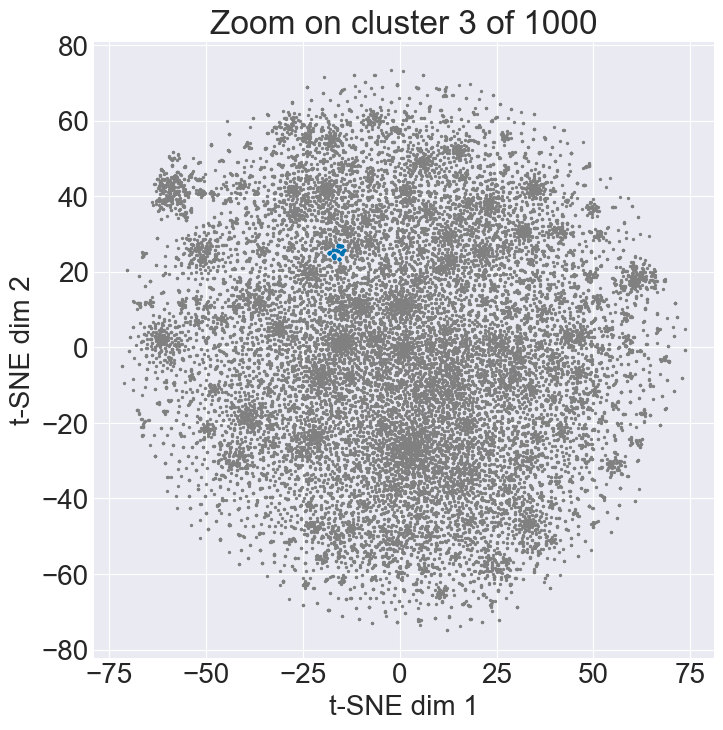

Cluster 3 (32 words):
arthritis, longsleeve, mommy, irritated, settings, monroe, rounding, camouflages, noses, tum, itches, blind, bypass, c5, c6, osteoarthritis, dew, frome, cranny, inflamed, mummy, frm, panning, ultramodern, mjs, oysters, snatches, cuddles, flattens, frantic, cubicle, cheast …


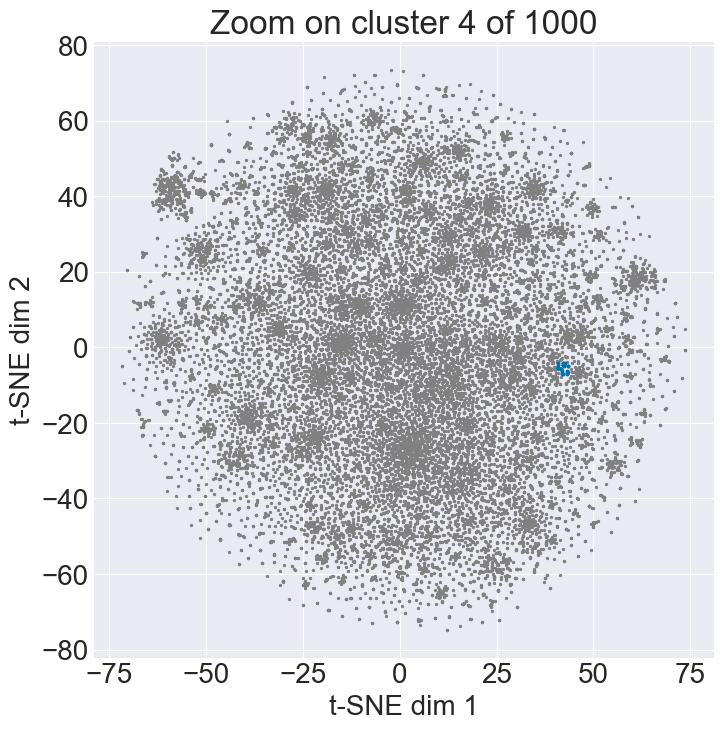

Cluster 4 (31 words):
investigating, eddie, bauer, counterfeit, thirds, pollen, schnauzer, standardized, overbearingly, strudy, witty, scrawny, viruses, goog, quiality, lou, exhaled, vhina, moss, agate, duffy, tt, marpat, topological, lured, shadowy, iridium, upis, clostrophobic, sixing, yahtzee …


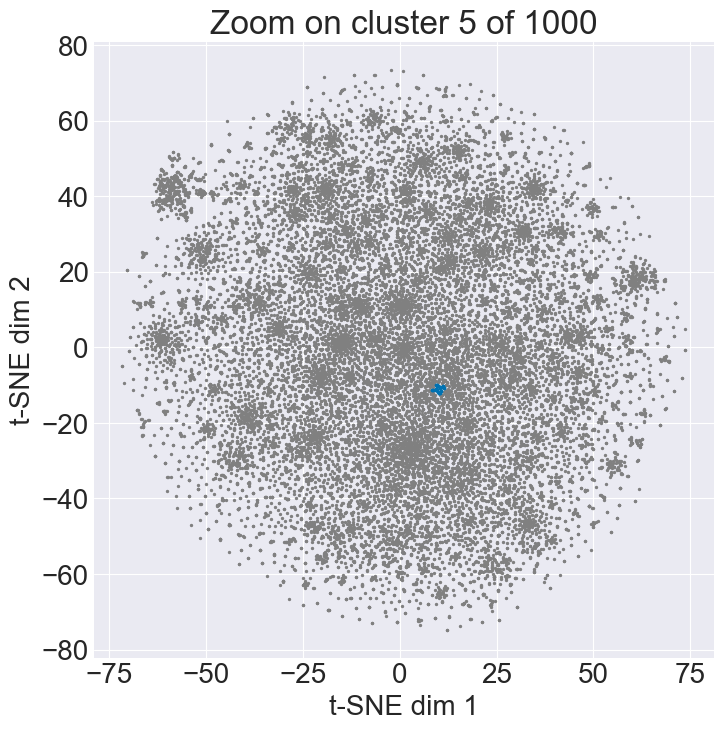

Cluster 5 (21 words):
sleeves, ends, center, slit, trim, edge, sleeve, thingy, end, hem, gaps, seam, knob, cuffs, ribbing, ruffles, vertical, knobs, hemline, remote, earing …


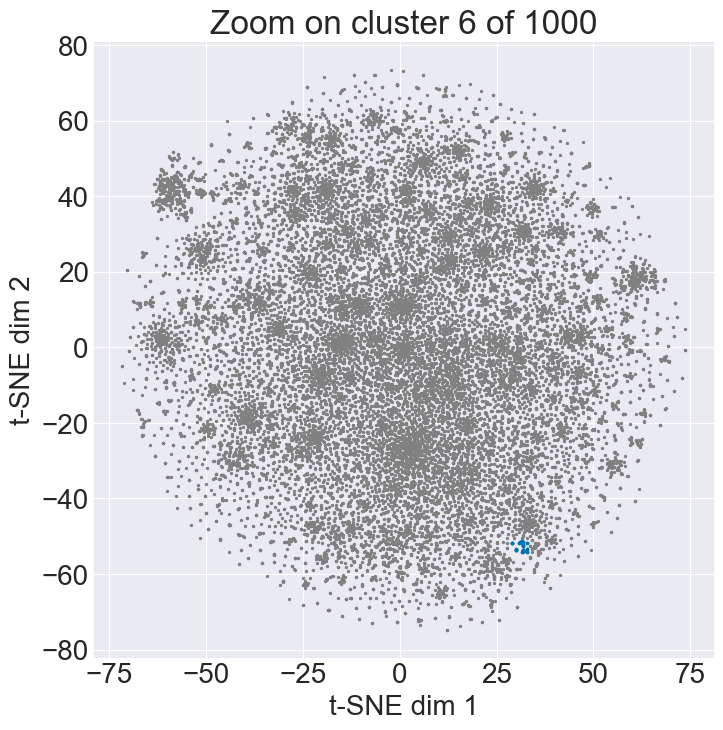

Cluster 6 (23 words):
diminished, warned, collapse, mistreated, realizing, stee, aways, earskins, prematurely, concealment, doable, forewarned, filhy, shamrocks, sham, billow, appalled, godey, tayupey, wearables, agile, medusa, nicety …


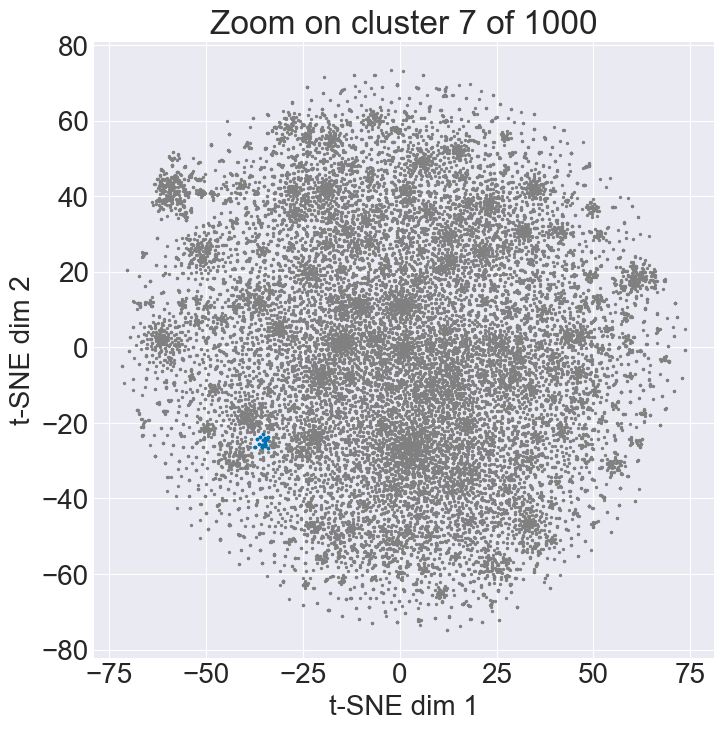

Cluster 7 (22 words):
blood, vented, galoshes, national, labeling, peppa, pig, unsafe, knits, poem, fingerless, but6, wesson, colors', unfavorable, flipflops, soojun, royce, bl, protreks, gsocks, venders …


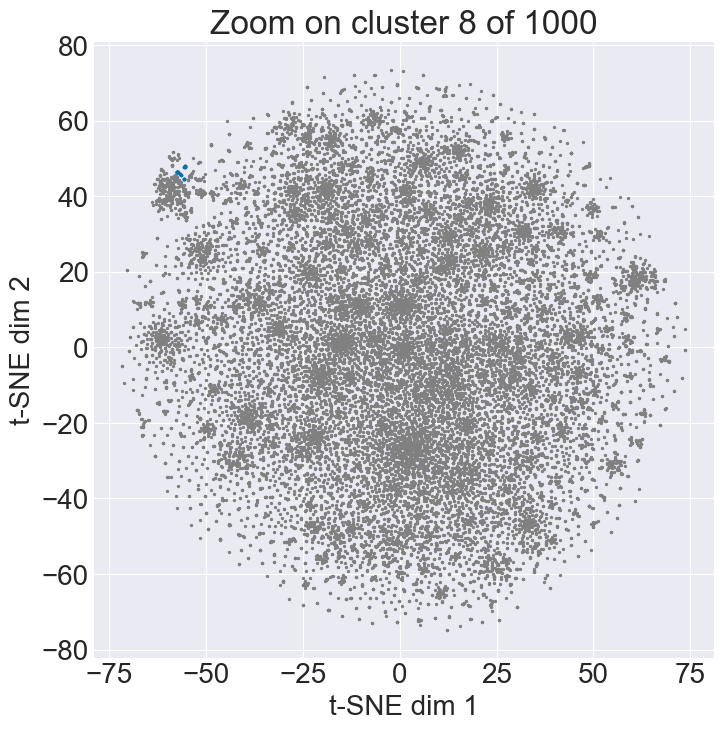

Cluster 8 (13 words):
est, jaune, et, elle, grueso, cuero, sería, mejor, aun, cuando, tenga, cuidado, respectivo …


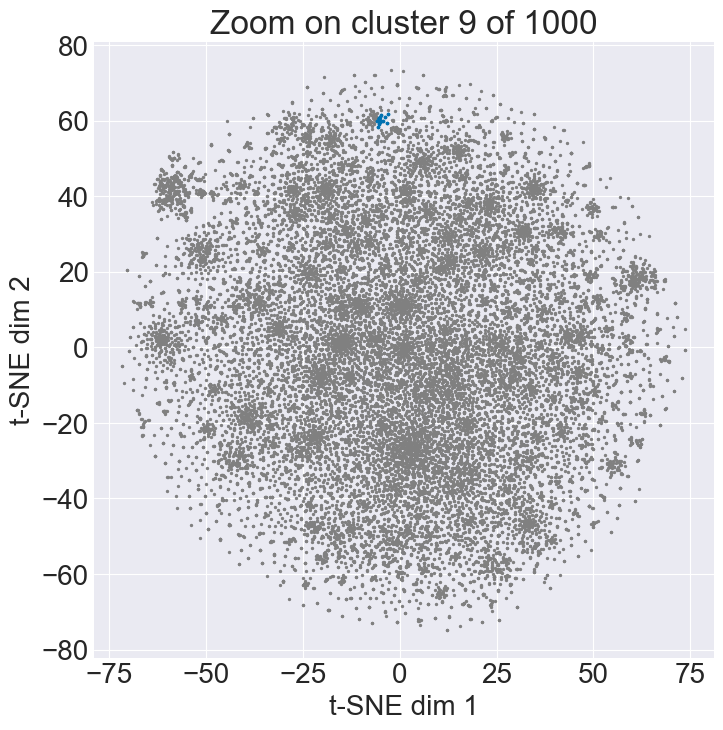

Cluster 9 (20 words):
corn, grade, maid, steampunk, masquerade, fetish, cosume, witch, roaring, macaw, 70s, poppins, holloween, pixy, pumpkins, detective, sabrina, spellman, poison, ivy …


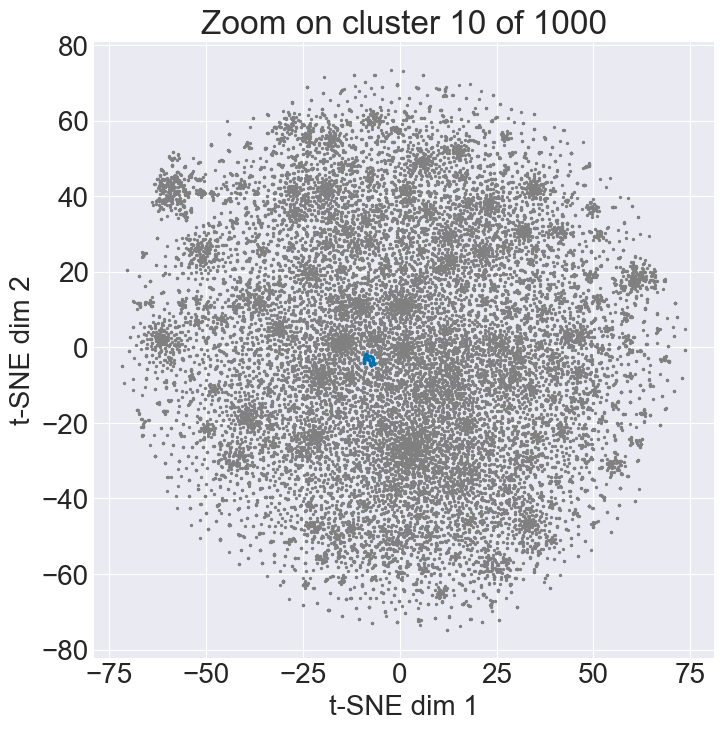

Cluster 10 (33 words):
slipage, importance, balanced, pecular, honey, counter, slogan, farpoint, emphasizing, venue, controlled, opticians, bridges, cheapness, golly, implied, sebum, quickness, lisa, producted, logic, drizzled, sponsored, wal, arthur, usps, worsen, millers, infared, ispy, weightand, misprint, bludgeoned …


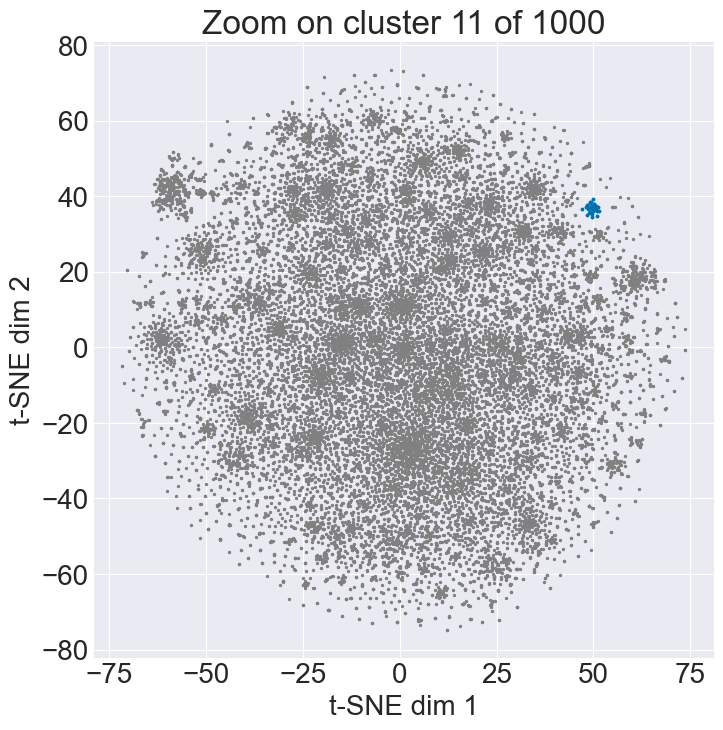

Cluster 11 (43 words):
resists, sugar, fury, cabernet, d0b652e0ad0408cf63e82092493185d5, whasnt, lightweirght, guitar, nicelyoveraall, tig, lively, motivational, sweather, lodge, hankies, operall, uncomplicated, ithe, thickish, whoch, verryyyyyyyyyy, verrrrrrry, errr, brokedown, remarked, demin, lorgnette, medicine, fbric, flowly, weld, giftbox, rendition, surpringly, innorder, loo, shaw, fleeced, rugby, kurti, hawaian, handwritten, mangalsutra …


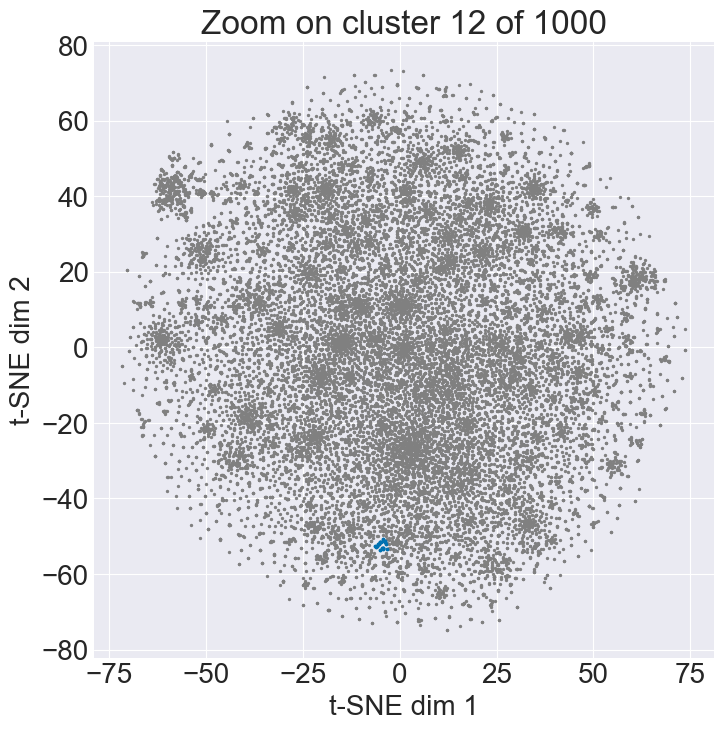

Cluster 12 (20 words):
unsure, x1, unnecessarily, bail, speechless, wake, receiveed, retiring, tripped, morels, electrochemistry, breastfed, rumpled, sic, hunching, blousey, hosted, ritzy, abandoned, lululemons …


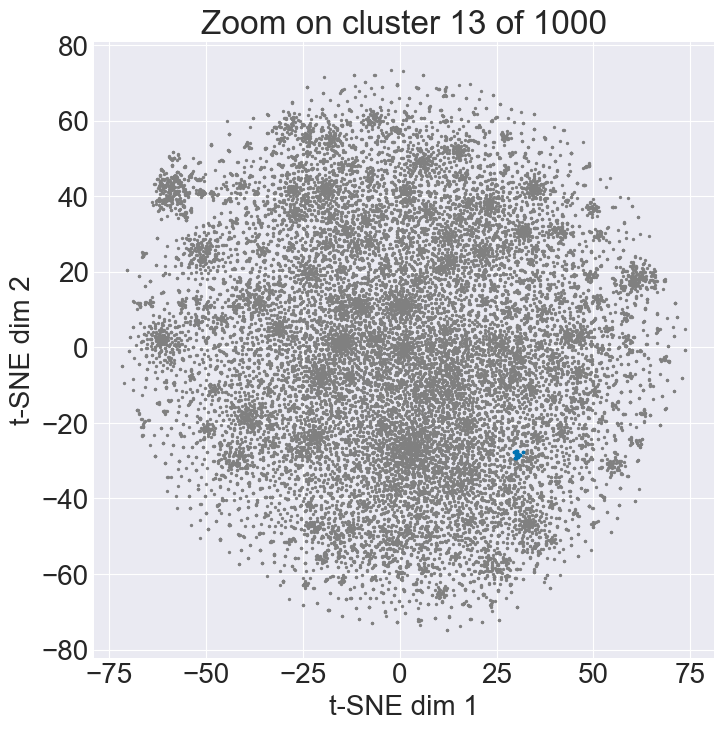

Cluster 13 (16 words):
spelled, boom, sorted, thinning, publicly, afterward, rinsing, blacked, feathered, straightened, seeks, shakes, vigorously, unclick, moyra, crapped …


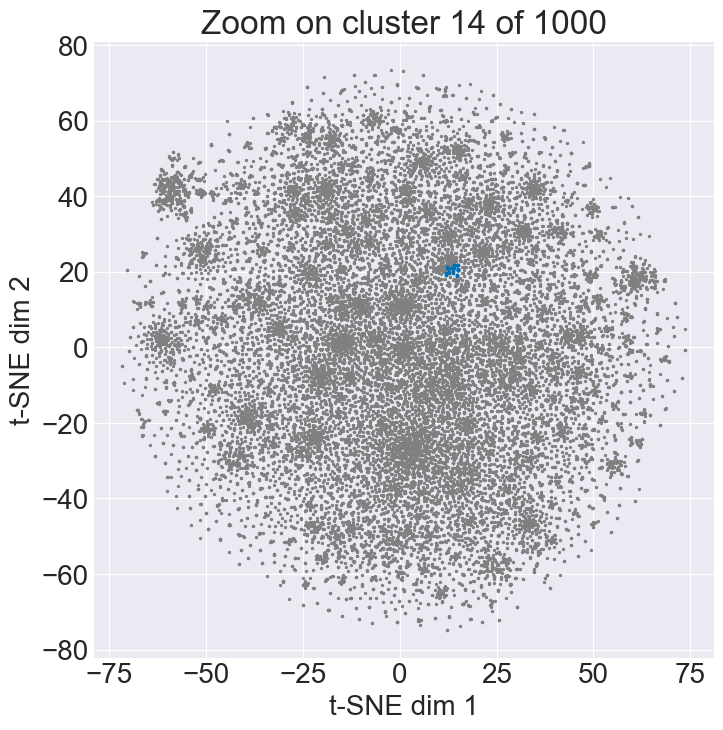

Cluster 14 (24 words):
and1, selection, load, total, waffle, failure, sweatpant, teaspoon, sateen, stye, luxe, anatomy, thinnish, accomodate, raange, injury, crow, diagonal, fjallraven, crackers, gallon, breif, derek, symptom …


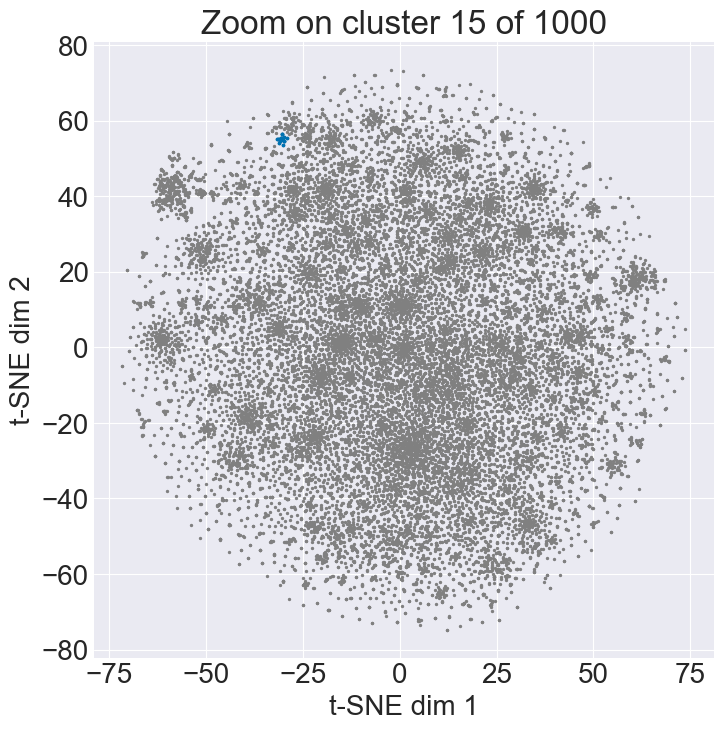

Cluster 15 (17 words):
unsteady, hebrew, autistic, london, 11yo, fashionista, wheres, goddaughter, dances, 65lbs, bestie, dieting, burt, macklin, blond, possesses, kansas …


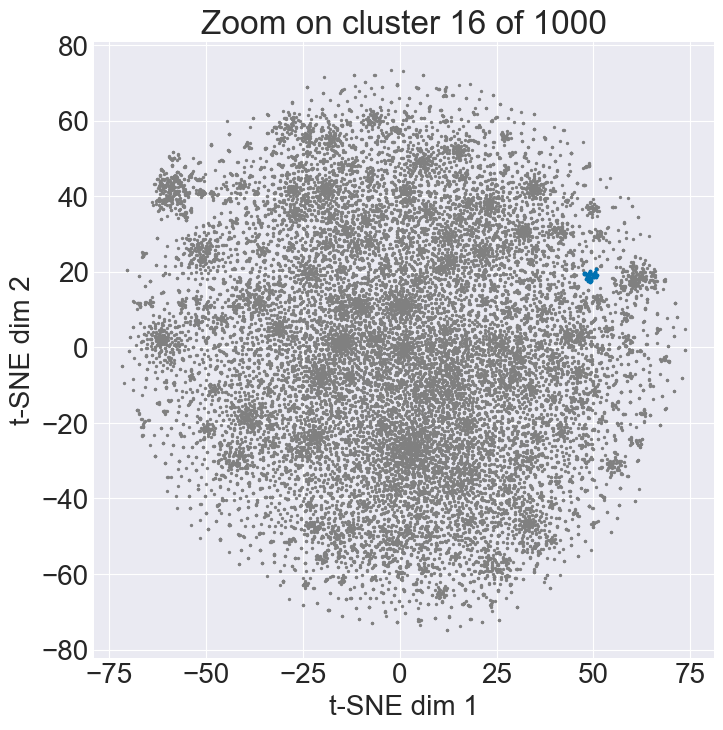

Cluster 16 (33 words):
unattractive, disheveled, childish, plasticky, 3rdparty, disingenuous, unrealistic, tacky, paste, shoddy, shabby, haphazard, chincy, grossly, plasticy, junky, smelly, guady, rhe, lackluster, shotty, beater, cheesey, unflattered, funkily, chinsy, remake, retarded, chessey, freebie, booooooooo, uncomforable, reproduction …


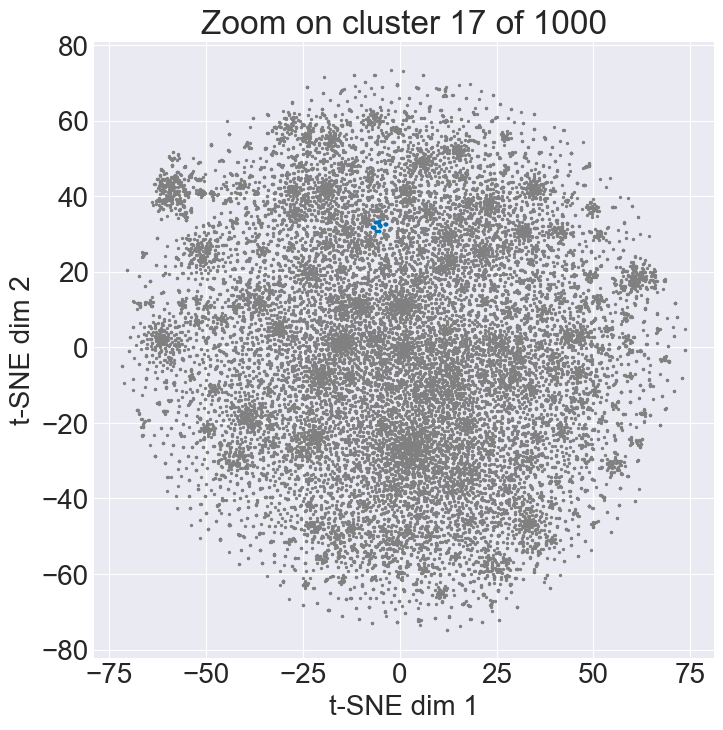

Cluster 17 (17 words):
navel, drawers, schedule, smiley, wishlist, mo, footed, shackles, mysterious, hong, balence, goatee, invite, squirtles, bezzled, channels, knews …


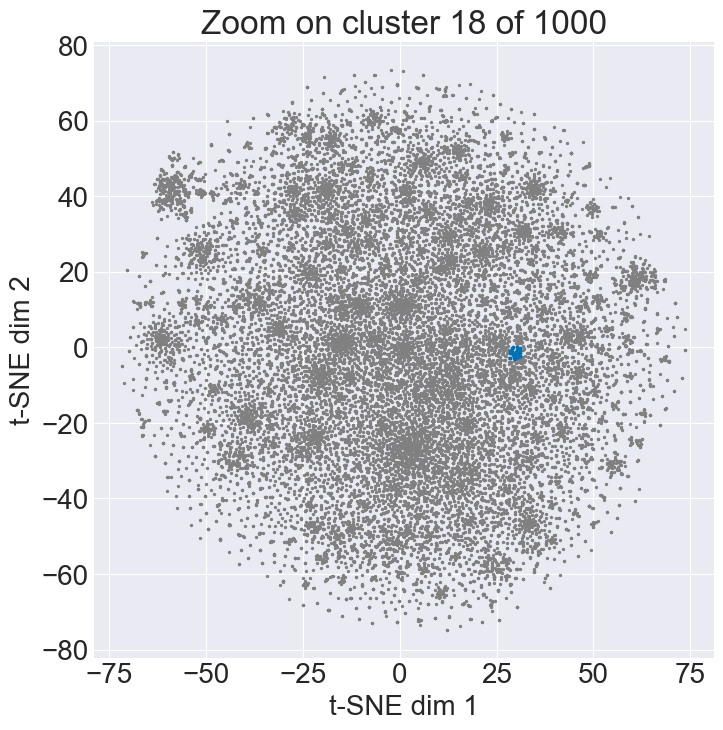

Cluster 18 (32 words):
knit, light, soft, fleece, lightweight, fleecy, smooth, bouncy, breathable, stretchy, lined, unlined, silky, plush, binding, wicking, neutral, waterproof, stretchable, ribbed, cozy, moisture, crew, windproof, moist, harsh, lite, breathes, satiny, cottony, buttt, doubleknit …


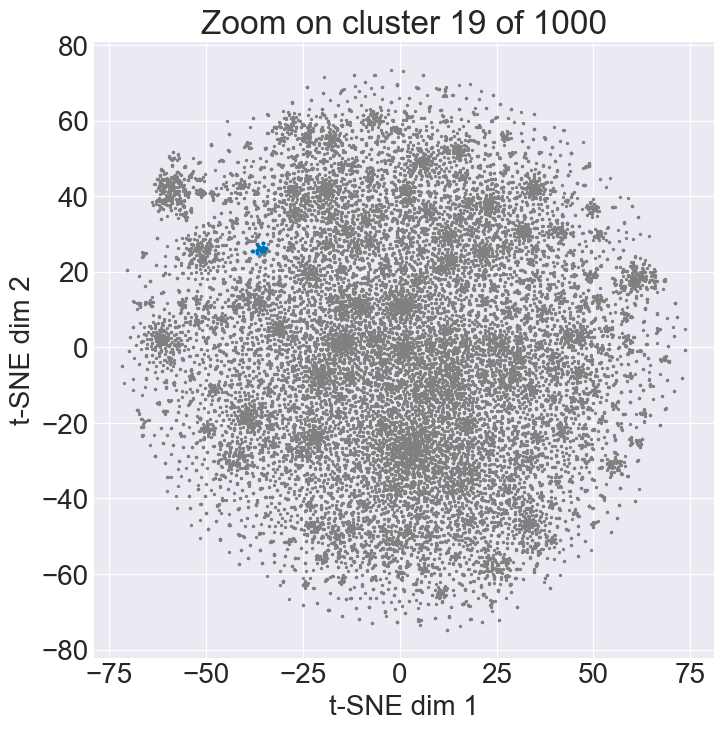

Cluster 19 (23 words):
rei, meghan, markle, survival, cbs, shipwrecked, cataracts, mentor, penneys, nibbling, appt, clinic, intrigues, resorts, brattahlíð, anthropologie, minneapolis, kee, iv0e, maurices, sights, walgreens, churchill …


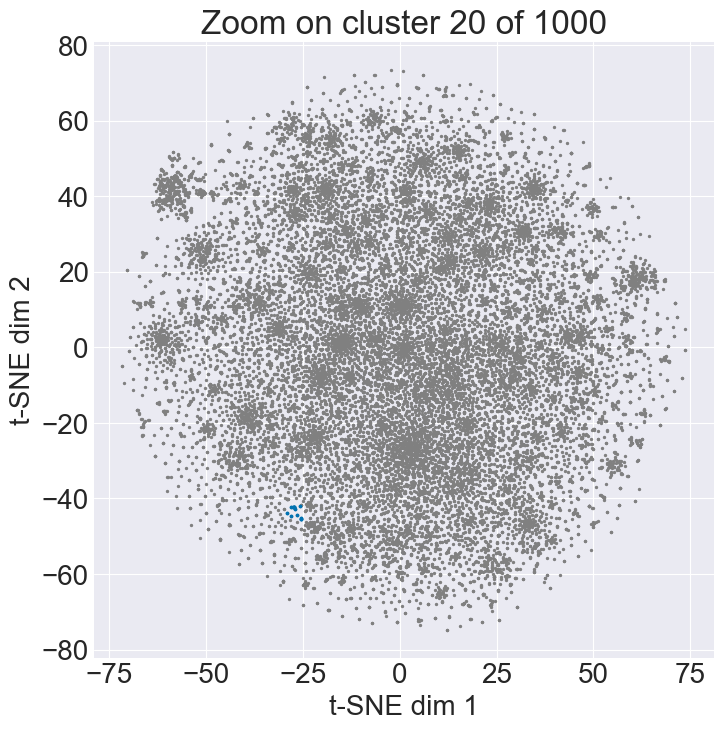

Cluster 20 (13 words):
minimum, statistics, kitties, occurs, epic, animals, 4a95b9fc4789fb40771178f296c15cee, claddagh, cartier, carbiners, grwat, unworkable, pinsanity …


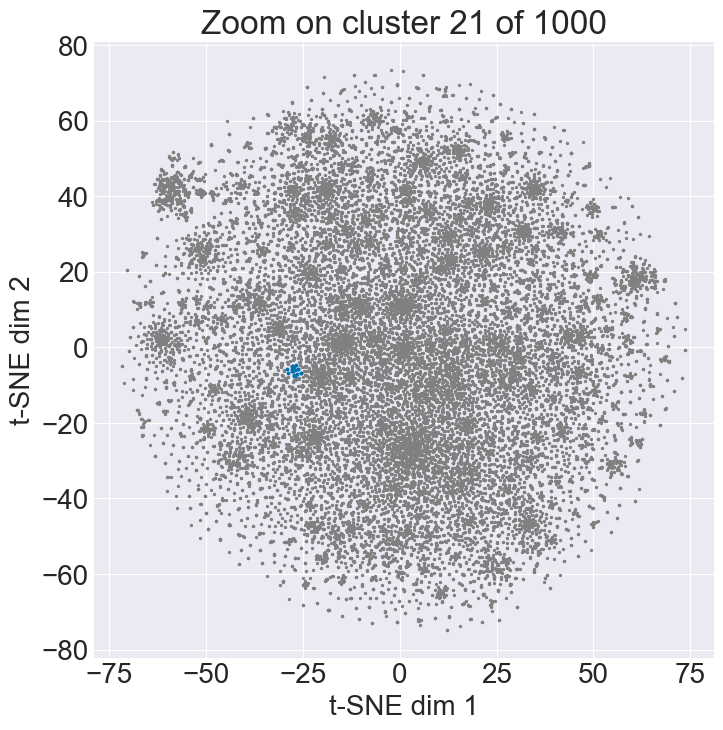

Cluster 21 (23 words):
verified, muck, rode, 'this, tri, underwwear, dorina, 6xl, smalls, braces, unbuttoning, 'ice, fang', bolles, cintas, 7t, 4way, nautica, conference, ml, copi, whoishe, 42c …


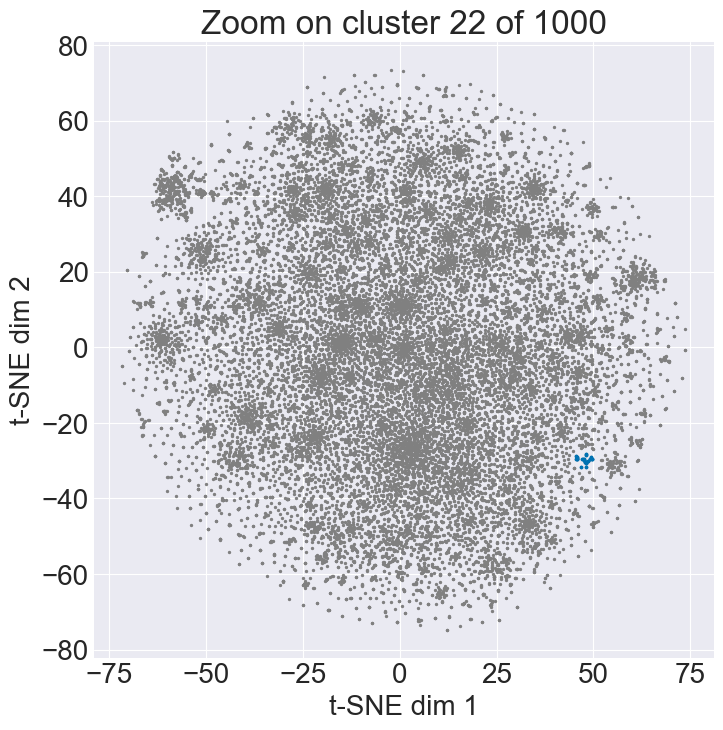

Cluster 22 (26 words):
begin, suffocated, sloped, comefortable, lied, snugg, yummy, timid, ant, clash, obliged, plains, overdressed, smoothies, driven, irriate, duped, anyomre, birk, cufe, 'exposed, 'closed', eerie, webs, underdressed, chokey …


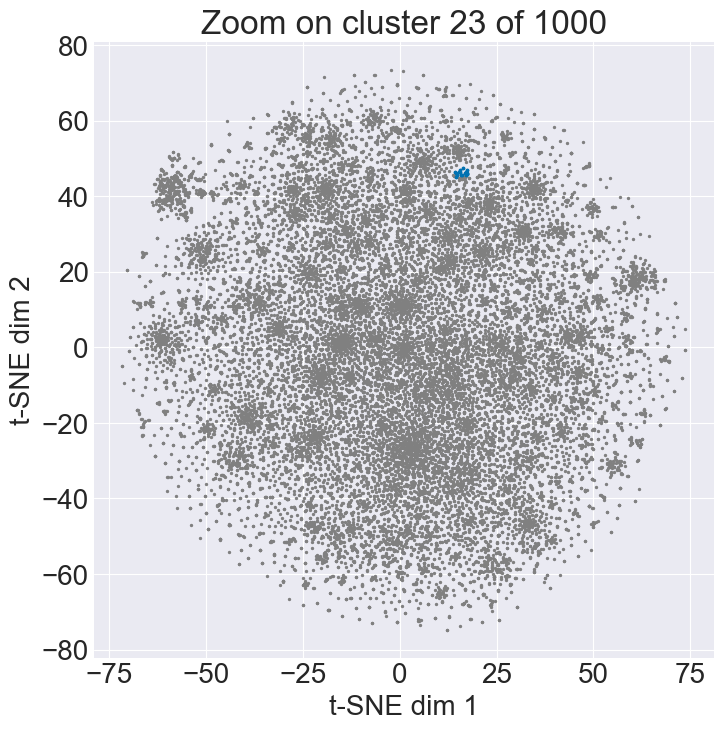

Cluster 23 (18 words):
or5, 10w, 11w, reg, male, voluptuous, 18w, chick, childs, hppy, leprechaun, rockabilly, 8t, cutern, overestimated, 'medium', 40r, rder …


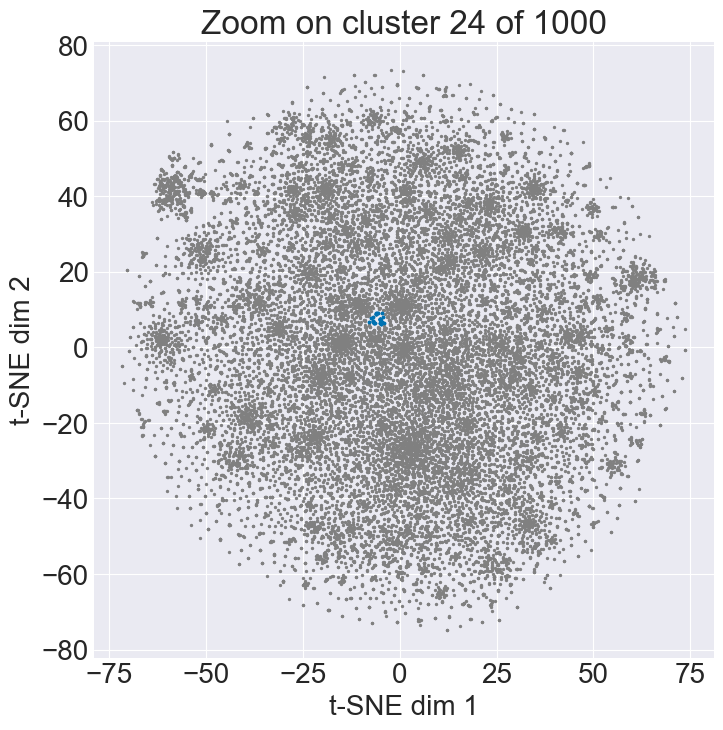

Cluster 24 (31 words):
pit, everyday, business, daily, frequent, circle, weekend, dove, yonkers, 50x, parcel, embedded, hunting, wetland, picket, isolated, booby, nipped, sailing, inscription, ecru, tugs, assembling, indicating, 29th, unwrapping, ancient, sagged, wintery, shinning, whisk …


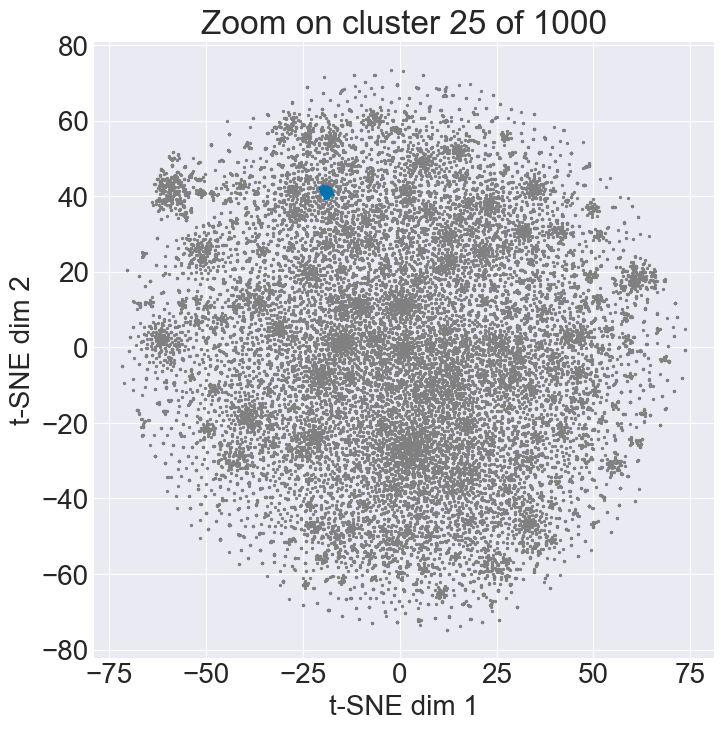

Cluster 25 (49 words):
liking, grandkkids, husbands, visa, cussing, requirements, joycons, surfing, witchy, observations, bible, dc, twins, subway, paperwork, exacerbate, wining, exchnage, fiances, carpel, quest, bicycle, fins, 7yo, unqualified, dil, insulin, genderswapped, autograph, voice, restless, 'minus', prying, bb, adams, gmc, commerative, 41st, appointments, husand, pajams, cabillitos, preschoolers, stepmom, hig, m4, plowing, bid, mantra …


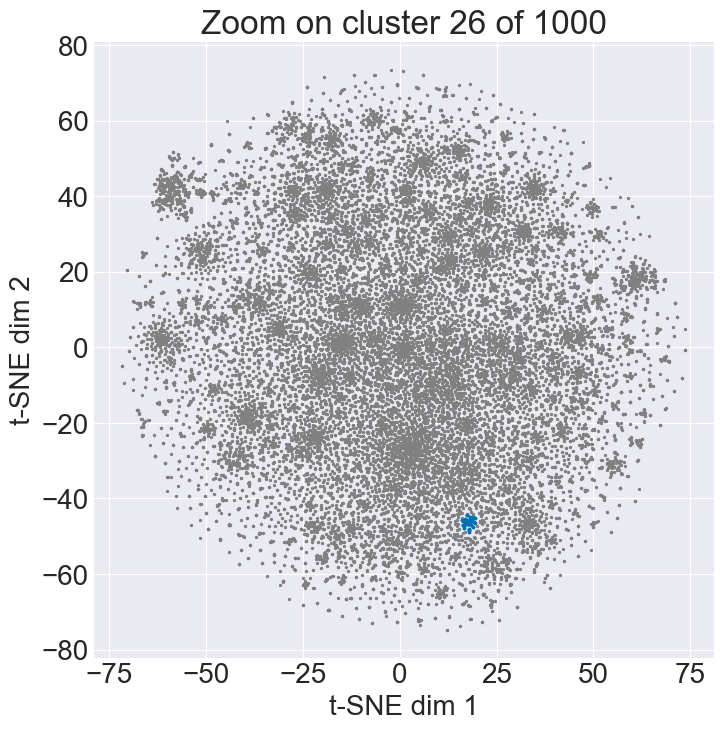

Cluster 26 (37 words):
worry, desided, shave, convince, fiddle, refer, failed, clouds, settled, services, forgetting, resilient, unfold, continued, attempted, resell, amounted, readjust, nickle, preferredpdded, hicks, resync, contend, redo, ent, cleanse, contributed, latching, dump, praises, mattered, douse, subjected, velco, definelty, reacting, retie …


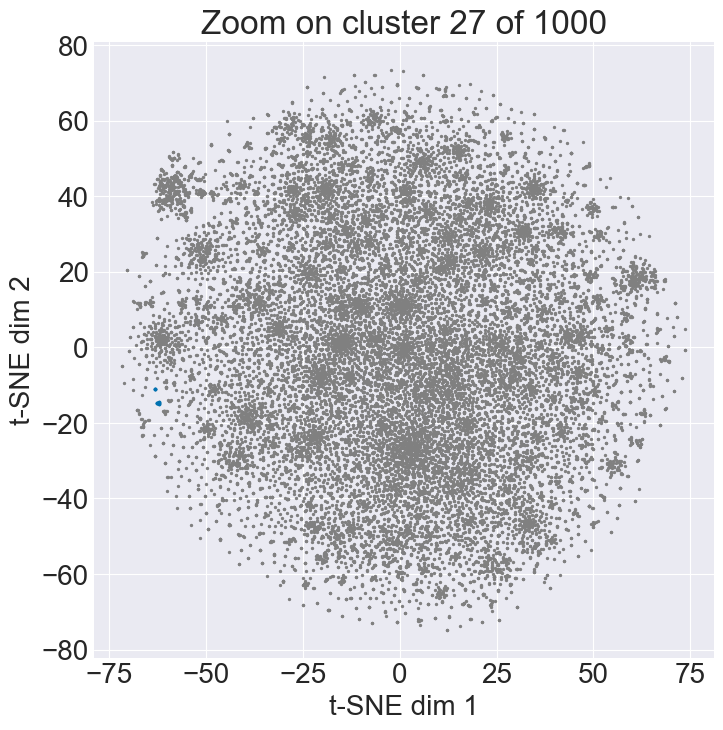

Cluster 27 (8 words):
lovers, relayed, wars, nerd, collosal, nerds, iconic, films …


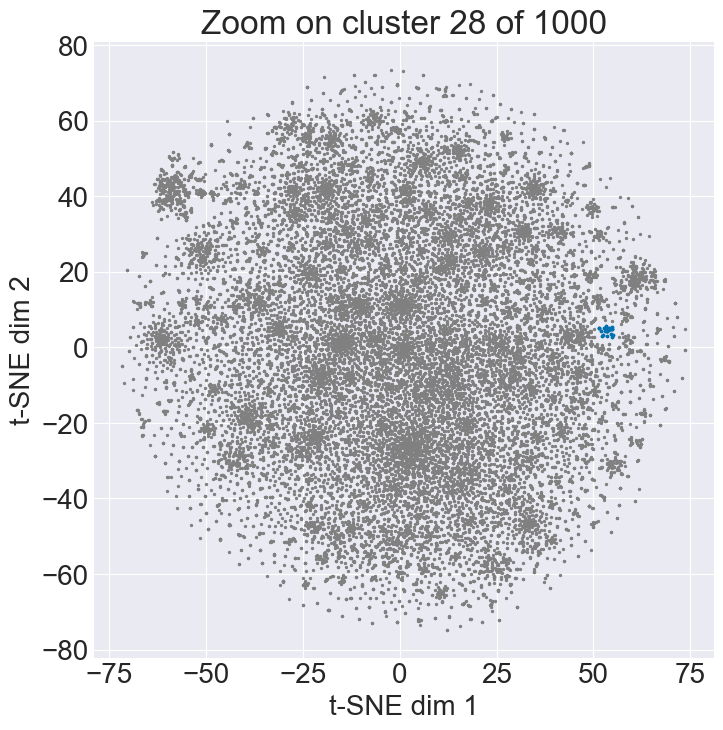

Cluster 28 (31 words):
flowey, constrictive, a93d50894f54e62fbf43768898f42b8f, criminally, elsa, frail, winered, absorbency, verry, deliciously, stlish, insertion, fees, intelligently, ftts, visualization, absorbant, conspicuous, ahhhhmazingly, springy, controllable, moat, critters, everr, 6a9f565b18700d32dbb4799525a2d9cb, slops, staps, subjectively, lightweght, beuaitiful, answering …


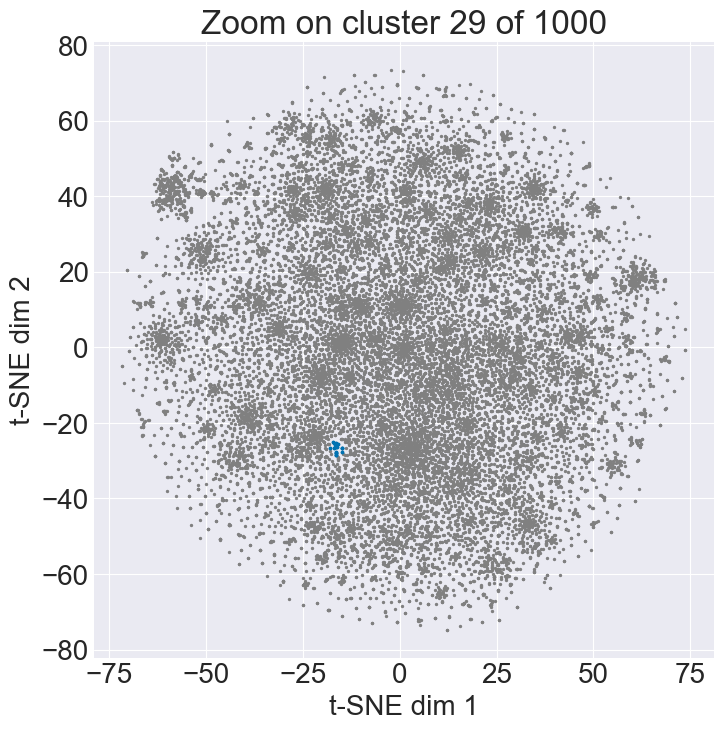

Cluster 29 (21 words):
shielding, vary, aggravate, swims, beak, detract, culture, muahaha, iv, scissor, import, waiver, spout, greatgranddaughter, mower, hulk, scams, persnickety, kills, morevoer, browser …


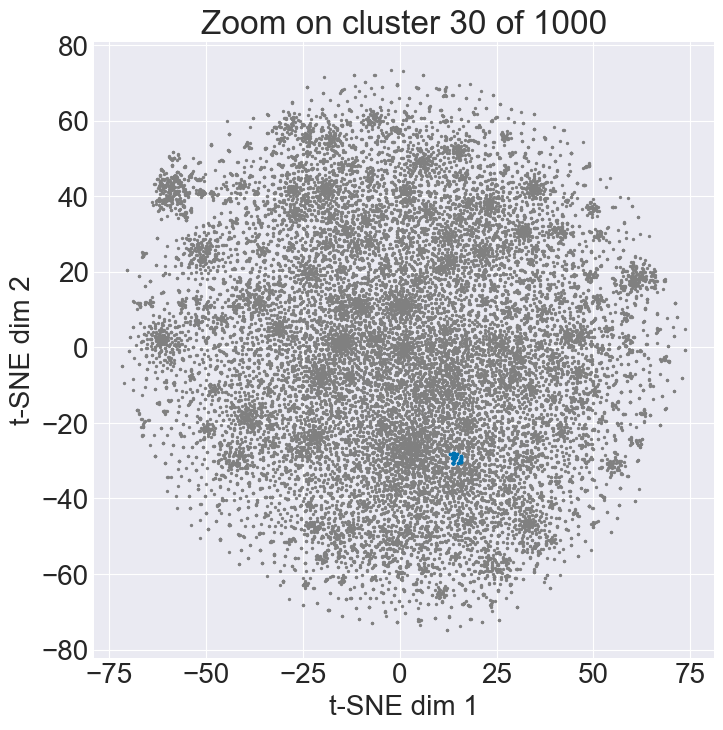

Cluster 30 (30 words):
stay, showed, showing, keep, prevent, shows, show, compliment, matched, stays, match, protects, keeps, save, stayed, hug, protect, kept, sheds, shrinks, mark, block, define, brighten, reveal, exist, blocks, complement, hugged, relieve …


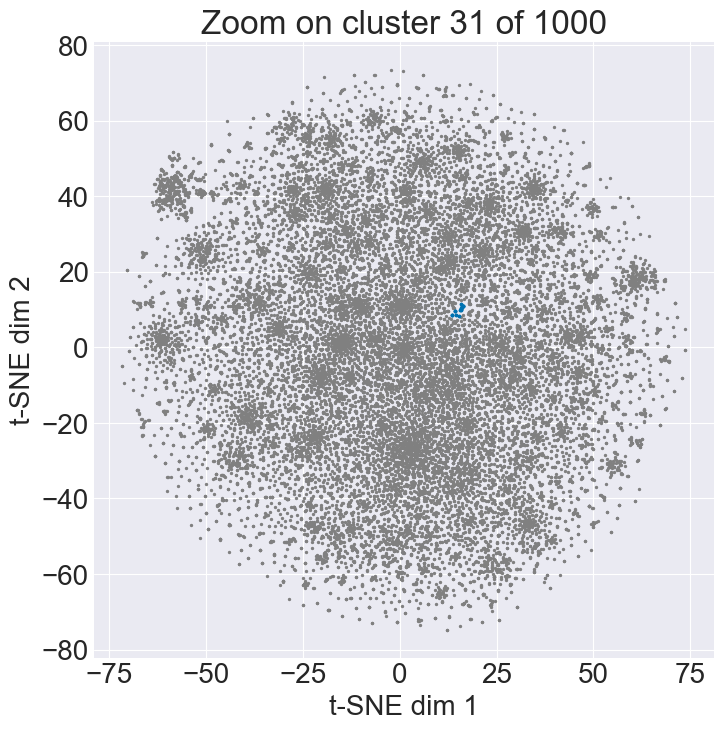

Cluster 31 (17 words):
phony, chovura, steamer, artwork, disastrous, patio, havanna, toggle, panfish, hogs, lacew, surger, 'air, force', dimples, voids, flown …


In [63]:
for i in range (30):
    cluster_search = 2 + i

    # mask for points in that cluster
    mask = (labels == cluster_search)
    pts_all = word_tsne
    pts_cluster = word_tsne[mask]

    # compute bounding box of the cluster
    min_x, min_y = pts_cluster.min(axis=0)
    max_x, max_y = pts_cluster.max(axis=0)

    # add a little padding (5% of width/height)
    pad_x = (max_x - min_x) 
    pad_y = (max_y - min_y)

    xlim = (min_x - pad_x, max_x + pad_x)
    ylim = (min_y - pad_y, max_y + pad_y)

    # plot
    plt.figure(figsize=(8, 8))

    # 1) all points in light gray
    plt.scatter(pts_all[:, 0], pts_all[:, 1],
                c='gray', s=2, label='other clusters')

    # 2) this cluster in blue
    plt.scatter(pts_cluster[:, 0], pts_cluster[:, 1],
                c='C0', s=3, label=f'cluster {cluster_search}')

    # set limits to zoom
    # plt.xlim(*xlim)
    # plt.ylim(*ylim)

    plt.title(f'Zoom on cluster {cluster_search} of {k}')
    plt.xlabel('t-SNE dim 1')
    plt.ylabel('t-SNE dim 2')
    # plt.legend(markerscale=3)
    plt.show()

    # optional: print out the words in this cluster
    words_in_cluster = [ind2word[i] for i in np.where(mask)[0]]
    print(f"Cluster {cluster_search} ({len(words_in_cluster)} words):")
    print(", ".join(words_in_cluster[:50]), "…")
